In [1]:
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:90% !important; }</style>"))
import matplotlib.pyplot as plt
import numpy as np
ppath = "/Users/glengyel/Library/Mobile Documents/com~apple~CloudDocs/Projects/Neural_link_of_CI/neural_link/results/"
import os
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.colors import ListedColormap

import h5py

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
from scipy.stats import entropy
from scipy.stats import zscore
from sklearn.cluster import KMeans
from scipy.spatial.distance import cdist
#from scipy.cluster.hierarchy import dendrogram, linkage
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
import random
from skimage.transform import resize

clist = []
for cname in ["winter", "spring"]:
    c = cm.get_cmap(cname, 100)
    clist.append(ListedColormap(c(np.linspace(0, 1, 10))))

p = os.getcwd()
Pth = os.path.dirname(p)
FigPath= "/plots/"
saveFigPath = Pth+FigPath

FigParams = {
    "fig_size": 6,
    "font1": {"fontname": "Arial", "size": 32},
    "font2": {"fontname": "Arial", "size": 36},
    "line_w": 2,
    "colors_maps": clist,
    "colors_names": ["royalblue", "olivedrab", "darkorange", "firebrick"],
    "saveFigPath": saveFigPath,
    "ErrorBar": {'ErrDist':[0.4,0.4],
                 'ErrSize':1,
                 'ErrWid':4,
                 'sizedots':10,
                 'ErrColor':["royalblue", "olivedrab", "darkorange", "firebrick"],
                 'DotsColor':["royalblue", "olivedrab", "darkorange", "firebrick"],
                 'sizeMean':25},
}


def packParams():
    return (FigParams["fig_size"],
            FigParams["font1"],
            FigParams["font2"],
            FigParams["line_w"],
            FigParams["colors_maps"],
            FigParams["colors_names"],
            FigParams["saveFigPath"],)

from matplotlib.colors import LinearSegmentedColormap

cm_data = [[0.2422, 0.1504, 0.6603],
[0.2444, 0.1534, 0.6728],
[0.2464, 0.1569, 0.6847],
[0.2484, 0.1607, 0.6961],
[0.2503, 0.1648, 0.7071],
[0.2522, 0.1689, 0.7179],
[0.254, 0.1732, 0.7286],
[0.2558, 0.1773, 0.7393],
[0.2576, 0.1814, 0.7501],
[0.2594, 0.1854, 0.761],
[0.2611, 0.1893, 0.7719],
[0.2628, 0.1932, 0.7828],
[0.2645, 0.1972, 0.7937],
[0.2661, 0.2011, 0.8043],
[0.2676, 0.2052, 0.8148],
[0.2691, 0.2094, 0.8249],
[0.2704, 0.2138, 0.8346],
[0.2717, 0.2184, 0.8439],
[0.2729, 0.2231, 0.8528],
[0.274, 0.228, 0.8612],
[0.2749, 0.233, 0.8692],
[0.2758, 0.2382, 0.8767],
[0.2766, 0.2435, 0.884],
[0.2774, 0.2489, 0.8908],
[0.2781, 0.2543, 0.8973],
[0.2788, 0.2598, 0.9035],
[0.2794, 0.2653, 0.9094],
[0.2798, 0.2708, 0.915],
[0.2802, 0.2764, 0.9204],
[0.2806, 0.2819, 0.9255],
[0.2809, 0.2875, 0.9305],
[0.2811, 0.293, 0.9352],
[0.2813, 0.2985, 0.9397],
[0.2814, 0.304, 0.9441],
[0.2814, 0.3095, 0.9483],
[0.2813, 0.315, 0.9524],
[0.2811, 0.3204, 0.9563],
[0.2809, 0.3259, 0.96],
[0.2807, 0.3313, 0.9636],
[0.2803, 0.3367, 0.967],
[0.2798, 0.3421, 0.9702],
[0.2791, 0.3475, 0.9733],
[0.2784, 0.3529, 0.9763],
[0.2776, 0.3583, 0.9791],
[0.2766, 0.3638, 0.9817],
[0.2754, 0.3693, 0.984],
[0.2741, 0.3748, 0.9862],
[0.2726, 0.3804, 0.9881],
[0.271, 0.386, 0.9898],
[0.2691, 0.3916, 0.9912],
[0.267, 0.3973, 0.9924],
[0.2647, 0.403, 0.9935],
[0.2621, 0.4088, 0.9946],
[0.2591, 0.4145, 0.9955],
[0.2556, 0.4203, 0.9965],
[0.2517, 0.4261, 0.9974],
[0.2473, 0.4319, 0.9983],
[0.2424, 0.4378, 0.9991],
[0.2369, 0.4437, 0.9996],
[0.2311, 0.4497, 0.9995],
[0.225, 0.4559, 0.9985],
[0.2189, 0.462, 0.9968],
[0.2128, 0.4682, 0.9948],
[0.2066, 0.4743, 0.9926],
[0.2006, 0.4803, 0.9906],
[0.195, 0.4861, 0.9887],
[0.1903, 0.4919, 0.9867],
[0.1869, 0.4975, 0.9844],
[0.1847, 0.503, 0.9819],
[0.1831, 0.5084, 0.9793],
[0.1818, 0.5138, 0.9766],
[0.1806, 0.5191, 0.9738],
[0.1795, 0.5244, 0.9709],
[0.1785, 0.5296, 0.9677],
[0.1778, 0.5349, 0.9641],
[0.1773, 0.5401, 0.9602],
[0.1768, 0.5452, 0.956],
[0.1764, 0.5504, 0.9516],
[0.1755, 0.5554, 0.9473],
[0.174, 0.5605, 0.9432],
[0.1716, 0.5655, 0.9393],
[0.1686, 0.5705, 0.9357],
[0.1649, 0.5755, 0.9323],
[0.161, 0.5805, 0.9289],
[0.1573, 0.5854, 0.9254],
[0.154, 0.5902, 0.9218],
[0.1513, 0.595, 0.9182],
[0.1492, 0.5997, 0.9147],
[0.1475, 0.6043, 0.9113],
[0.1461, 0.6089, 0.908],
[0.1446, 0.6135, 0.905],
[0.1429, 0.618, 0.9022],
[0.1408, 0.6226, 0.8998],
[0.1383, 0.6272, 0.8975],
[0.1354, 0.6317, 0.8953],
[0.1321, 0.6363, 0.8932],
[0.1288, 0.6408, 0.891],
[0.1253, 0.6453, 0.8887],
[0.1219, 0.6497, 0.8862],
[0.1185, 0.6541, 0.8834],
[0.1152, 0.6584, 0.8804],
[0.1119, 0.6627, 0.877],
[0.1085, 0.6669, 0.8734],
[0.1048, 0.671, 0.8695],
[0.1009, 0.675, 0.8653],
[0.0964, 0.6789, 0.8609],
[0.0914, 0.6828, 0.8562],
[0.0855, 0.6865, 0.8513],
[0.0789, 0.6902, 0.8462],
[0.0713, 0.6938, 0.8409],
[0.0628, 0.6972, 0.8355],
[0.0535, 0.7006, 0.8299],
[0.0433, 0.7039, 0.8242],
[0.0328, 0.7071, 0.8183],
[0.0234, 0.7103, 0.8124],
[0.0155, 0.7133, 0.8064],
[0.0091, 0.7163, 0.8003],
[0.0046, 0.7192, 0.7941],
[0.0019, 0.722, 0.7878],
[0.0009, 0.7248, 0.7815],
[0.0018, 0.7275, 0.7752],
[0.0046, 0.7301, 0.7688],
[0.0094, 0.7327, 0.7623],
[0.0162, 0.7352, 0.7558],
[0.0253, 0.7376, 0.7492],
[0.0369, 0.74, 0.7426],
[0.0504, 0.7423, 0.7359],
[0.0638, 0.7446, 0.7292],
[0.077, 0.7468, 0.7224],
[0.0899, 0.7489, 0.7156],
[0.1023, 0.751, 0.7088],
[0.1141, 0.7531, 0.7019],
[0.1252, 0.7552, 0.695],
[0.1354, 0.7572, 0.6881],
[0.1448, 0.7593, 0.6812],
[0.1532, 0.7614, 0.6741],
[0.1609, 0.7635, 0.6671],
[0.1678, 0.7656, 0.6599],
[0.1741, 0.7678, 0.6527],
[0.1799, 0.7699, 0.6454],
[0.1853, 0.7721, 0.6379],
[0.1905, 0.7743, 0.6303],
[0.1954, 0.7765, 0.6225],
[0.2003, 0.7787, 0.6146],
[0.2061, 0.7808, 0.6065],
[0.2118, 0.7828, 0.5983],
[0.2178, 0.7849, 0.5899],
[0.2244, 0.7869, 0.5813],
[0.2318, 0.7887, 0.5725],
[0.2401, 0.7905, 0.5636],
[0.2491, 0.7922, 0.5546],
[0.2589, 0.7937, 0.5454],
[0.2695, 0.7951, 0.536],
[0.2809, 0.7964, 0.5266],
[0.2929, 0.7975, 0.517],
[0.3052, 0.7985, 0.5074],
[0.3176, 0.7994, 0.4975],
[0.3301, 0.8002, 0.4876],
[0.3424, 0.8009, 0.4774],
[0.3548, 0.8016, 0.4669],
[0.3671, 0.8021, 0.4563],
[0.3795, 0.8026, 0.4454],
[0.3921, 0.8029, 0.4344],
[0.405, 0.8031, 0.4233],
[0.4184, 0.803, 0.4122],
[0.4322, 0.8028, 0.4013],
[0.4463, 0.8024, 0.3904],
[0.4608, 0.8018, 0.3797],
[0.4753, 0.8011, 0.3691],
[0.4899, 0.8002, 0.3586],
[0.5044, 0.7993, 0.348],
[0.5187, 0.7982, 0.3374],
[0.5329, 0.797, 0.3267],
[0.547, 0.7957, 0.3159],
[0.5609, 0.7943, 0.305],
[0.5748, 0.7929, 0.2941],
[0.5886, 0.7913, 0.2833],
[0.6024, 0.7896, 0.2726],
[0.6161, 0.7878, 0.2622],
[0.6297, 0.7859, 0.2521],
[0.6433, 0.7839, 0.2423],
[0.6567, 0.7818, 0.2329],
[0.6701, 0.7796, 0.2239],
[0.6833, 0.7773, 0.2155],
[0.6963, 0.775, 0.2075],
[0.7091, 0.7727, 0.1998],
[0.7218, 0.7703, 0.1924],
[0.7344, 0.7679, 0.1852],
[0.7468, 0.7654, 0.1782],
[0.759, 0.7629, 0.1717],
[0.771, 0.7604, 0.1658],
[0.7829, 0.7579, 0.1608],
[0.7945, 0.7554, 0.157],
[0.806, 0.7529, 0.1546],
[0.8172, 0.7505, 0.1535],
[0.8281, 0.7481, 0.1536],
[0.8389, 0.7457, 0.1546],
[0.8495, 0.7435, 0.1564],
[0.86, 0.7413, 0.1587],
[0.8703, 0.7392, 0.1615],
[0.8804, 0.7372, 0.165],
[0.8903, 0.7353, 0.1695],
[0.9, 0.7336, 0.1749],
[0.9093, 0.7321, 0.1815],
[0.9184, 0.7308, 0.189],
[0.9272, 0.7298, 0.1973],
[0.9357, 0.729, 0.2061],
[0.944, 0.7285, 0.2151],
[0.9523, 0.7284, 0.2237],
[0.9606, 0.7285, 0.2312],
[0.9689, 0.7292, 0.2373],
[0.977, 0.7304, 0.2418],
[0.9842, 0.733, 0.2446],
[0.99, 0.7365, 0.2429],
[0.9946, 0.7407, 0.2394],
[0.9966, 0.7458, 0.2351],
[0.9971, 0.7513, 0.2309],
[0.9972, 0.7569, 0.2267],
[0.9971, 0.7626, 0.2224],
[0.9969, 0.7683, 0.2181],
[0.9966, 0.774, 0.2138],
[0.9962, 0.7798, 0.2095],
[0.9957, 0.7856, 0.2053],
[0.9949, 0.7915, 0.2012],
[0.9938, 0.7974, 0.1974],
[0.9923, 0.8034, 0.1939],
[0.9906, 0.8095, 0.1906],
[0.9885, 0.8156, 0.1875],
[0.9861, 0.8218, 0.1846],
[0.9835, 0.828, 0.1817],
[0.9807, 0.8342, 0.1787],
[0.9778, 0.8404, 0.1757],
[0.9748, 0.8467, 0.1726],
[0.972, 0.8529, 0.1695],
[0.9694, 0.8591, 0.1665],
[0.9671, 0.8654, 0.1636],
[0.9651, 0.8716, 0.1608],
[0.9634, 0.8778, 0.1582],
[0.9619, 0.884, 0.1557],
[0.9608, 0.8902, 0.1532],
[0.9601, 0.8963, 0.1507],
[0.9596, 0.9023, 0.148],
[0.9595, 0.9084, 0.145],
[0.9597, 0.9143, 0.1418],
[0.9601, 0.9203, 0.1382],
[0.9608, 0.9262, 0.1344],
[0.9618, 0.932, 0.1304],
[0.9629, 0.9379, 0.1261],
[0.9642, 0.9437, 0.1216],
[0.9657, 0.9494, 0.1168],
[0.9674, 0.9552, 0.1116],
[0.9692, 0.9609, 0.1061],
[0.9711, 0.9667, 0.1001],
[0.973, 0.9724, 0.0938],
[0.9749, 0.9782, 0.0872],
[0.9769, 0.9839, 0.0805]]

parula_map = LinearSegmentedColormap.from_list('parula', cm_data)


In [2]:
figS, f_font1, f_font2, line_w, cm, cn, sp = packParams()

['meanfire']
(61, 61, 5, 5, 100, 9)
(61, 61, 5, 5, 100, 9)
['meanfire']
(61, 61, 5, 5, 200, 9)
(61, 61, 5, 5, 100, 9)
['meanfire']
(91, 91, 5, 5, 2, 5, 9)
(91, 91, 5, 5, 2, 5, 9)


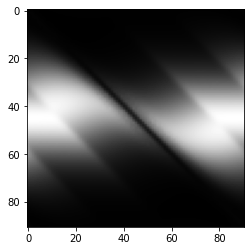

Downsampled shape: (61, 61, 5, 5, 2, 5, 9)


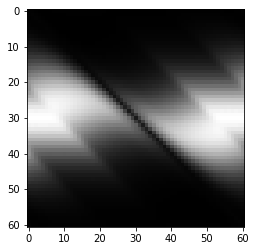

In [3]:
# open the file in read mode
with h5py.File('/Users/glengyel/Projects_data/Neural Predictions/MF_1.mat', 'r') as file:
    # list all the keys in the root group
    print(list(file.keys()))
    # access a dataset
    meanfire1 = file['meanfire']
    print(meanfire1.shape)
    meanfire1 = np.array(meanfire1)
    print(meanfire1.shape)

# open the file in read mode
with h5py.File('/Users/glengyel/Projects_data/Neural Predictions/MF_2.mat', 'r') as file:
    # list all the keys in the root group
    print(list(file.keys()))
    # access a dataset
    meanfire2 = file['meanfire']
    print(meanfire2.shape)
    meanfire2 = np.array(meanfire2)[:,:,:,:,100:,:]
    print(meanfire2.shape)

# open the file in read mode
with h5py.File('/Users/glengyel/Projects_data/Neural Predictions/meanFire.mat', 'r') as file:
    # list all the keys in the root group
    print(list(file.keys()))
    # access a dataset
    meanfire3 = file['meanfire']
    print(meanfire3.shape)
    meanfire3 = np.array(meanfire3)
    print(meanfire3.shape)
plt.imshow(meanfire3[:,:, 2,2,0,1,1], cmap='gray')
plt.show()
# Calculate the target shape
target_shape = (meanfire2.shape[0], meanfire2.shape[1]) + meanfire3.shape[2:]
# Downsample the array to the target shape
meanfire3 = resize(meanfire3, target_shape, mode='reflect', anti_aliasing=True)
print("Downsampled shape:", meanfire3.shape)
plt.imshow(meanfire3[:,:, 2,2,0,1,1], cmap='gray')
plt.show()

In [4]:
210*25*9

47250

In [5]:
textures = np.concatenate((meanfire1.reshape(meanfire1.shape[0], meanfire1.shape[1], -1),
                            meanfire2.reshape(meanfire2.shape[0], meanfire2.shape[1], -1),
                            meanfire3.reshape(meanfire3.shape[0], meanfire3.shape[1], -1)), axis=2)
print(textures.shape)
# for i in range(20):
#     plt.imshow(textures[:,:, i], cmap='gray')
#     plt.show()

(61, 61, 47250)


In [6]:
def morans_i(image):
    # Get the mean of the image
    mean_value = np.mean(image)
    # Calculate deviations from the mean
    deviation = image - mean_value
    # Get the number of rows and columns
    rows, cols = image.shape
    # Define the weight matrix (adjacency: 4-neighborhood)
    w = np.zeros((rows, cols, rows, cols))
    for i in range(rows):
        for j in range(cols):
            if i > 0:  # Up
                w[i, j, i-1, j] = 1
            if i < rows - 1:  # Down
                w[i, j, i+1, j] = 1
            if j > 0:  # Left
                w[i, j, i, j-1] = 1
            if j < cols - 1:  # Right
                w[i, j, i, j+1] = 1

    # Flatten arrays for calculation
    flat_deviation = deviation.flatten()
    flat_w = w.reshape(rows * cols, rows * cols)
    
    # Moran's I numerator
    numerator = np.dot(flat_deviation.T, np.dot(flat_w, flat_deviation))
    # Moran's I denominator
    denominator = np.sum(flat_deviation ** 2)
    # Moran's I calculation
    morans_i_value = (rows * cols / np.sum(flat_w)) * (numerator / denominator)
    
    return morans_i_value

Moran = np.zeros(textures.shape[2])
n_ix = []
for ix in range(textures.shape[2]):
    Moran[ix]= morans_i(textures[:,:,ix])
    if Moran[ix]>0.95:
        n_ix.append(ix)
print(len(Moran))
print(len(n_ix))
print(Moran)
print(n_ix)
# for ix in np.where(np.array(Moran[n_ix])<0.951)[0]:
#     print("Moran's I:", Moran[n_ix[ix]])
#     plt.imshow(textures[:,:,n_ix[ix]], cmap='gray')
#     plt.show()
# for i in range(500):
#     if Moran[i]>0.95:
#         print("Moran's I:", Moran[i])
#         plt.imshow(textures[:,:, i], cmap='gray')
#         plt.show()

47250
18184
[0.25375971 0.25886792 0.25052801 ... 0.98783984 0.99309577 0.98861929]
[9, 10, 11, 12, 13, 14, 15, 16, 17, 45, 46, 47, 48, 49, 50, 51, 52, 53, 58, 72, 73, 74, 75, 76, 77, 78, 79, 80, 90, 91, 92, 93, 94, 95, 96, 97, 98, 144, 145, 146, 147, 148, 149, 150, 151, 152, 183, 186, 187, 193, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 220, 221, 223, 224, 234, 235, 236, 237, 238, 239, 240, 241, 242, 252, 253, 254, 255, 256, 257, 258, 259, 260, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 348, 351, 352, 353, 354, 355, 356, 357, 358, 359, 369, 370, 371, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 392, 393, 394, 395, 396, 397, 398, 400, 401, 403, 404, 414, 415, 416, 417, 418, 419, 420, 421, 422, 423, 424, 425, 426, 427, 428, 429, 430, 431, 432, 433, 434, 435, 436, 437, 438, 439, 440, 441, 442, 443, 444, 445, 446, 447, 448, 449, 450, 451, 452, 453, 454, 455, 456, 457

In [7]:
np.save("Moran_small.npy", Moran)
np.save("n_ix_small.npy", n_ix)

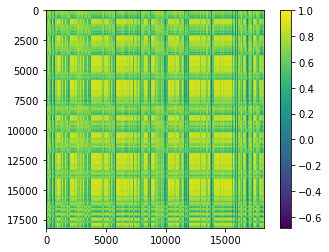

In [8]:
textures = textures[:,:,n_ix]

corr = np.corrcoef(textures.reshape(textures.shape[0]*textures.shape[1], textures.shape[2]).T)

plt.imshow(corr, cmap='viridis')
plt.colorbar()
plt.show()

In [9]:
Moran = Moran[n_ix]
print(len(Moran))
print(Moran)

18184
[0.99294401 0.99775145 0.99286782 ... 0.98783984 0.99309577 0.98861929]


In [10]:
include_sub_list = []
final_ix = list(range(textures.shape[2]))
for i in range(textures.shape[2]):

    if i in final_ix:
        sames_ix = list(np.where(corr[i,:]>0.95)[0])
        if len(sames_ix)>1:
            sames_m = Moran[sames_ix]
            max_m_ix = np.argmax(sames_m)
            final_set = set(final_ix)
            same_set = set(sames_ix)
            include_set = set(include_sub_list)
            common_items = list(final_set & include_set)
            if len(common_items)>0:
                same_set = same_set - set(common_items)
            final_ix = list(final_set - same_set)
            final_ix.append(sames_ix[max_m_ix])
            include_sub_list.append(sames_ix[max_m_ix])

print(len(final_ix))
# for ix in random.sample(final_ix, 10):
#     plt.imshow(textures[:,:,ix], cmap='gray')
#     plt.show()

367


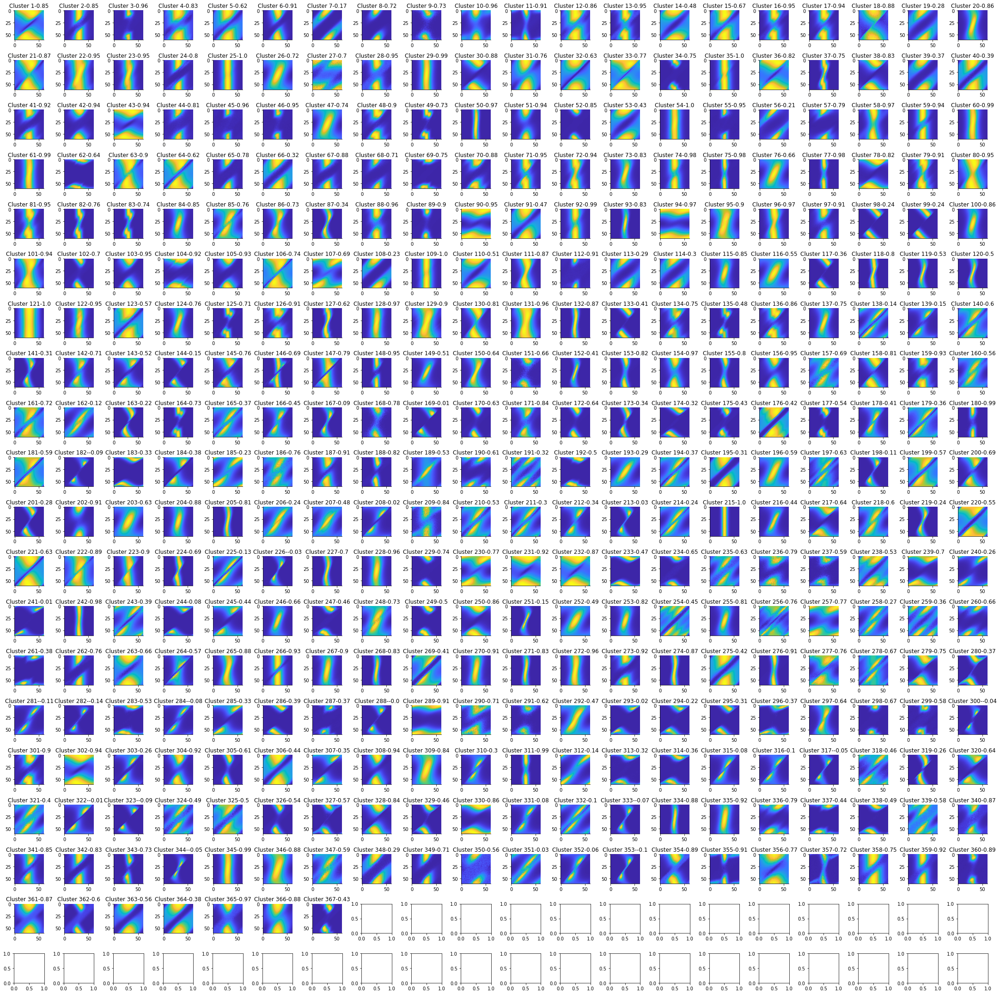

In [11]:
_, ax = plt.subplots(20, 20, figsize=(figS*5, figS*5))
ax=ax.flatten()
corrp = np.zeros(len(final_ix))
for p,pv in enumerate(final_ix):
    t = textures[:,:,pv]
    t = np.flip(t.T, axis=0)
    ax[p].imshow(t,cmap=parula_map)
    ax[p].spines["top"].set_visible(False)
    ax[p].spines["right"].set_visible(False)

    ax[p].grid(False)

    t1,t2 = t[:,:30],np.flip(t[:,31:], axis=1)
    corrp[p] = np.corrcoef(t1.flatten(), t2.flatten())[0,1]
    ax[p].set_title("Cluster "+str(p+1)+"-"+str(np.round(corrp[p],2)))
plt.tight_layout()
#plt.savefig(sp+"firing_base_pred"+str(mi)+".pdf")
plt.show()

In [12]:

# Define a correlation threshold above which images will be considered as 'correlating a lot'
corr_threshold = 0.95  # You can adjust this threshold as needed
# Initialize a list to keep track of indices of images to retain
keep_indices = []
# Initialize a boolean array to mark which images have already been checked
checked = np.zeros(corr.shape[0], dtype=bool)
# Iterate over the correlation matrix to filter out highly correlated images
for i in range(corr.shape[0]):
    if not checked[i]:  # Only proceed if the image hasn't already been checked
        # Mark the current image as checked
        checked[i] = True
        # Find indices of images that are highly correlated with the current image
        high_corr_indices = np.where(corr[i] > corr_threshold)[0]
        # Mark all these correlated images as checked
        checked[high_corr_indices] = True
        # Mark all highly correlated images as False (discard them)
        keep_indices.append(high_corr_indices[np.argmax(Moran[high_corr_indices])])

# Use the mask to filter the images
filtered_textures = textures[:, :, keep_indices]

print(f"Original number of images: {textures.shape[2]}")
print(f"Number of images after filtering: {filtered_textures.shape[2]}")

# The 'filtered_textures' array now contains only the non-correlating images.

Original number of images: 18184
Number of images after filtering: 294


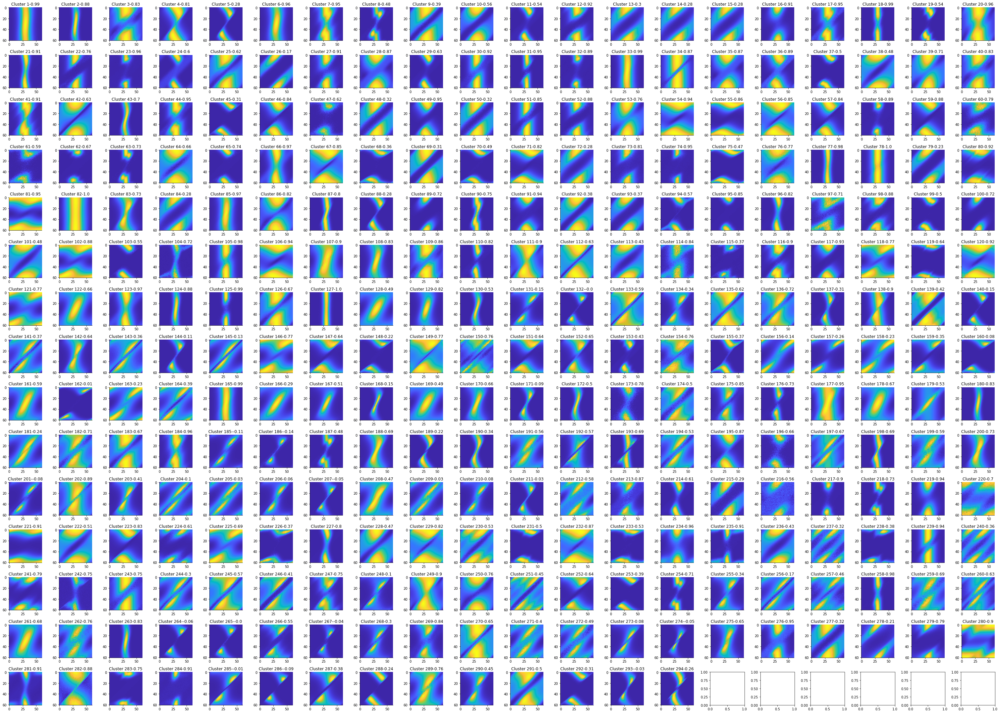

In [13]:
_, ax = plt.subplots(15, 20, figsize=(figS*7, figS*5))
ax=ax.flatten()
corrp = np.zeros(filtered_textures.shape[2])
for p in range(filtered_textures.shape[2]):
    #print(p)
    t = filtered_textures[:,:,p]
    #print([np.corrcoef(t.flatten(), filtered_textures[:,:,i].flatten())[0,1] for i in range(filtered_textures.shape[2])])
    t = np.flip(t.T, axis=0)
    ax[p].imshow(t,cmap=parula_map)
    ax[p].spines["top"].set_visible(False)
    ax[p].spines["right"].set_visible(False)

    ax[p].grid(False)

    t1,t2 = t[:,:30],np.flip(t[:,31:], axis=1)
    corrp[p] = np.corrcoef(t1.flatten(), t2.flatten())[0,1]
    ax[p].set_title("Cluster "+str(p+1)+"-"+str(np.round(corrp[p],2)))
plt.tight_layout()
#plt.savefig(sp+"firing_base_pred"+str(mi)+".pdf")
plt.show()

In [37]:

#cluster_ix = [1, 2, 3, 4,9,14,15,18,19,20,21,23,33,36,38,40,42,45,54,55,74,79,80,81,86,89,93,97,99,117,124,132,138,140,141,154,157,158,160,163,175,176,178,180,182,186,191,192,199, 201, 223,225,229,231,233,239,246,250,265,272,279,281,287,293]
cluster_ix = [2, 3, 9,15,19,20,21,33,40,42,45,54,55,79,81,89,117,132,140,141,154,158,163,176,178,180,186,192,201,223,231,239,246,281,287,293]
print(len(cluster_ix))

36


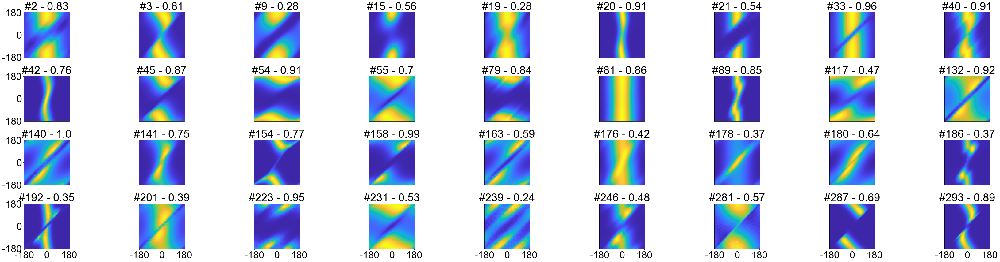

In [38]:
Np = [4,9]
_, ax = plt.subplots(Np[0], Np[1], figsize=(figS*8, figS*2))
ax=ax.flatten()
tckix = [0, 30, 60]
tckval = ["-180", "0", "180"]
tckvaly = ["180", "0", "-180"]
sorted_corr = range(len(cluster_ix))
for p,v in enumerate(sorted_corr):
    t = np.flip(filtered_textures[:,:,cluster_ix[v]].T, axis=0)
    ax[p].imshow(t,cmap=parula_map)
    ax[p].spines["top"].set_visible(False)
    ax[p].spines["right"].set_visible(False)
    ax[p].grid(False)
    ax[p].set_title("#"+str(cluster_ix[v])+" - "+str(np.round(corrp[v],2)),**f_font2)
    if p%Np[1]==0:
        ax[p].yaxis.set_ticks(tckix)
        ax[p].yaxis.set_ticklabels(tckvaly, **f_font1)
        if p>(Np[1]*(Np[0]-1)-1):
            ax[p].xaxis.set_ticks(tckix)
            ax[p].xaxis.set_ticklabels(tckval, **f_font1)
        else:
            ax[p].xaxis.set_ticks([ ])
    elif p>(Np[1]*(Np[0]-1)-1):
        ax[p].yaxis.set_ticks([ ])
        ax[p].xaxis.set_ticks(tckix)
        ax[p].xaxis.set_ticklabels(tckval, **f_font1)
    else:
        ax[p].xaxis.set_ticks([ ])
        ax[p].yaxis.set_ticks([ ])
    for labl in (ax[p].get_xticklabels()+ax[p].get_yticklabels()):
        labl.set_fontname(f_font1["fontname"])
        labl.set_fontsize(f_font1["size"])

plt.tight_layout()
#plt.savefig(sp+"firing_base_pred"+str(mi)+".pdf")
plt.show()

In [39]:
corrp = np.zeros(len(cluster_ix))
for p,pv in enumerate(cluster_ix):
    t = filtered_textures[:,:,pv]
    t = np.flip(t.T, axis=0)
    t1,t2 = t[:,:30],np.flip(t[:,31:], axis=1)
    corrp[p] = np.corrcoef(t1.flatten(), t2.flatten())[0,1]

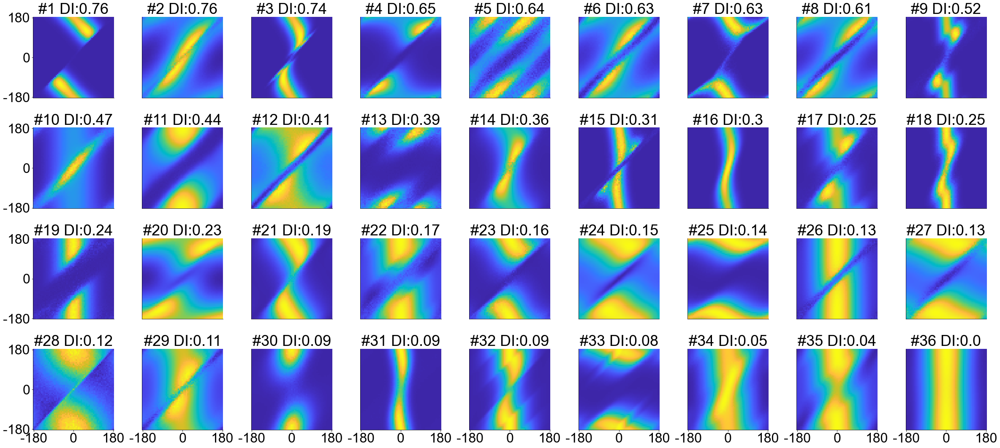

In [45]:
Np = [4,9]
_, ax = plt.subplots(Np[0], Np[1], figsize=(figS*5.5, figS*2.5))
ax=ax.flatten()
tckix = [0, 30, 60]
tckval = ["-180", "0", "180"]
tckvaly = ["180", "0", "-180"]
sorted_corr = np.argsort(corrp)
for p,v in enumerate(sorted_corr):
    t = np.flip(filtered_textures[:,:,cluster_ix[v]].T, axis=0)
    ax[p].imshow(t,cmap=parula_map)
    ax[p].spines["top"].set_visible(False)
    ax[p].spines["right"].set_visible(False)
    ax[p].grid(False)
    ax[p].set_title("#"+str(p+1)+" DI:"+str(np.round(1-corrp[v],2)),**f_font2)
    if p%Np[1]==0:
        ax[p].yaxis.set_ticks(tckix)
        ax[p].yaxis.set_ticklabels(tckvaly, **f_font1)
        if p>(Np[1]*(Np[0]-1)-1):
            ax[p].xaxis.set_ticks(tckix)
            ax[p].xaxis.set_ticklabels(tckval, **f_font1)
        else:
            ax[p].xaxis.set_ticks([ ])
    elif p>(Np[1]*(Np[0]-1)-1):
        ax[p].yaxis.set_ticks([ ])
        ax[p].xaxis.set_ticks(tckix)
        ax[p].xaxis.set_ticklabels(tckval, **f_font1)
    else:
        ax[p].xaxis.set_ticks([ ])
        ax[p].yaxis.set_ticks([ ])
    for labl in (ax[p].get_xticklabels()+ax[p].get_yticklabels()):
        labl.set_fontname(f_font1["fontname"])
        labl.set_fontsize(f_font1["size"])

plt.tight_layout()
#plt.savefig(sp+"firing_base_pred"+str(mi)+".pdf")
plt.show()

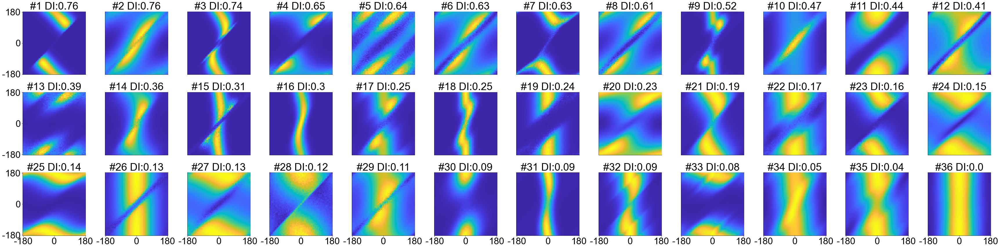

In [47]:
Np = [3,12]
_, ax = plt.subplots(Np[0], Np[1], figsize=(figS*8, figS*2))
ax=ax.flatten()
tckix = [0, 30, 60]
tckval = ["-180", "0", "180"]
tckvaly = ["180", "0", "-180"]
sorted_corr = np.argsort(corrp)
for p,v in enumerate(sorted_corr):
    t = np.flip(filtered_textures[:,:,cluster_ix[v]].T, axis=0)
    ax[p].imshow(t,cmap=parula_map)
    ax[p].spines["top"].set_visible(False)
    ax[p].spines["right"].set_visible(False)
    ax[p].grid(False)
    ax[p].set_title("#"+str(p+1)+" DI:"+str(np.round(1-corrp[v],2)),**f_font2)
    if p%Np[1]==0:
        ax[p].yaxis.set_ticks(tckix)
        ax[p].yaxis.set_ticklabels(tckvaly, **f_font1)
        if p>(Np[1]*(Np[0]-1)-1):
            ax[p].xaxis.set_ticks(tckix)
            ax[p].xaxis.set_ticklabels(tckval, **f_font1)
        else:
            ax[p].xaxis.set_ticks([ ])
    elif p>(Np[1]*(Np[0]-1)-1):
        ax[p].yaxis.set_ticks([ ])
        ax[p].xaxis.set_ticks(tckix)
        ax[p].xaxis.set_ticklabels(tckval, **f_font1)
    else:
        ax[p].xaxis.set_ticks([ ])
        ax[p].yaxis.set_ticks([ ])
    for labl in (ax[p].get_xticklabels()+ax[p].get_yticklabels()):
        labl.set_fontname(f_font1["fontname"])
        labl.set_fontsize(f_font1["size"])

plt.tight_layout()
#plt.savefig(sp+"firing_base_pred"+str(mi)+".pdf")
plt.show()

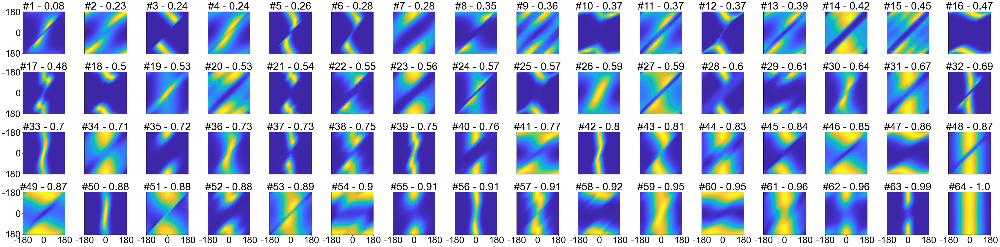

In [16]:
_, ax = plt.subplots(4, 16, figsize=(figS*8, figS*2))
ax=ax.flatten()
tckix = [0, 30, 60]
tckval = ["-180", "0", "180"]
tckvaly = ["180", "0", "-180"]
sorted_corr = np.argsort(corrp)
for p,v in enumerate(sorted_corr):
    t = np.flip(filtered_textures[:,:,cluster_ix[v]].T, axis=0)
    ax[p].imshow(t,cmap=parula_map)
    ax[p].spines["top"].set_visible(False)
    ax[p].spines["right"].set_visible(False)
    ax[p].grid(False)
    ax[p].set_title("#"+str(p+1)+" - "+str(np.round(corrp[v],2)),**f_font2)
    if p%16==0:
        ax[p].yaxis.set_ticks(tckix)
        ax[p].yaxis.set_ticklabels(tckvaly, **f_font1)
        if p>47:
            ax[p].xaxis.set_ticks(tckix)
            ax[p].xaxis.set_ticklabels(tckval, **f_font1)
        else:
            ax[p].xaxis.set_ticks([ ])
    elif p>47:
        ax[p].yaxis.set_ticks([ ])
        ax[p].xaxis.set_ticks(tckix)
        ax[p].xaxis.set_ticklabels(tckval, **f_font1)
    else:
        ax[p].xaxis.set_ticks([ ])
        ax[p].yaxis.set_ticks([ ])
    for labl in (ax[p].get_xticklabels()+ax[p].get_yticklabels()):
        labl.set_fontname(f_font1["fontname"])
        labl.set_fontsize(f_font1["size"])

plt.tight_layout()
#plt.savefig(sp+"firing_base_pred"+str(mi)+".pdf")
plt.show()

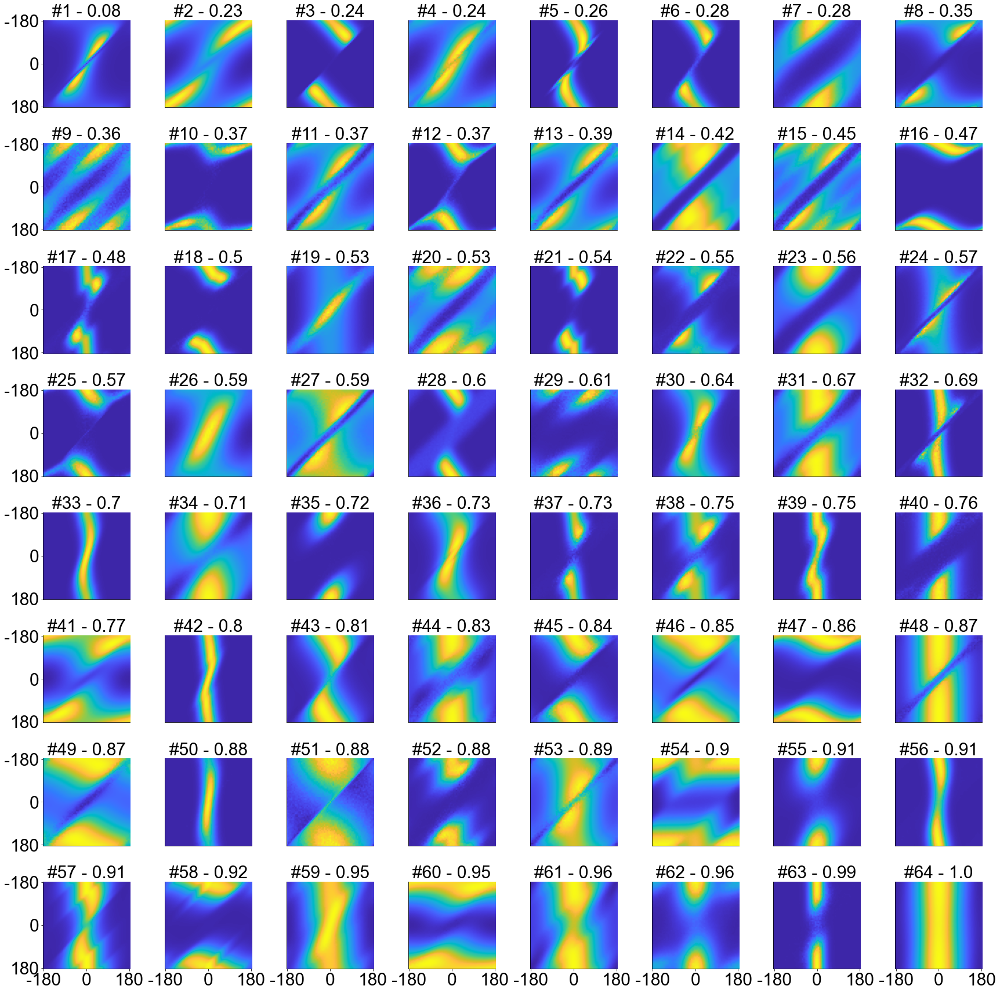

In [114]:
_, ax = plt.subplots(8, 8, figsize=(figS*4, figS*4))
ax=ax.flatten()
tckix = [0, 30, 60]
tckval = ["-180", "0", "180"]
sorted_corr = np.argsort(corrp)
for p,v in enumerate(sorted_corr):
    t = np.flip(filtered_textures[:,:,cluster_ix[v]].T, axis=0)
    ax[p].imshow(t,cmap=parula_map)
    ax[p].spines["top"].set_visible(False)
    ax[p].spines["right"].set_visible(False)
    ax[p].grid(False)
    ax[p].set_title("#"+str(p+1)+" - "+str(np.round(corrp[v],2)),**f_font2)
    if p%8==0:
        ax[p].yaxis.set_ticks(tckix)
        ax[p].yaxis.set_ticklabels(tckval, **f_font1)
        if p>55:
            ax[p].xaxis.set_ticks(tckix)
            ax[p].xaxis.set_ticklabels(tckval, **f_font1)
        else:
            ax[p].xaxis.set_ticks([ ])
    elif p>55:
        ax[p].yaxis.set_ticks([ ])
        ax[p].xaxis.set_ticks(tckix)
        ax[p].xaxis.set_ticklabels(tckval, **f_font1)
    else:
        ax[p].xaxis.set_ticks([ ])
        ax[p].yaxis.set_ticks([ ])
    for labl in (ax[p].get_xticklabels()+ax[p].get_yticklabels()):
        labl.set_fontname(f_font1["fontname"])
        labl.set_fontsize(f_font1["size"])

plt.tight_layout()
#plt.savefig(sp+"firing_base_pred"+str(mi)+".pdf")
plt.show()

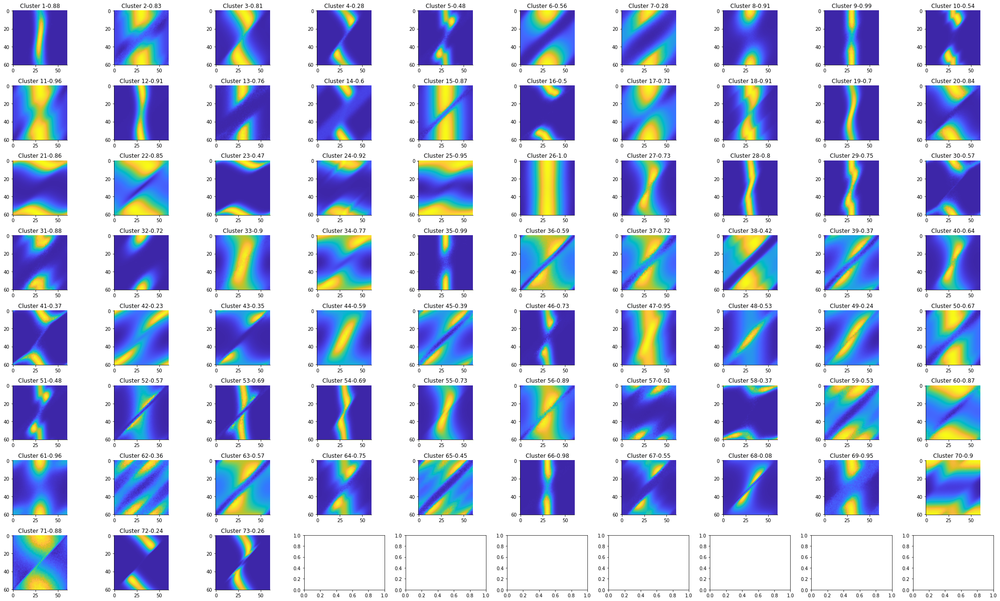

In [84]:


for p,pv in enumerate(cluster_ix):
    #print(p)
    t = filtered_textures[:,:,pv]
    #print([np.corrcoef(t.flatten(), filtered_textures[:,:,i].flatten())[0,1] for i in range(filtered_textures.shape[2])])
    t = np.flip(t.T, axis=0)
    ax[p].imshow(t,cmap=parula_map)
    ax[p].spines["top"].set_visible(False)
    ax[p].spines["right"].set_visible(False)

    ax[p].grid(False)

    t1,t2 = t[:,:30],np.flip(t[:,31:], axis=1)
    #corrp[p] = np.corrcoef(t1.flatten(), t2.flatten())[0,1]
    #ax[p].set_title("Cluster "+str(p+1)+"-"+str(np.round(corrp[p],2)))
plt.tight_layout()
#plt.savefig(sp+"firing_base_pred"+str(mi)+".pdf")
plt.show()

Original number of images: 294
Number of images after filtering: 30
(61, 61, 30)


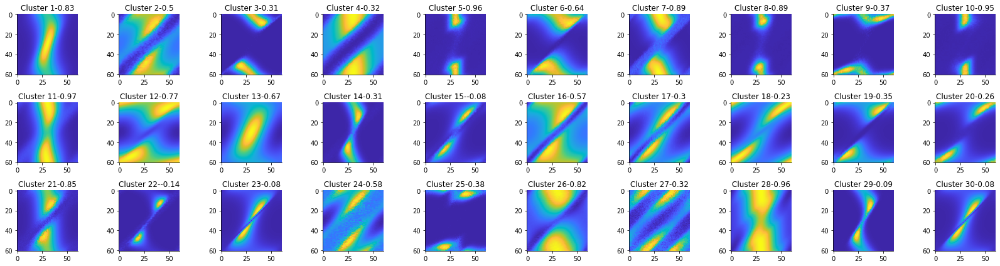

Original number of images: 294
Number of images after filtering: 30
(61, 61, 30)


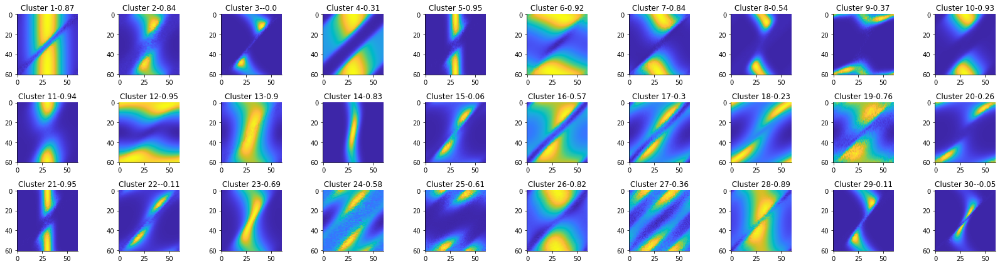

Original number of images: 294
Number of images after filtering: 30
(61, 61, 30)


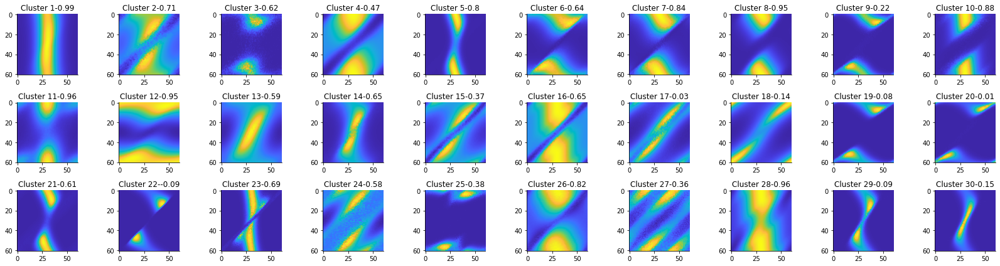

Original number of images: 294
Number of images after filtering: 30
(61, 61, 30)


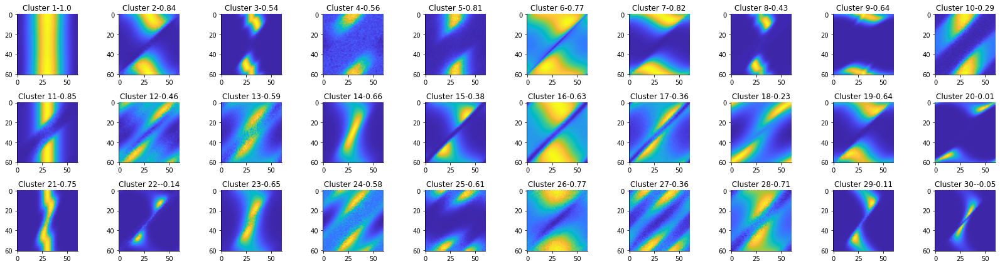

Original number of images: 294
Number of images after filtering: 30
(61, 61, 30)


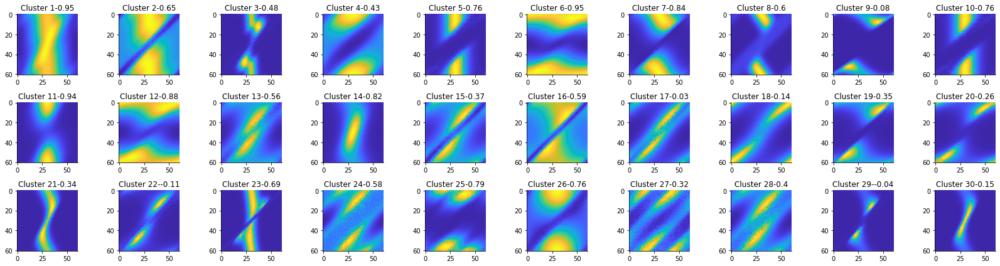

Original number of images: 294
Number of images after filtering: 30
(61, 61, 30)


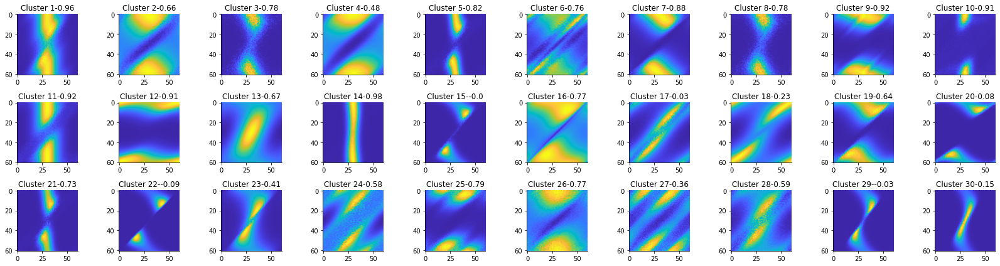

Original number of images: 294
Number of images after filtering: 30
(61, 61, 30)


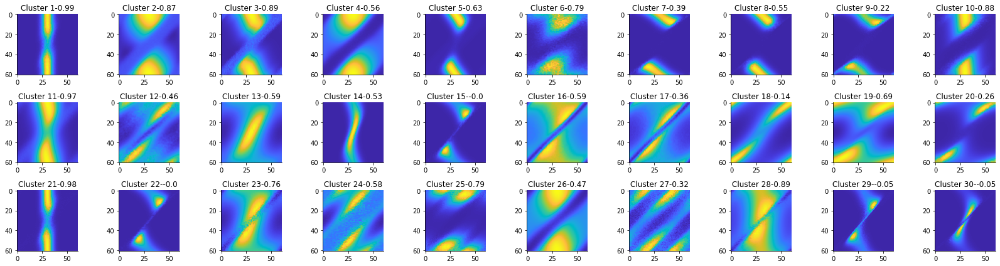

Original number of images: 294
Number of images after filtering: 30
(61, 61, 30)


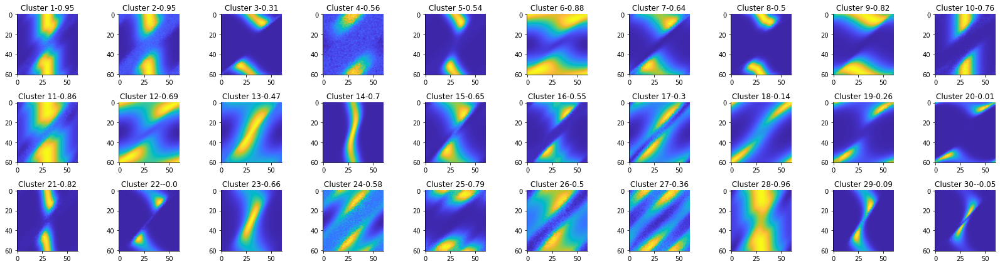

Original number of images: 294
Number of images after filtering: 30
(61, 61, 30)


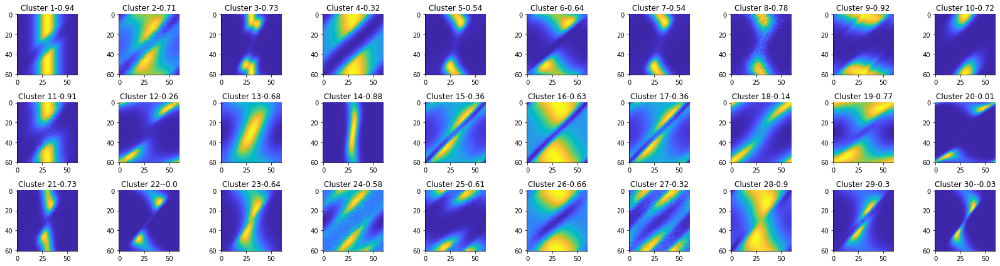

Original number of images: 294
Number of images after filtering: 30
(61, 61, 30)


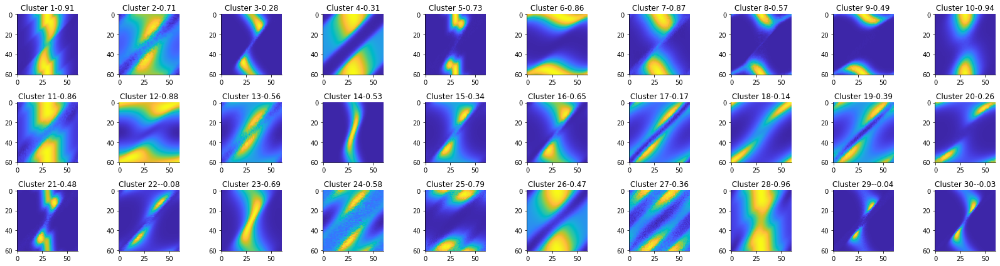

In [79]:

corr2 = np.corrcoef(filtered_textures.reshape(filtered_textures.shape[0]*filtered_textures.shape[1], filtered_textures.shape[2]).T)

# Define a correlation threshold above which images will be considered as 'correlating a lot'
corr_threshold = 0.85  # You can adjust this threshold as needed
for i in range(10):
    # Initialize a list to keep track of indices of images to retain
    keep_indices = []
    # Initialize a boolean array to mark which images have already been checked
    checked = np.zeros(corr2.shape[0], dtype=bool)
    # Iterate over the correlation matrix to filter out highly correlated images
    for i in range(corr2.shape[0]):
        if not checked[i]:  # Only proceed if the image hasn't already been checked
            # Mark the current image as checked
            checked[i] = True
            # Find indices of images that are highly correlated with the current image
            high_corr_indices = np.where(corr2[i] > corr_threshold)[0]
            # Mark all these correlated images as checked
            checked[high_corr_indices] = True
            # Mark all highly correlated images as False (discard them)
            keep_indices.append(random.sample(list(high_corr_indices),1)[0])

    # Use the mask to filter the images
    filtered2_textures = filtered_textures[:, :, keep_indices]

    print(f"Original number of images: {filtered_textures.shape[2]}")
    print(f"Number of images after filtering: {filtered2_textures.shape[2]}")
    print(filtered2_textures.shape)
    _, ax = plt.subplots(3, 10, figsize=(figS*3.8, figS))
    ax=ax.flatten()
    corrp = np.zeros(filtered2_textures.shape[2])
    for p in range(filtered2_textures.shape[2]):
        #print(p)
        t = filtered2_textures[:,:,p]
        #print([np.corrcoef(t.flatten(), filtered_textures[:,:,i].flatten())[0,1] for i in range(filtered_textures.shape[2])])
        t = np.flip(t.T, axis=0)
        ax[p].imshow(t,cmap=parula_map)
        ax[p].spines["top"].set_visible(False)
        ax[p].spines["right"].set_visible(False)

        ax[p].grid(False)

        t1,t2 = t[:,:30],np.flip(t[:,31:], axis=1)
        corrp[p] = np.corrcoef(t1.flatten(), t2.flatten())[0,1]
        ax[p].set_title("Cluster "+str(p+1)+"-"+str(np.round(corrp[p],2)))
    plt.tight_layout()
    #plt.savefig(sp+"firing_base_pred"+str(mi)+".pdf")
    plt.show()

In [37]:
# Assuming your texture data is loaded and normalized into a variable `textures` (Nx1xHxW tensor)
textures = textures[:,:,final_ix]
textures = textures.transpose(2, 0, 1).reshape(-1, 1, meanfire1.shape[0], meanfire1.shape[1])

print(textures.shape)

(367, 1, 61, 61)


In [38]:


class ConvAutoencoder(nn.Module):
    def __init__(self, k1, k2, k3, out1, out2, out3):
        super(ConvAutoencoder, self).__init__()
        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(1, out1, k1, stride=2, padding=1), # Adjust input channels as needed
            nn.ReLU(),
            nn.Conv2d(out1, out2, k2, stride=2, padding=1),
            nn.ReLU(),
            nn.Conv2d(out2, out3, k3)
        )
        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(out3, out2, k3),
            nn.ReLU(),
            nn.ConvTranspose2d(out2, out1, k2, stride=2, padding=1, output_padding=1),
            nn.ReLU(),
            nn.ConvTranspose2d(out1, 1, k1, stride=2, padding=1, output_padding=0), # Adjust output channels as needed
            nn.Sigmoid() # Assuming input textures are normalized [0, 1]
        )

    def forward(self, x):
        encoded = self.encoder(x)
        decoded = self.decoder(encoded)
        return encoded, decoded


In [39]:
tensor_textures = torch.tensor(textures).float()
dataset = TensorDataset(tensor_textures)
dataloader = DataLoader(dataset, batch_size=10, shuffle=True)

# Define the device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

k1, k2, k3, out1, out2, out3 = 3, 3, 7, 16, 32, 64
def train_model(k1, k2, k3, out1, out2, out3, nE, dataloader, device):
    model = ConvAutoencoder(k1, k2, k3, out1, out2, out3).to(device)
    criterion = nn.MSELoss()
    optimizer = optim.Adam(model.parameters(), lr=0.001)

    # Training loop
    num_epochs = nE # Adjust as needed
    for epoch in range(num_epochs):
        for data in dataloader:
            inputs, = data
            #print(inputs.shape)
            optimizer.zero_grad()
            _, decoded = model(inputs)
            #print(decoded.shape)
            loss = criterion(decoded, inputs)
            loss.backward()
            optimizer.step()
        print(f'Epoch {epoch+1}, Loss: {loss.item()}')
    return model

def extract_features_kmean(model, dataloader, nC, rS, textures):
    # Use the trained encoder to extract features
    model.eval()
    features = []
    with torch.no_grad():
        for data in dataloader:
            inputs, = data
            encoded, _ = model(inputs)
            #print(encoded.shape)
            features.append(encoded.view(encoded.size(0), -1).cpu().numpy())
    sh = encoded.shape
    features = np.concatenate(features, axis=0)
    #print(features.shape)
    # Perform k-means clustering
    kmeans = KMeans(n_clusters=nC, random_state=rS).fit(features)
    # Calculate the distance of each feature to each cluster center
    distances = cdist(features, kmeans.cluster_centers_, 'euclidean')
    # Find the index of the closest sample to each cluster center
    closest_indices = np.argmin(distances, axis=0)
    # Use these indices to select the representative textures from the original dataset
    representative_textures = [textures[i] for i in closest_indices]
    categories = kmeans.predict(features)
    return kmeans, representative_textures, sh, distances, categories

def extract_features_hc(model, dataloader, textures, dT):
    # Use the trained encoder to extract features
    model.eval()
    features = []
    with torch.no_grad():
        for data in dataloader:
            inputs, = data
            encoded, _ = model(inputs)
            #print(encoded.shape)
            features.append(encoded.view(encoded.size(0), -1).cpu().numpy())
    sh = encoded.shape
    features = np.concatenate(features, axis=0)
    #print(features.shape)
    # Perform hierarchical clustering clustering
    clustering = AgglomerativeClustering(distance_threshold=dT, n_clusters=None).fit(features)
    categories = clustering.labels_
    cluster_centers = np.array([features[categories == i].mean(axis=0) for i in np.unique(categories)])
    # Calculate the distance of each feature to each cluster center
    distances = cdist(features, cluster_centers, 'euclidean')
    # Find the index of the closest sample to each cluster center
    closest_indices = np.argmin(distances, axis=0)
    # Use these indices to select the representative textures from the original dataset
    representative_textures = [textures[i] for i in closest_indices]
    return clustering, representative_textures, sh, distances, categories, cluster_centers

def extract_features_dbsc(model, dataloader, textures, eps, min_samples):
    # Use the trained encoder to extract features
    model.eval()
    features = []
    with torch.no_grad():
        for data in dataloader:
            inputs, = data
            encoded, _ = model(inputs)
            #print(encoded.shape)
            features.append(encoded.view(encoded.size(0), -1).cpu().numpy())
    sh = encoded.shape
    features = np.concatenate(features, axis=0)
    #print(features.shape)
    # Perform DBSCAN clustering
    dbscan = DBSCAN(eps=eps, min_samples=min_samples)
    dbscan.fit(features)
    # DBSCAN labels for the dataset
    categories = dbscan.labels_
    # Number of clusters
    n_clusters_ = len(set(categories)) - (1 if -1 in categories else 0) 
    cluster_centers = np.array([features[categories == i].mean(axis=0) for i in range(n_clusters_)])
    # Calculate the distance of each feature to each cluster center
    distances = cdist(features, cluster_centers, 'euclidean')
    # Find the index of the closest sample to each cluster center
    closest_indices = np.argmin(distances, axis=0)
    # Use these indices to select the representative textures from the original dataset
    representative_textures = [textures[i] for i in closest_indices]
    return dbscan, representative_textures, sh, distances, categories, cluster_centers

def generate_textures(kmeans, model, sh, device, cc=None):
    if cc is None:
        cc = kmeans.cluster_centers_
    # Assuming `model` is your trained model and it has a decoder that can take latent space representations
    model.eval()
    generated_textures = []
    with torch.no_grad():
        for center in cc:
            # Reshape and convert the cluster center to a tensor
            #print(center.shape)
            center_tensor = torch.tensor(center, dtype=torch.float32).view(sh[1], sh[2], sh[3])  # Adjust shape as necessary
            center_tensor = center_tensor.to(device)  # If using GPU
            # Decode the center tensor to get the generated texture
            generated_texture = model.decoder(center_tensor)
            T = np.squeeze(generated_texture.cpu().numpy())
            #plt.imshow(T, cmap='gray')
            #plt.show()
            generated_textures.append(T)
    return generated_textures

In [40]:
# Assuming `features` is the array of encoded features from your dataset
# and `kmeans` is your trained KMeans model

k1, k2, k3, out1, out2, out3 = 3, 6, 9, 16, 32, 64
m = train_model(k1, k2, k3, out1, out2, out3, 50, dataloader, device)


Epoch 1, Loss: 0.03379681333899498
Epoch 2, Loss: 0.019602768123149872
Epoch 3, Loss: 0.01663074642419815
Epoch 4, Loss: 0.009246078319847584
Epoch 5, Loss: 0.010656382888555527
Epoch 6, Loss: 0.005589342210441828
Epoch 7, Loss: 0.005532803945243359
Epoch 8, Loss: 0.0022664861753582954
Epoch 9, Loss: 0.0018698741914704442
Epoch 10, Loss: 0.0021481073927134275
Epoch 11, Loss: 0.003124917158856988
Epoch 12, Loss: 0.0010636999504640698
Epoch 13, Loss: 0.0014915184583514929
Epoch 14, Loss: 0.0021384782157838345
Epoch 15, Loss: 0.0023623628076165915
Epoch 16, Loss: 0.0017356289317831397
Epoch 17, Loss: 0.0009064506739377975
Epoch 18, Loss: 0.001110919052734971
Epoch 19, Loss: 0.0013186142314225435
Epoch 20, Loss: 0.0005974043160676956
Epoch 21, Loss: 0.0009946669451892376
Epoch 22, Loss: 0.0007407558732666075
Epoch 23, Loss: 0.001707281800918281
Epoch 24, Loss: 0.0005084418226033449
Epoch 25, Loss: 0.000544946116860956
Epoch 26, Loss: 0.0006576768937520683
Epoch 27, Loss: 0.0006474734982475

In [43]:
# save pytorch model
torch.save(m, sp+'ClusterModel_sample.pth')

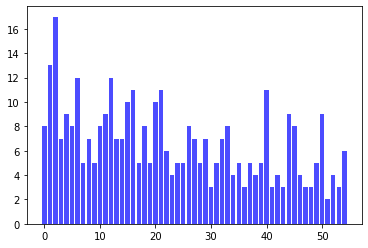

(array([], dtype=int64),)


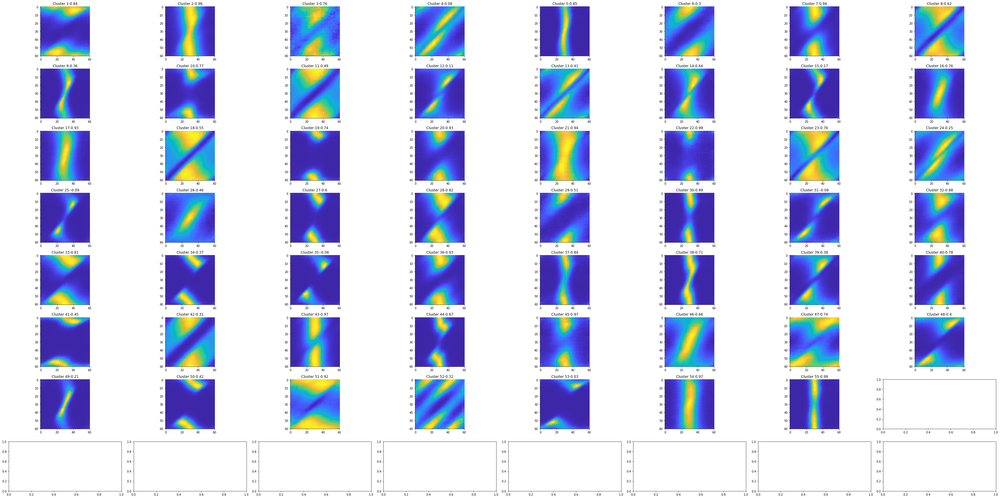

In [46]:
for i in [60]:

    k,texts,sh,dist,c,cc = extract_features_hc(m, dataloader, textures, i)
    T = generate_textures(k, m, sh, device,cc)
    np.unique(c)
    n = np.array([sum(c==j) for j in np.unique(c)])
    plt.bar(range(len(np.unique(c))), n, color='blue', alpha=0.7)
    plt.show()
    print(np.where(n>100))
    _, ax = plt.subplots(8, 8, figsize=(figS*8, figS*4))
    #ix = [3,5,7,8,9,14,15,17,18,20,22,23,24,26,27,28,30,32,33,34]
    corrp = np.zeros(len(T))
    ax = ax.ravel()
    for p in range(len(T)):
        t = T[p]

        t = np.flip(t.T, axis=0)
        ax[p].imshow(t,cmap=parula_map)
        ax[p].spines["top"].set_visible(False)
        ax[p].spines["right"].set_visible(False)

        ax[p].grid(False)

        t1,t2 = t[:,:30],np.flip(t[:,31:], axis=1)
        corrp[p] = np.corrcoef(t1.flatten(), t2.flatten())[0,1]
        ax[p].set_title("Cluster "+str(p+1)+"-"+str(np.round(corrp[p],2)))
    plt.tight_layout()
    #plt.savefig(sp+"firing_base_pred"+str(mi)+".pdf")
    plt.show()

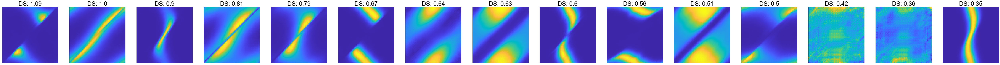

In [ ]:
ix = np.argsort(corrp)[:15]
_, ax = plt.subplots(1, 15, figsize=(figS*15, figS))
ax = ax.ravel()
for p in range(len(ix)):
    t = np.flip(T[ix[p]].T, axis=0)
    ax[p].imshow(t,cmap=parula_map)
    ax[p].spines["top"].set_visible(False)
    ax[p].spines["right"].set_visible(False)

    ax[p].grid(False)
    ax[p].xaxis.set_ticks([])
    #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
    #ax.xaxis.set_ticklabels(["0","0.5","1"], **f_font1)
    ax[p].yaxis.set_ticks([])
    #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
    #ax.yaxis.set_ticklabels(["0","0.5","1"], **f_font1)
    #above = 1 if n[p]>100 else 0
    ax[p].set_title("DS: "+str(np.round(1-corrp[ix[p]],2)), **f_font1)
#plt.tight_layout()
plt.savefig(sp+"clusters_hc.pdf")
plt.show()

In [ ]:

n1 = len(T)
corrp = np.zeros(n1)
for p in range(n1):
    t = T[p]
    t1,t2 = t[:,:45],np.flip(t[:,46:], axis=1)
    corrp[p] = np.corrcoef(t1.flatten(), t2.flatten())[0,1]

In [ ]:
corrp

array([ 0.77336199, -0.02593694,  0.20657502,  0.97080348,  0.89773046,
        0.99209842,  0.94927349,  0.49745044,  0.95477781,  0.89612634,
        0.42373418,  0.43967899,  0.66353474,  0.77392504,  0.92417271,
        0.74696131,  0.89860505,  0.92303472,  0.96138417,  0.77360762,
        0.74458299,  0.7836729 ,  0.84367121,  0.50388195,  0.95530626,
        0.65810443,  0.75313029,  0.11148578,  0.99736285,  0.94982615,
        0.76234457,  0.85489218,  0.4147433 ,  0.07290138,  0.65255386,
        0.98818097])

In [ ]:
n1,n2,n3 = len(T), meanfire.shape[2], meanfire.shape[4]*meanfire.shape[5]*meanfire.shape[6]
corr = np.zeros((n1, n2*n2, n3))
RMSE = np.zeros((n1, n2*n2, n3))
for p in range(n1):
    t = T[p]
    j=0
    for ss in range(5):
        for cs in range(5):
            fr = meanfire[:,:,ss,cs,:,:,:]
            fr = fr.reshape(91,91,-1)
            fr = fr.reshape(91*91,-1).T
            fr_ = np.array(t.reshape(91*91))
            #print(fr.shape, fr_.shape)
            corr[p,j,:] = np.corrcoef(fr, fr_)[0,1:]
            RMSE[p,j,:] = np.sqrt(np.mean((fr - fr_)**2, axis=1))
            j+=1

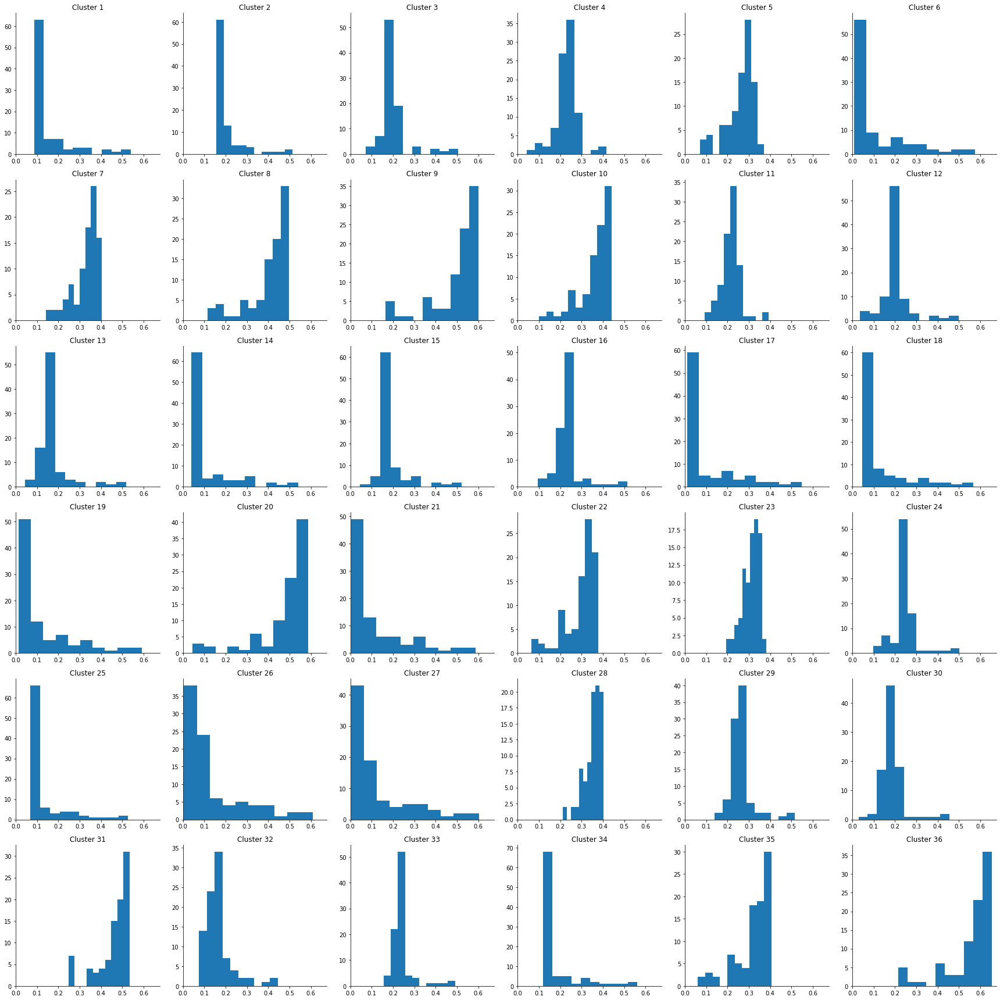

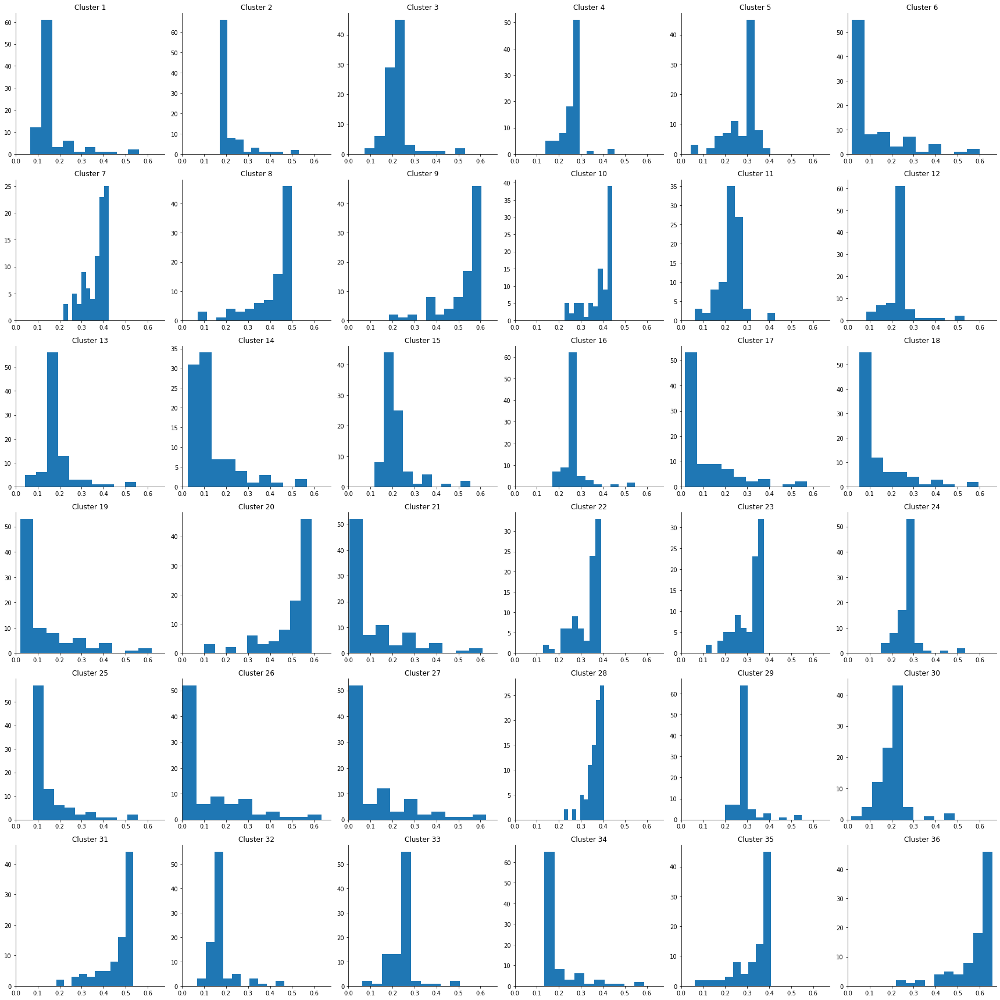

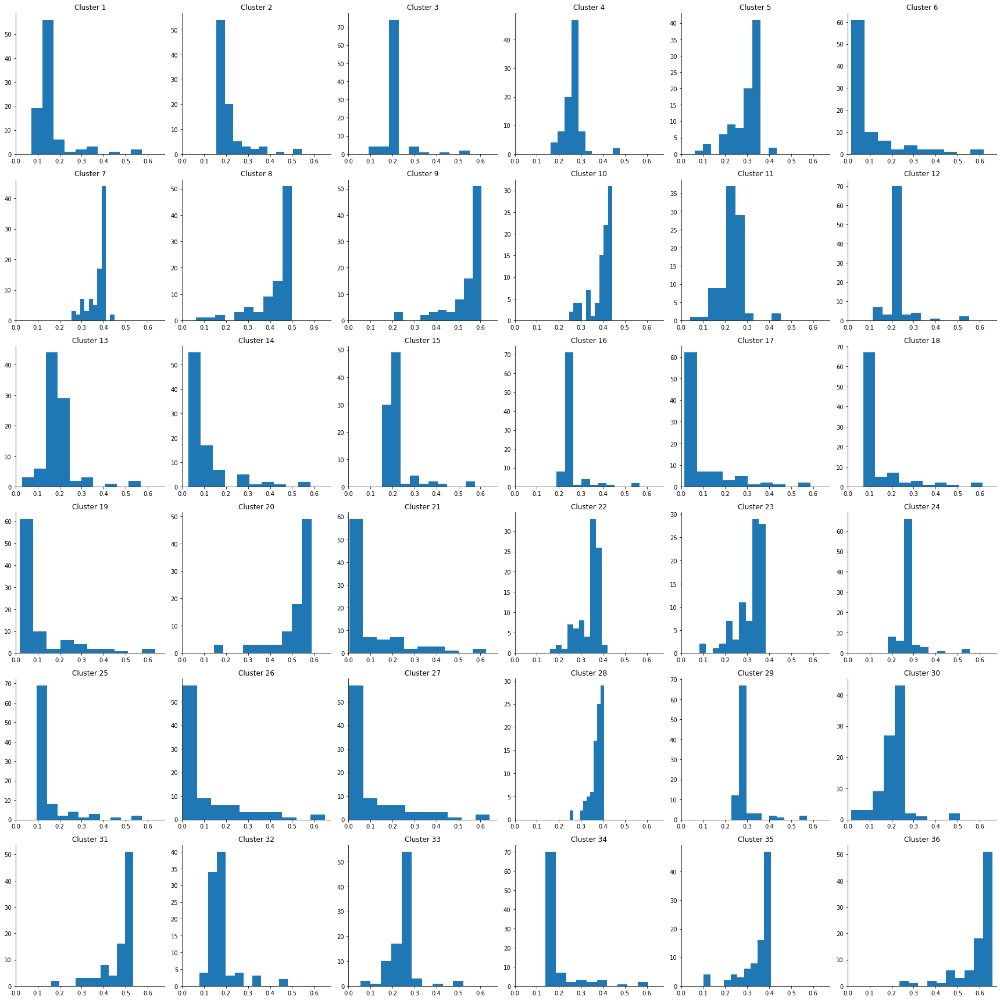

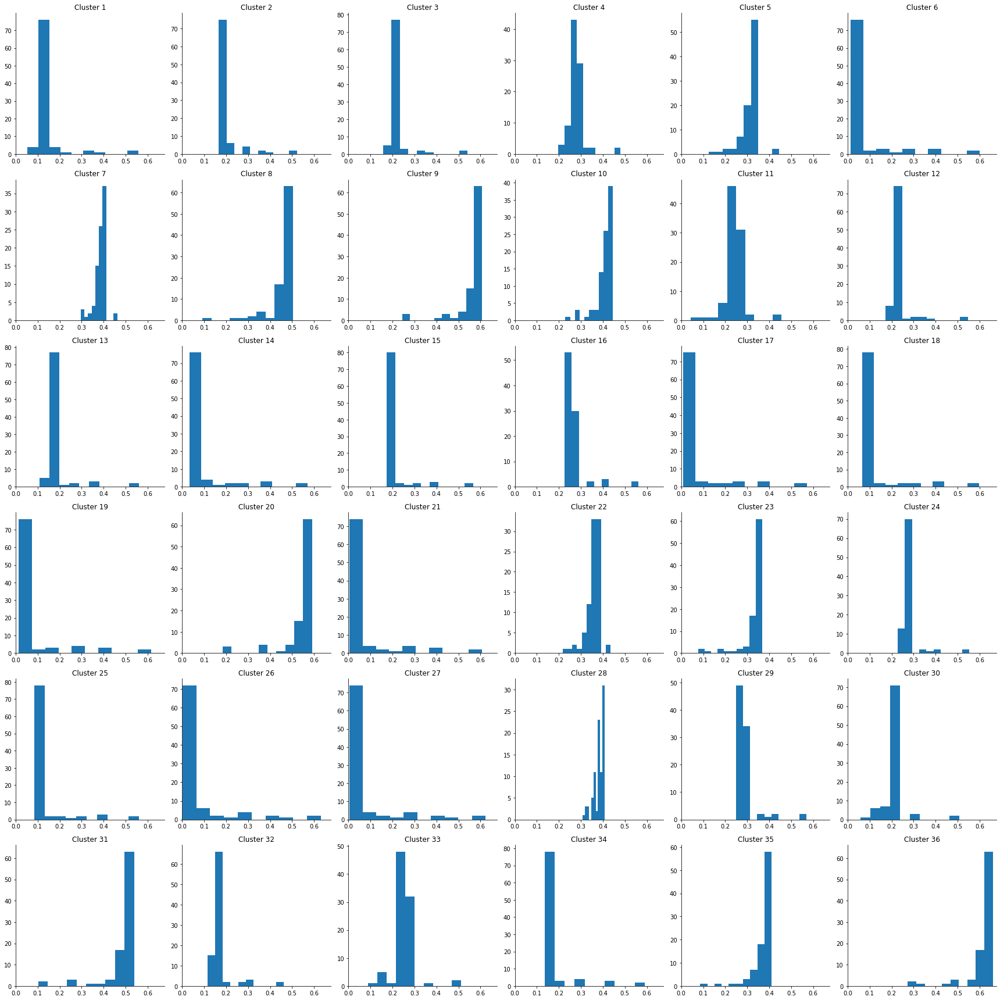

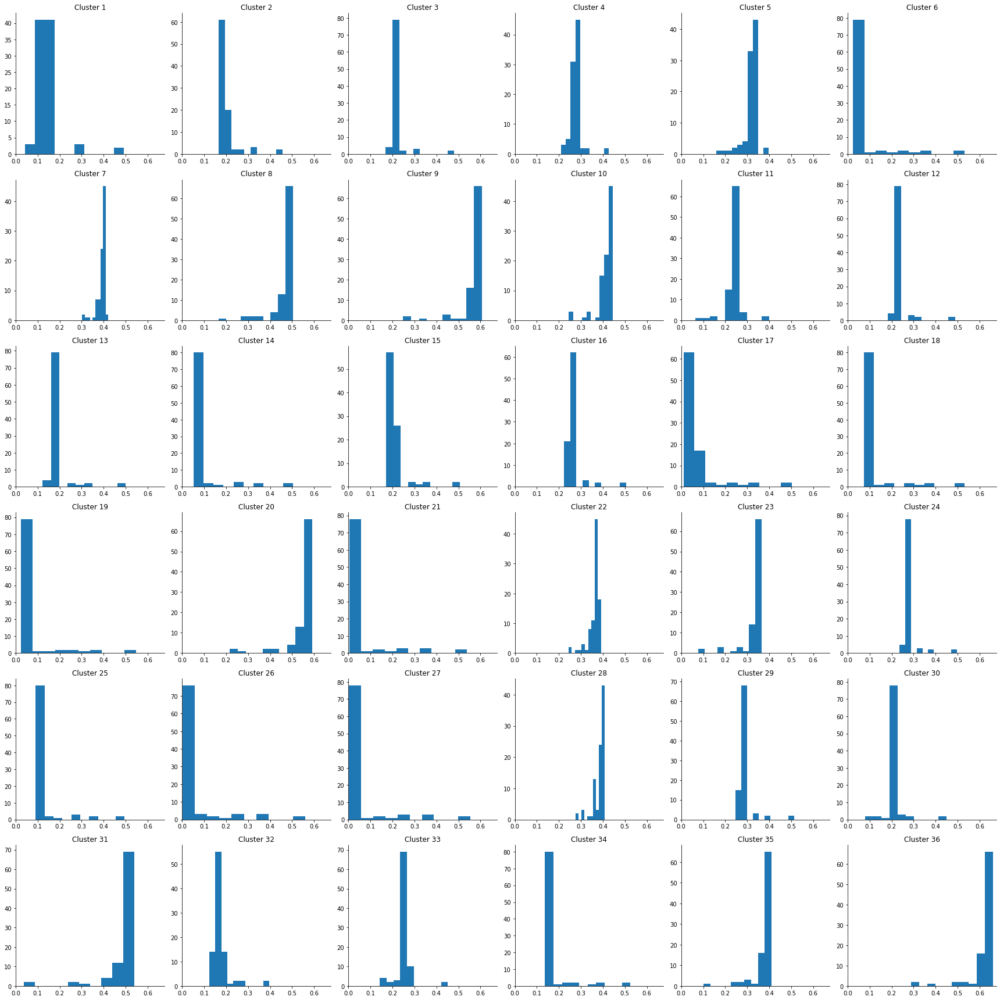

...

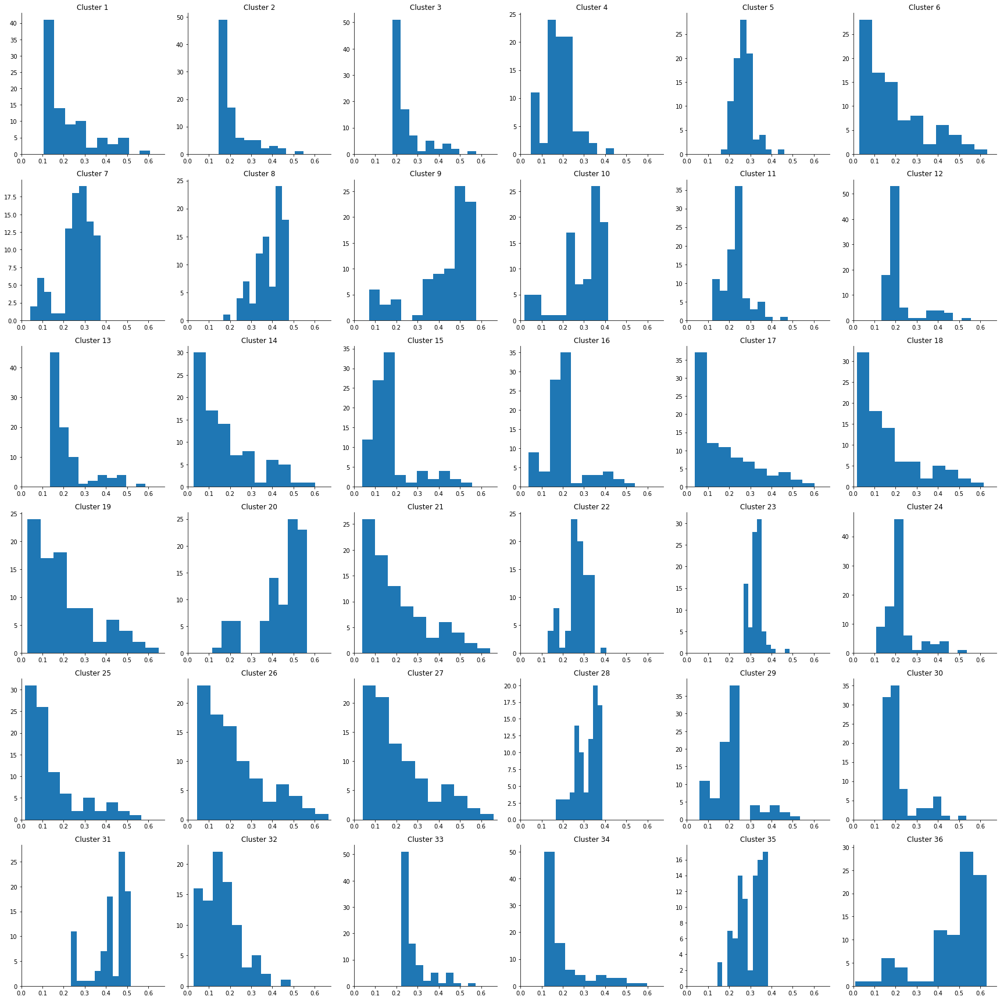

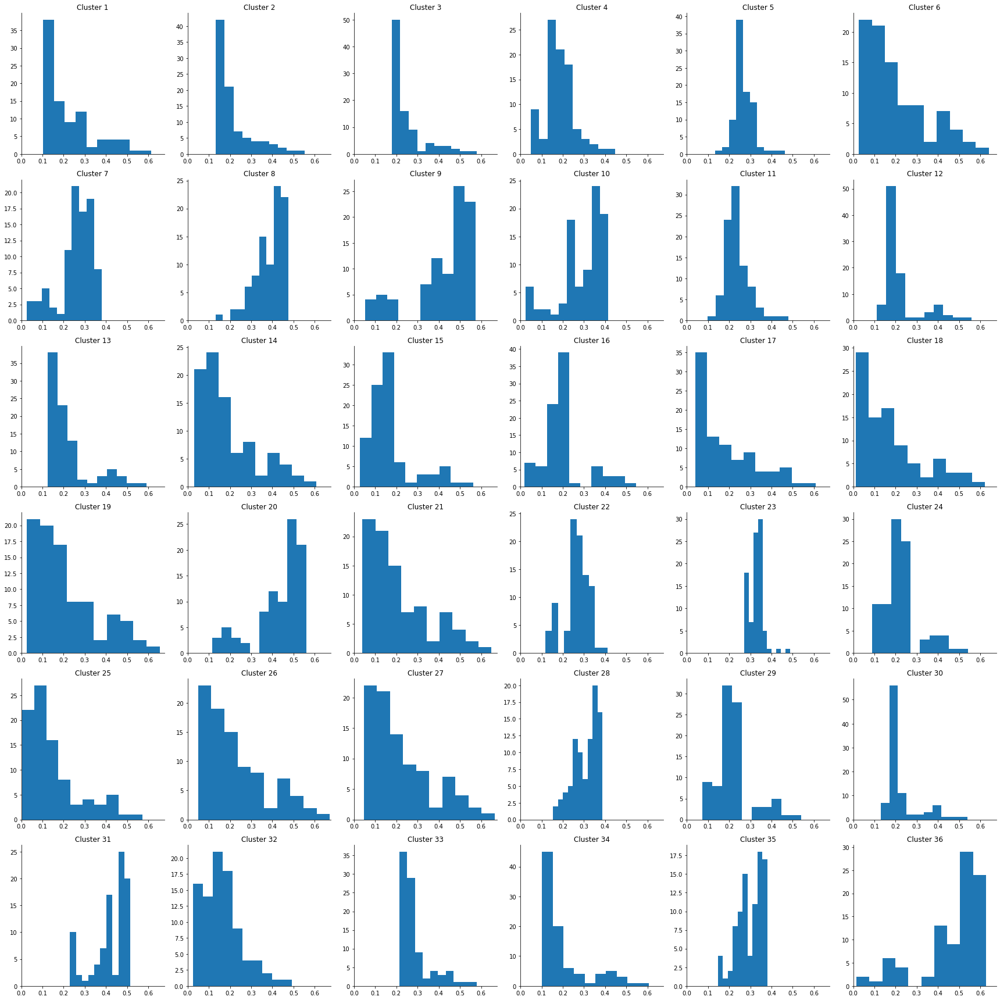

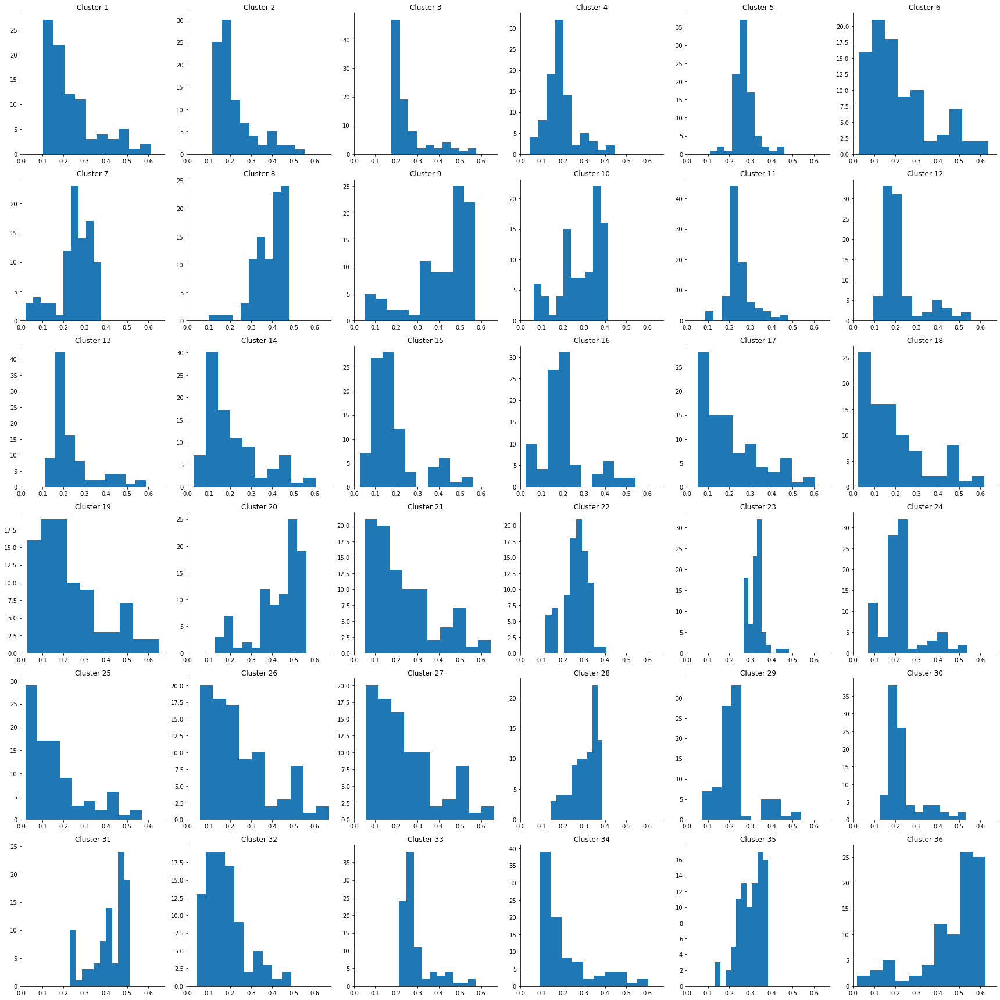

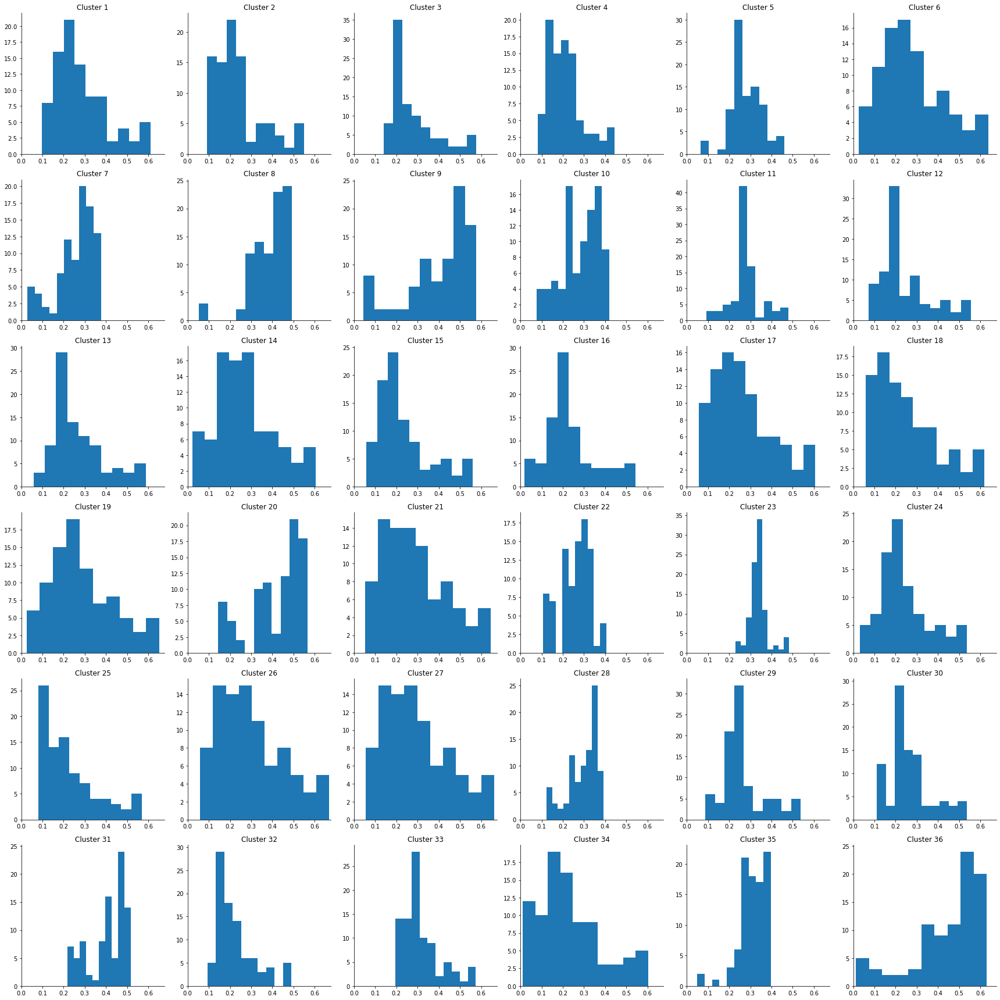

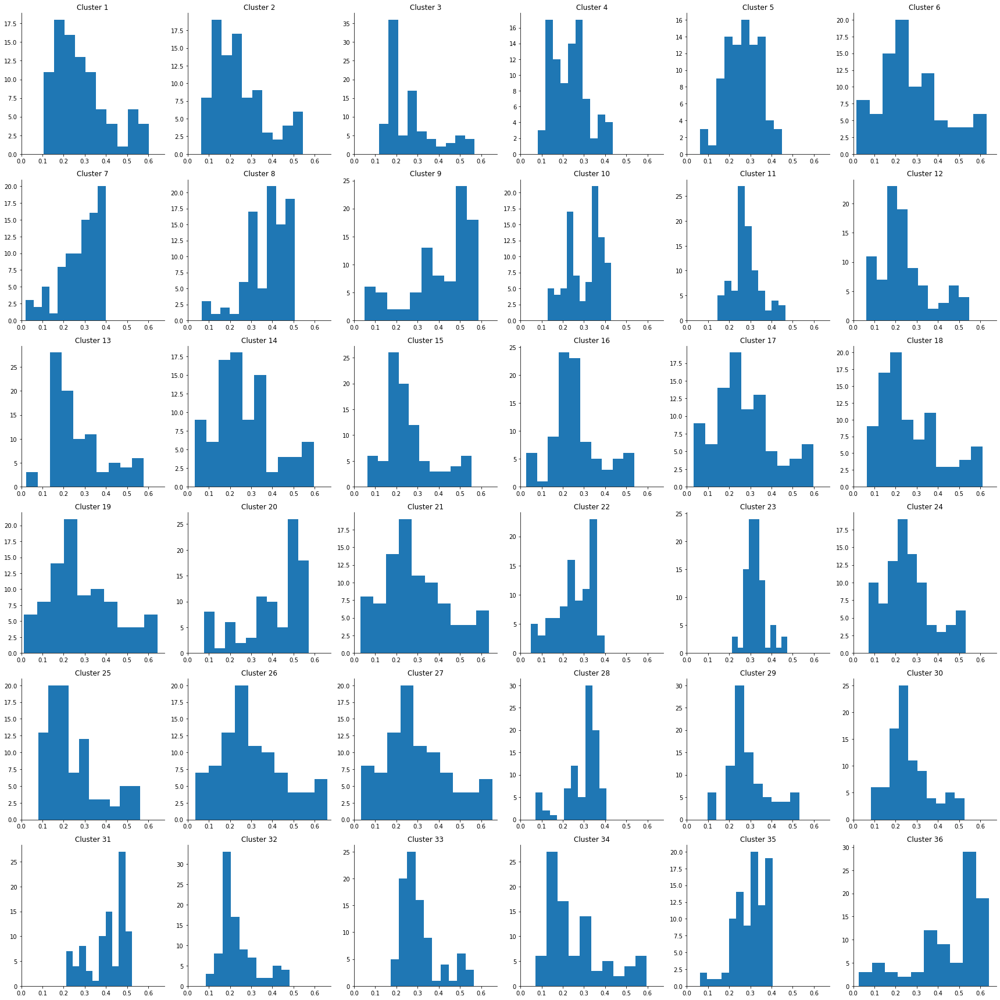

In [ ]:
for ss in range(5):
        for cs in range(5):
                _, ax = plt.subplots(6, 6, figsize=(figS*4, figS*4))
                ax = ax.ravel()
                for p in range(n1):
                    ax[p].hist(RMSE[p,ss,cs,:], bins=10)
                    ax[p].spines["top"].set_visible(False)
                    ax[p].spines["right"].set_visible(False)
                    ax[p].set_xlim([0, np.max(RMSE)])
                    ax[p].grid(False)
                    ax[p].set_title("Cluster "+str(p+1))
                plt.tight_layout()
                plt.show()

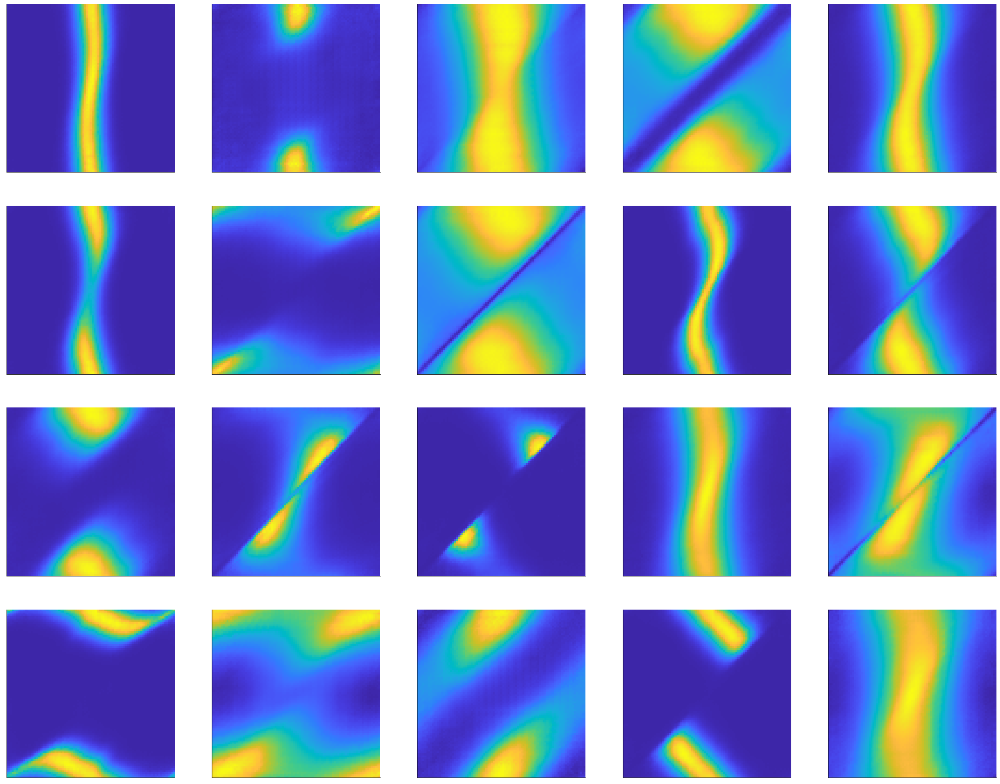

In [ ]:
ix = [3,5,7,8,9,14,15,17,18,20,22,23,24,26,27,28,30,32,33,34]
_, ax = plt.subplots(4, 5, figsize=(figS*5, figS*4))
ax = ax.ravel()
for p in range(len(ix)):
    t = np.flip(T[ix[p]].T, axis=0)
    ax[p].imshow(t,cmap=parula_map)
    ax[p].spines["top"].set_visible(False)
    ax[p].spines["right"].set_visible(False)

    ax[p].grid(False)
    ax[p].xaxis.set_ticks([])
    #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
    #ax.xaxis.set_ticklabels(["0","0.5","1"], **f_font1)
    ax[p].yaxis.set_ticks([])
    #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
    #ax.yaxis.set_ticklabels(["0","0.5","1"], **f_font1)
    #above = 1 if n[p]>100 else 0
    #ax[p].set_title("Cluster "+str(p+1)+"-"+str(above))
#plt.tight_layout()
plt.savefig(sp+"clusters.pdf")
plt.show()

In [ ]:
k,texts,sh,dist,c,cc = extract_features_dbsc(m, dataloader, textures, 1, 50)
T = generate_textures(k, m, sh, device,cc)
np.unique(c)

ValueError: XB must be a 2-dimensional array.

In [ ]:
n = np.array([sum(c==j) for j in np.unique(c)])
plt.bar(range(len(np.unique(c))), n, color='blue', alpha=0.7)
plt.show()
print(np.where(n>100))
_, ax = plt.subplots(6, 5, figsize=(figS*1.7, figS*1.5))
ax = ax.ravel()
for p in range(len(T)):
    t = T[p]
    ax[p].imshow(t)
    ax[p].spines["top"].set_visible(False)
    ax[p].spines["right"].set_visible(False)
    #ax.spines["left"].set_visible(False)
    #ax.spines["bottom"].set_visible(False)
    #ax.spines["left"].set_visible(False)
    ax[p].grid(False)
    # for label in (ax.get_xticklabels()+ax.get_yticklabels()):
    #     label.set_fontname(f_font1["fontname"])
    #     label.set_fontsize(35)
    #ax.xaxis.set_ticks([-4,0,4])
    #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
    #ax.xaxis.set_ticklabels(["0","0.5","1"], **f_font1)
    #ax.yaxis.set_ticks([-4,0,4])
    #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
    #ax.yaxis.set_ticklabels(["0","0.5","1"], **f_font1)
    #ax.set_xlim(-4.1, 4.1)
    #ax.set_ylim(-4.1, 4.1)
    #plt.tick_params(top=False, bottom=False, left=False, right=False,
    #                labelleft=False, labelbottom=False)
    above = 1 if n[p]>100 else 0
    ax[p].set_title("Cluster "+str(p+1)+"-"+str(above))
plt.tight_layout()
#plt.savefig(sp+"firing_base_pred"+str(mi)+".pdf")
plt.show()

In [47]:
Tk=[]
D = []
C = []
for r in range(5):
    print(r)
    k,texts,sh,dist,c = extract_features_kmean(m, dataloader, 36, r, textures)
    Tk.append(generate_textures(k, m, sh, device))
    D.append(dist)
    C.append(c)

0
1
2
3
4


In [48]:
len(Tk)

5

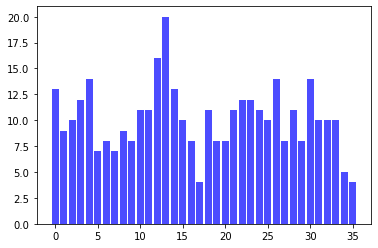

(array([], dtype=int64),)


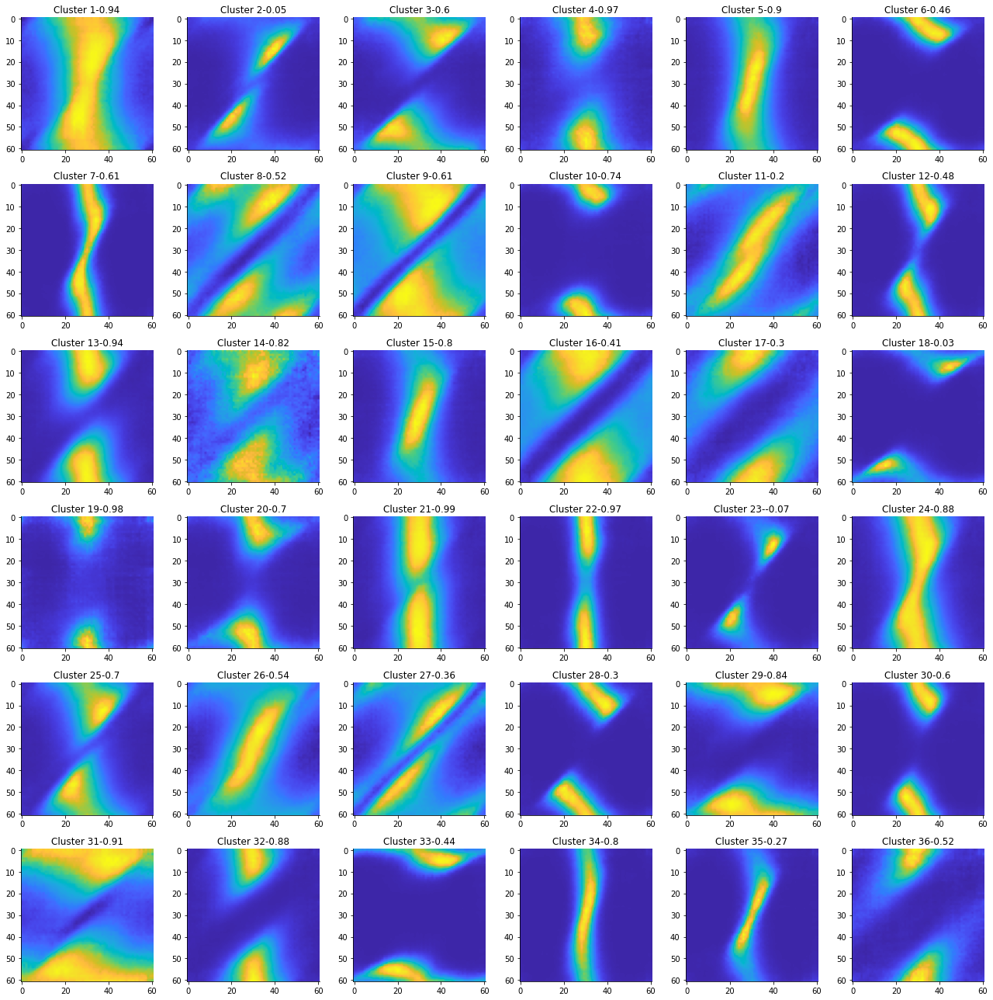

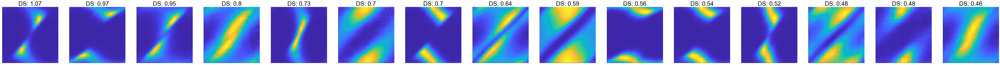

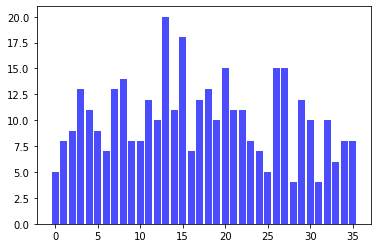

(array([], dtype=int64),)


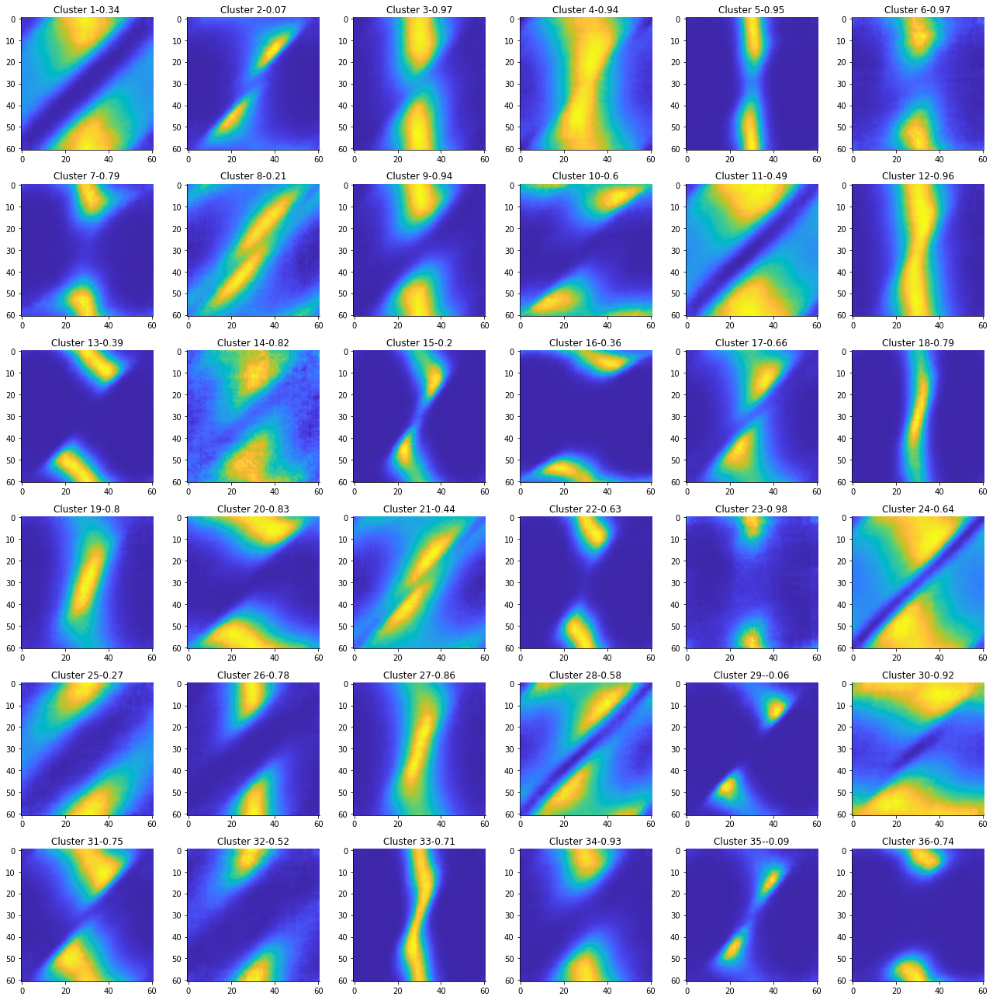

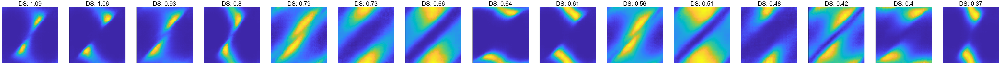

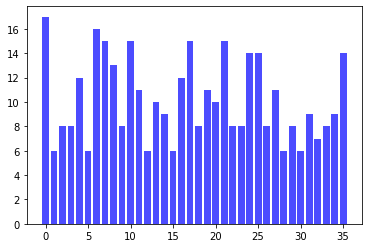

(array([], dtype=int64),)


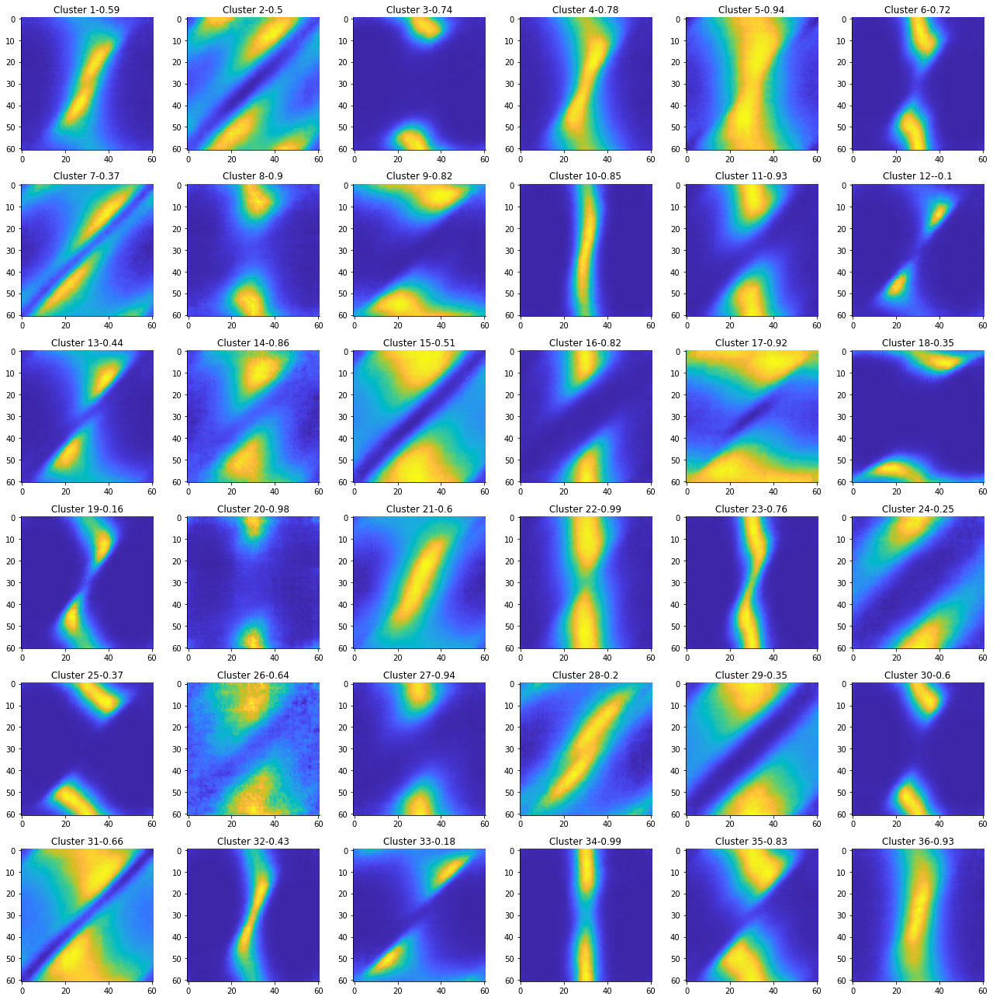

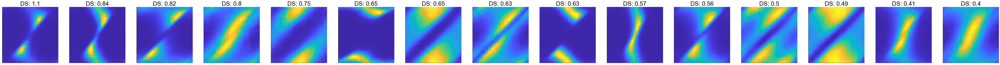

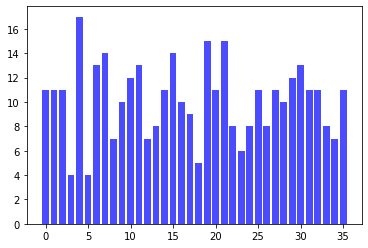

(array([], dtype=int64),)


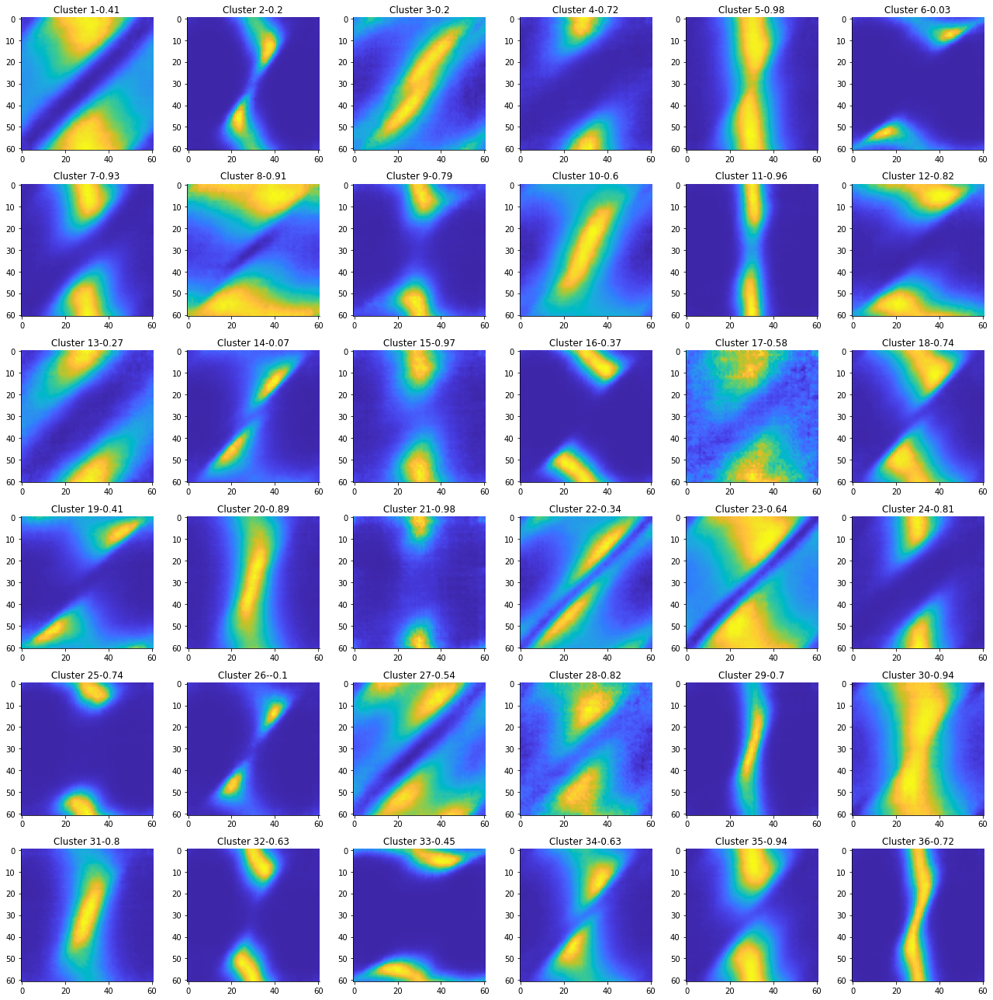

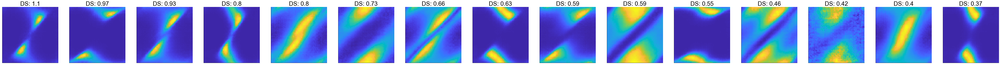

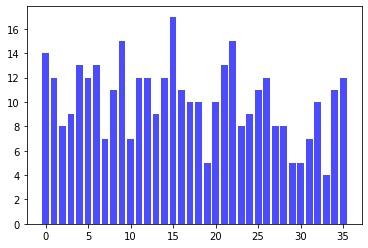

(array([], dtype=int64),)


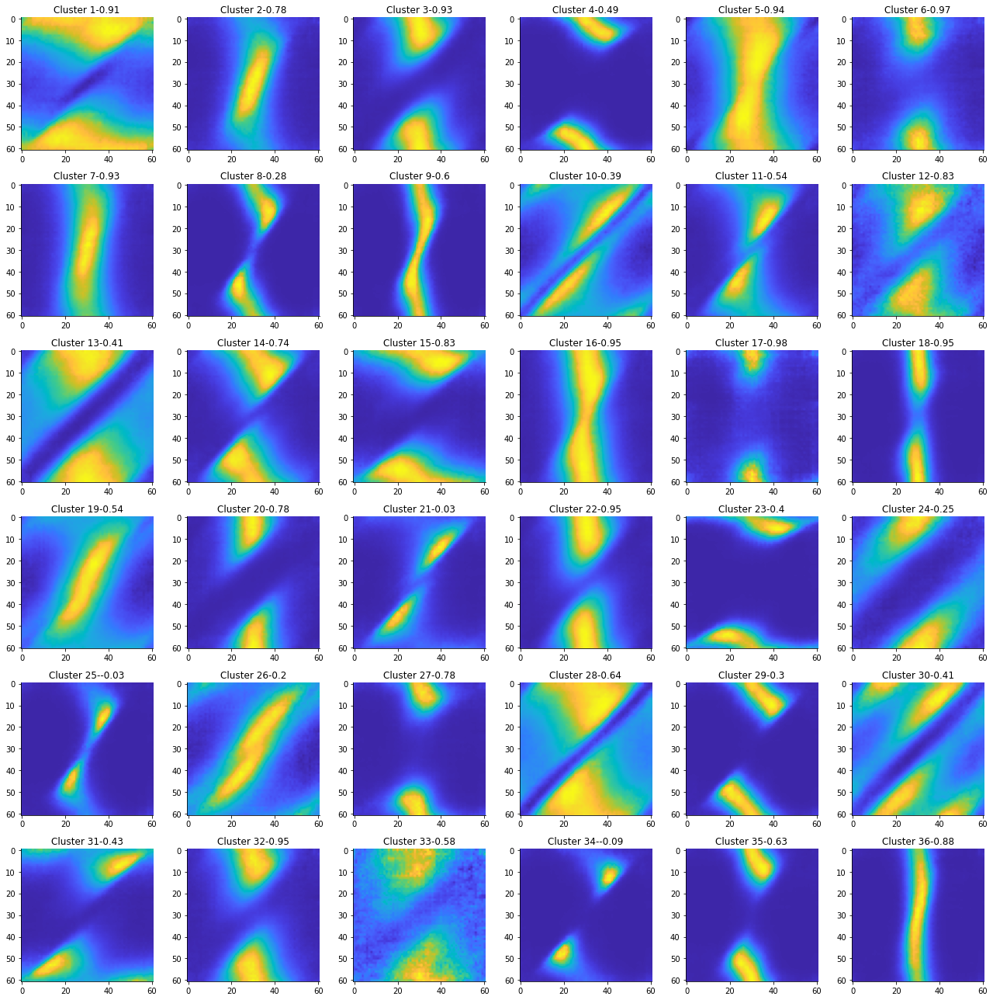

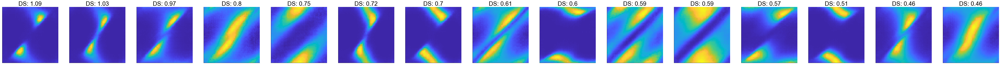

In [49]:
for i in range(5):
    n = np.array([sum(C[i]==j) for j in np.unique(C[i])])
    plt.bar(range(len(np.unique(C[i]))), n, color='blue', alpha=0.7)
    plt.show()
    print(np.where(n>100))
    _, ax = plt.subplots(6, 6, figsize=(figS*3, figS*3))
    ax = ax.ravel()
    corrp = np.zeros(len(Tk[i]))
    for p in range(len(Tk[i])):
        t = np.flip(Tk[i][p].T, axis=0)
        ax[p].imshow(t,cmap=parula_map)
        ax[p].spines["top"].set_visible(False)
        ax[p].spines["right"].set_visible(False)
        #ax.spines["left"].set_visible(False)
        #ax.spines["bottom"].set_visible(False)
        #ax.spines["left"].set_visible(False)
        ax[p].grid(False)
        # for label in (ax.get_xticklabels()+ax.get_yticklabels()):
        #     label.set_fontname(f_font1["fontname"])
        #     label.set_fontsize(35)
        #ax.xaxis.set_ticks([-4,0,4])
        #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
        #ax.xaxis.set_ticklabels(["0","0.5","1"], **f_font1)
        #ax.yaxis.set_ticks([-4,0,4])
        #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
        #ax.yaxis.set_ticklabels(["0","0.5","1"], **f_font1)
        #ax.set_xlim(-4.1, 4.1)
        #ax.set_ylim(-4.1, 4.1)
        #plt.tick_params(top=False, bottom=False, left=False, right=False,
        #                labelleft=False, labelbottom=False)
        t1,t2 = t[:,:30],np.flip(t[:,31:], axis=1)
        corrp[p] = np.corrcoef(t1.flatten(), t2.flatten())[0,1]
        ax[p].set_title("Cluster "+str(p+1)+"-"+str(np.round(corrp[p],2)))
    plt.tight_layout()
    #plt.savefig(sp+"firing_base_pred"+str(mi)+".pdf")
    plt.show()

    ix = np.argsort(corrp)[:15]
    _, ax = plt.subplots(1, 15, figsize=(figS*15, figS))
    ax = ax.ravel()
    for p in range(len(ix)):
        t = np.flip(Tk[i][ix[p]].T, axis=0)
        ax[p].imshow(t,cmap=parula_map)
        ax[p].spines["top"].set_visible(False)
        ax[p].spines["right"].set_visible(False)

        ax[p].grid(False)
        ax[p].xaxis.set_ticks([])
        #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
        #ax.xaxis.set_ticklabels(["0","0.5","1"], **f_font1)
        ax[p].yaxis.set_ticks([])
        #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
        #ax.yaxis.set_ticklabels(["0","0.5","1"], **f_font1)
        #above = 1 if n[p]>100 else 0
        ax[p].set_title("DS: "+str(np.round(1-corrp[ix[p]],2)), **f_font1)
    #plt.tight_layout()
    #plt.savefig(sp+"clusters_km"+str(i)+".pdf")
    plt.show()

In [ ]:
np.savez(sp+"kmean_36cluster_data.npz", Tk=Tk, D=D, C=C)

In [ ]:
n1,n2,n3 = len(Tk[3]), meanfire.shape[2], meanfire.shape[4]*meanfire.shape[5]*meanfire.shape[6]
corr = np.zeros((n1, n2*n2, n3))
RMSE = np.zeros((n1, n2*n2, n3))
for p in range(n1):
    t = Tk[3][p]
    j=0
    for ss in range(4,-1,-1):
        print(ss)
        for cs in range(5):
            fr = meanfire[:,:,ss,cs,:,:,:]
            fr = fr.reshape(91,91,-1)
            fr = fr.reshape(91*91,-1).T
            fr_ = np.array(t.reshape(91*91))
            #print(fr.shape, fr_.shape)
            corr[p,j,:] = np.corrcoef(fr, fr_)[-1,1:]
            #print(np.corrcoef(fr, fr_)[-1,1:])
            RMSE[p,j,:] = np.sqrt(np.mean((fr - fr_)**2, axis=1))
            j+=1

4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0
4
3
2
1
0


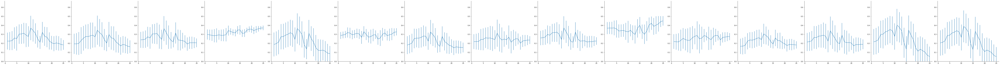

In [ ]:
corrp = np.zeros(len(Tk[3]))
for p in range(len(Tk[3])):
    t = np.flip(Tk[3][p].T, axis=0)
    t1,t2 = t[:,:45],np.flip(t[:,46:], axis=1)
    corrp[p] = np.corrcoef(t1.flatten(), t2.flatten())[0,1]

ix = np.argsort(corrp)[:15]

_, ax = plt.subplots(1, len(ix), figsize=(figS*15, figS*1))
ax = ax.ravel()
for p in range(len(ix)):
    ax[p].errorbar(range(1,n2*n2+1),np.mean(RMSE[ix[p],:,:],axis=1), yerr=np.std(RMSE[ix[p],:,:],axis=1))
    ax[p].spines["top"].set_visible(False)
    ax[p].spines["right"].set_visible(False)
    ax[p].set_ylim([0, np.max(RMSE)])
    ax[p].grid(False)
    #ax[p].set_title("Cluster "+str(p+1))
plt.tight_layout()
plt.savefig(sp+"clusters_km3_diag_rmse.pdf")
plt.show()

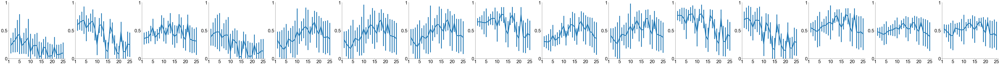

In [ ]:
corrp = np.zeros(len(Tk[3]))
for p in range(len(Tk[3])):
    t = np.flip(Tk[3][p].T, axis=0)
    t1,t2 = t[:,:45],np.flip(t[:,46:], axis=1)
    corrp[p] = np.corrcoef(t1.flatten(), t2.flatten())[0,1]

ix = np.argsort(corrp)[:15]

_, ax = plt.subplots(1, len(ix), figsize=(figS*15, figS*1))
ax = ax.ravel()
for p in range(len(ix)):
    ax[p].errorbar(range(1,n2*n2+1),np.mean(corr[ix[p],:,:],axis=1), yerr=np.std(corr[ix[p],:,:],axis=1),linewidth=5)
    ax[p].spines["top"].set_visible(False)
    ax[p].spines["right"].set_visible(False)
    ax[p].set_ylim([0, np.max(corr)])
    ax[p].grid(False)
    ax[p].set_ylim([0,1])
    ax[p].set_xlim([0,n2*n2+1])
    ax[p].yaxis.set_ticks([0,0.5,1])
    ax[p].yaxis.set_ticklabels([0,0.5,1], **f_font1)
    ax[p].xaxis.set_ticks([0,5,10,15,20,25])
    ax[p].xaxis.set_ticklabels([1,5,10,15,20,25], **f_font1)
    #ax[p].set_title("Cluster "+str(p+1))
plt.tight_layout()
plt.savefig(sp+"clusters_km3_diag_corr.pdf")
plt.show()

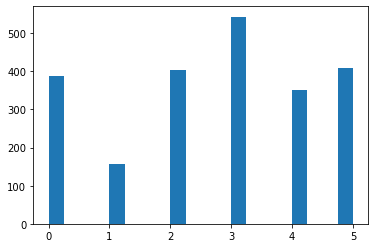

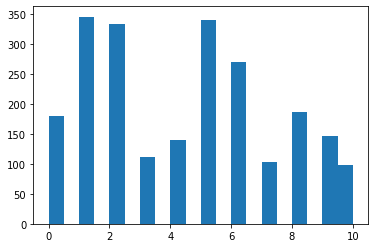

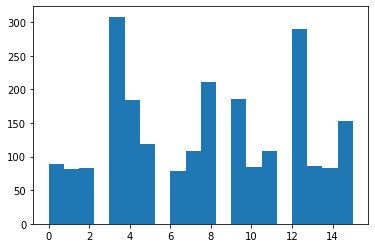

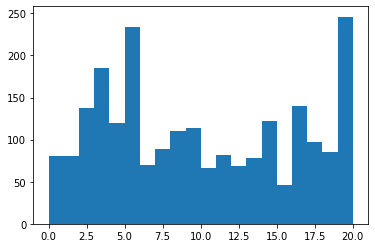

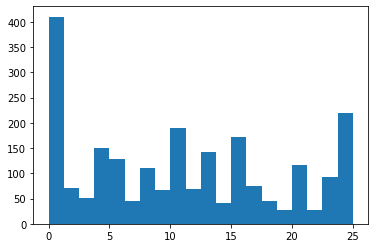

In [ ]:
for i in range(5,30,5):
    plt.hist(C[i], bins=20)
    plt.show()
    # for j in range(len(T[i])):
    #     print(i,j,np.mean(D[i][:,j]))
    #     plt.hist(D[i][:,j], bins=20)
    #     plt.show()

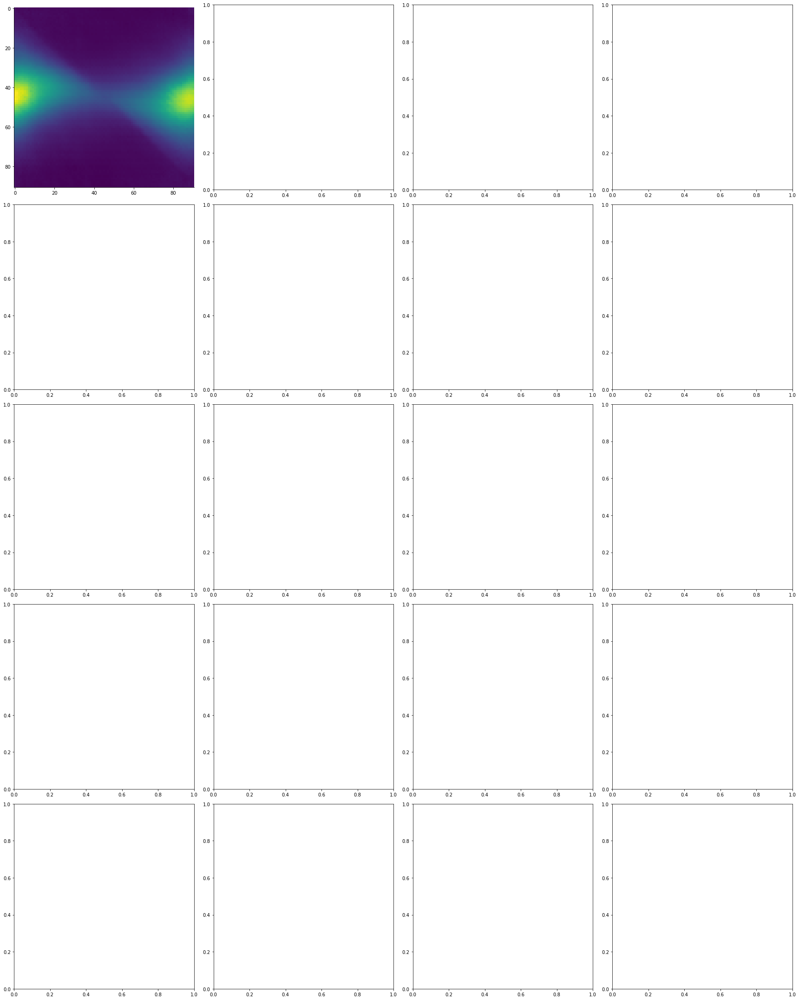

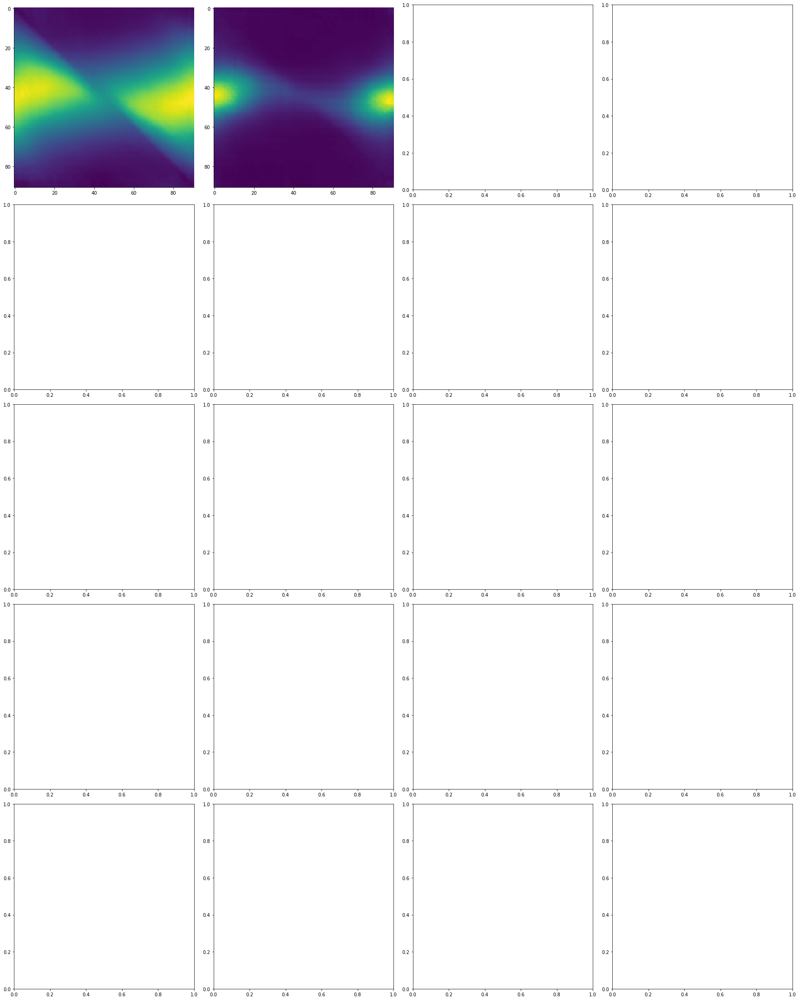

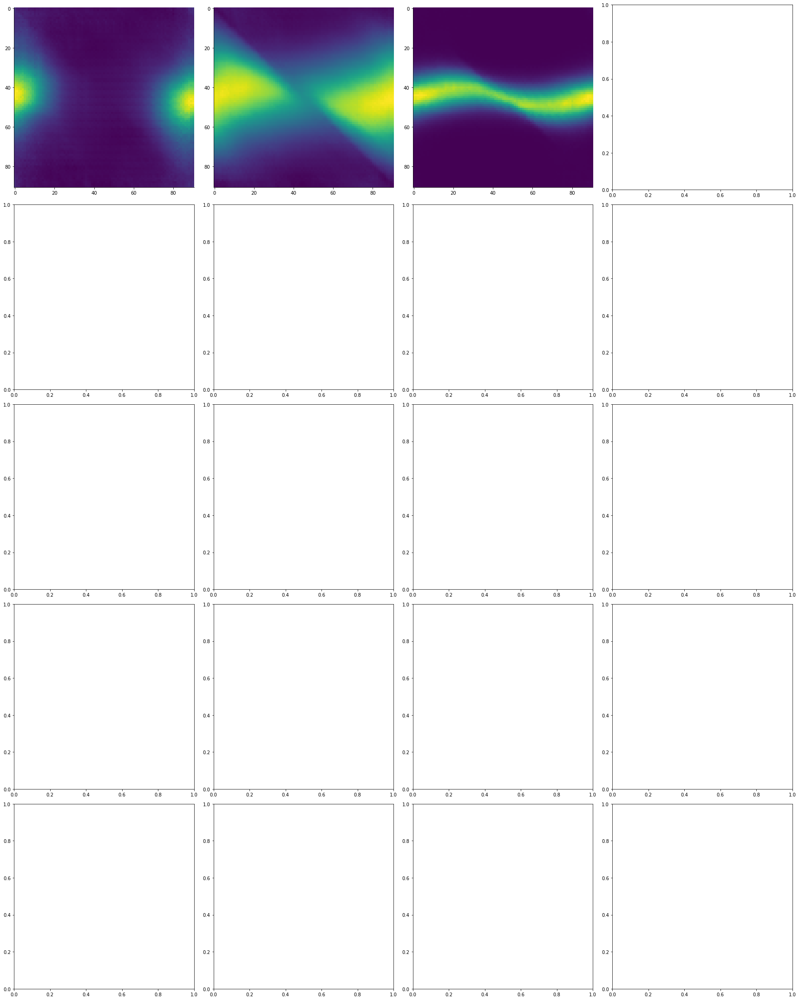

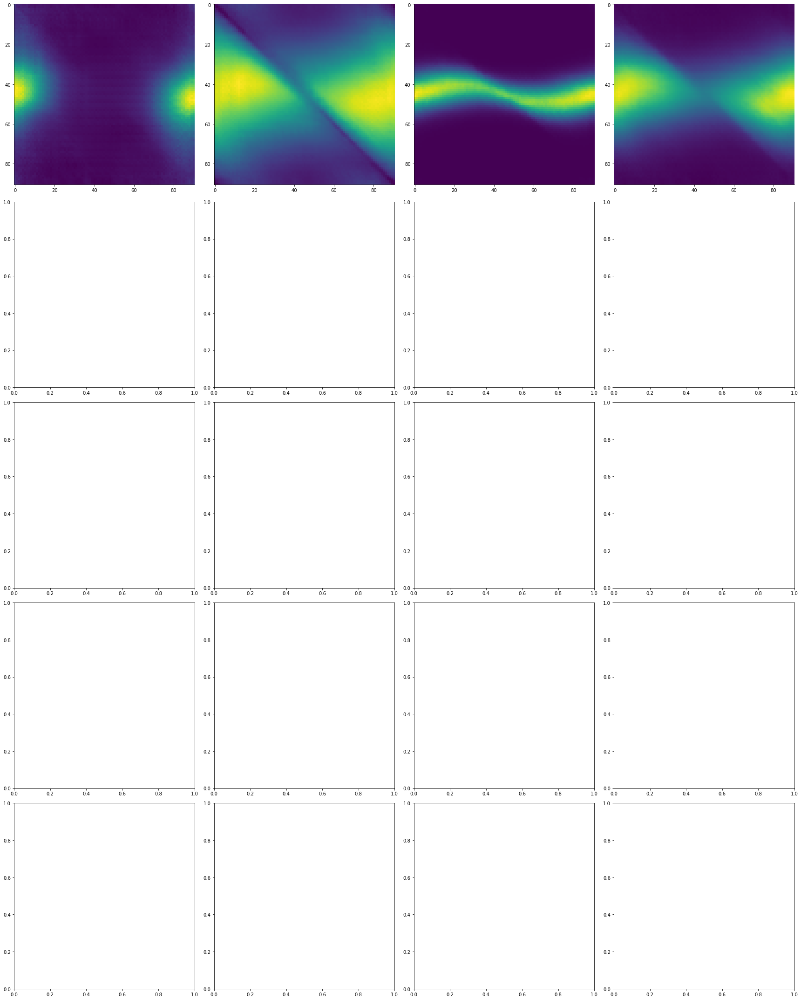

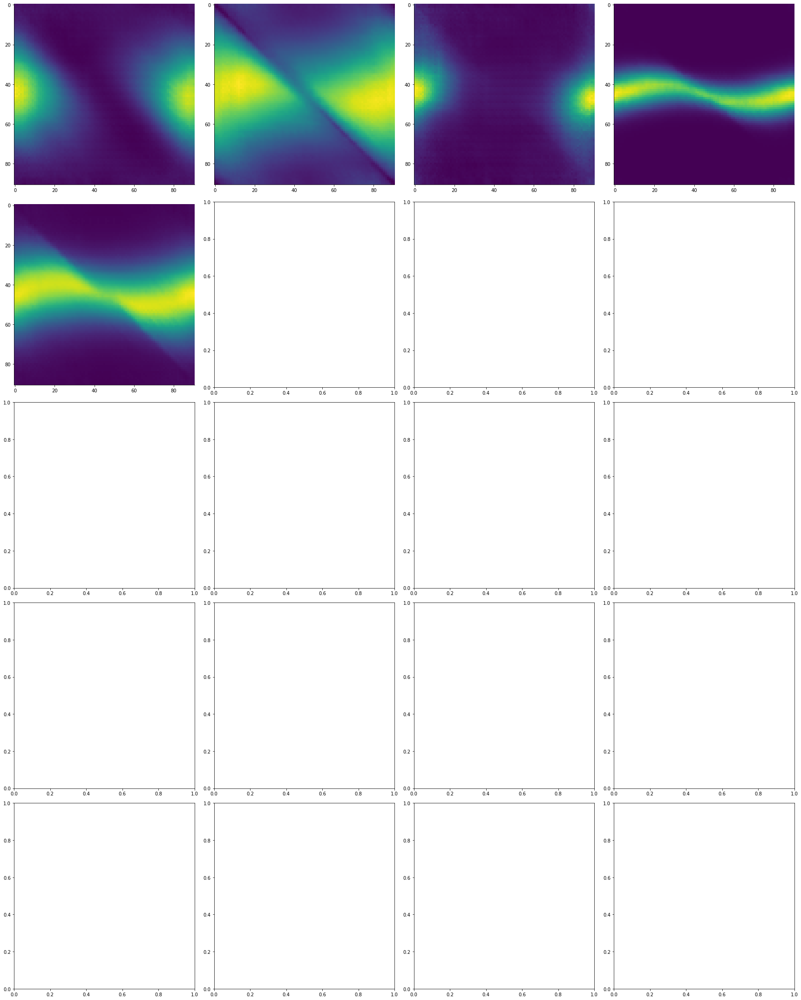

...

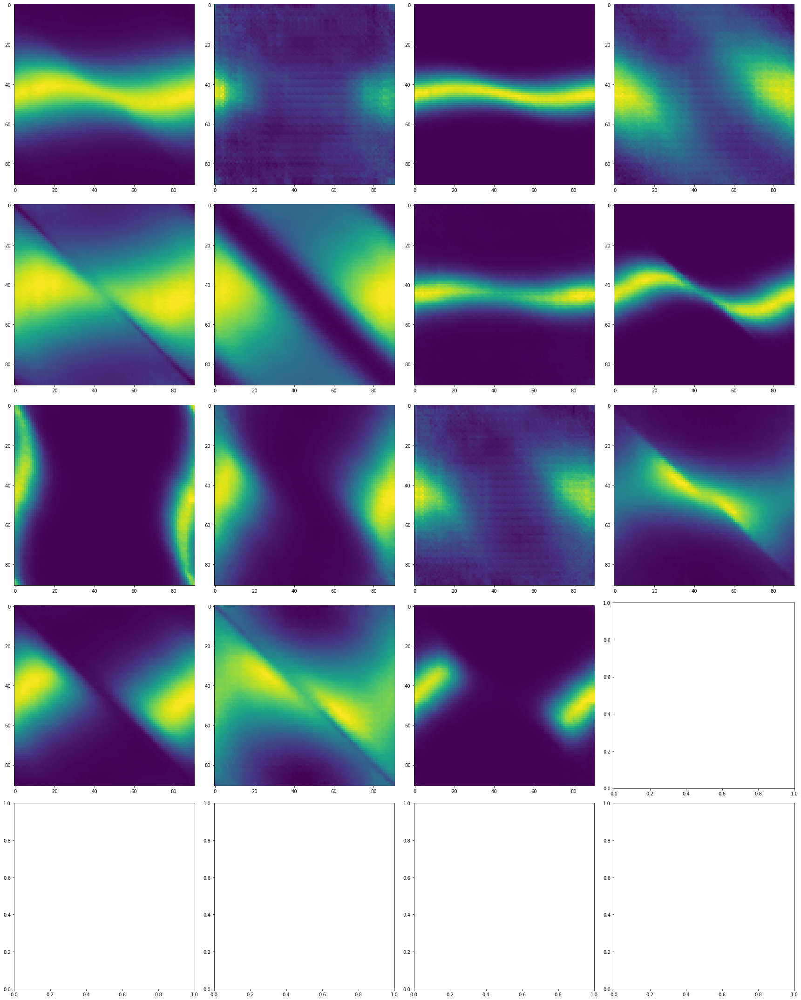

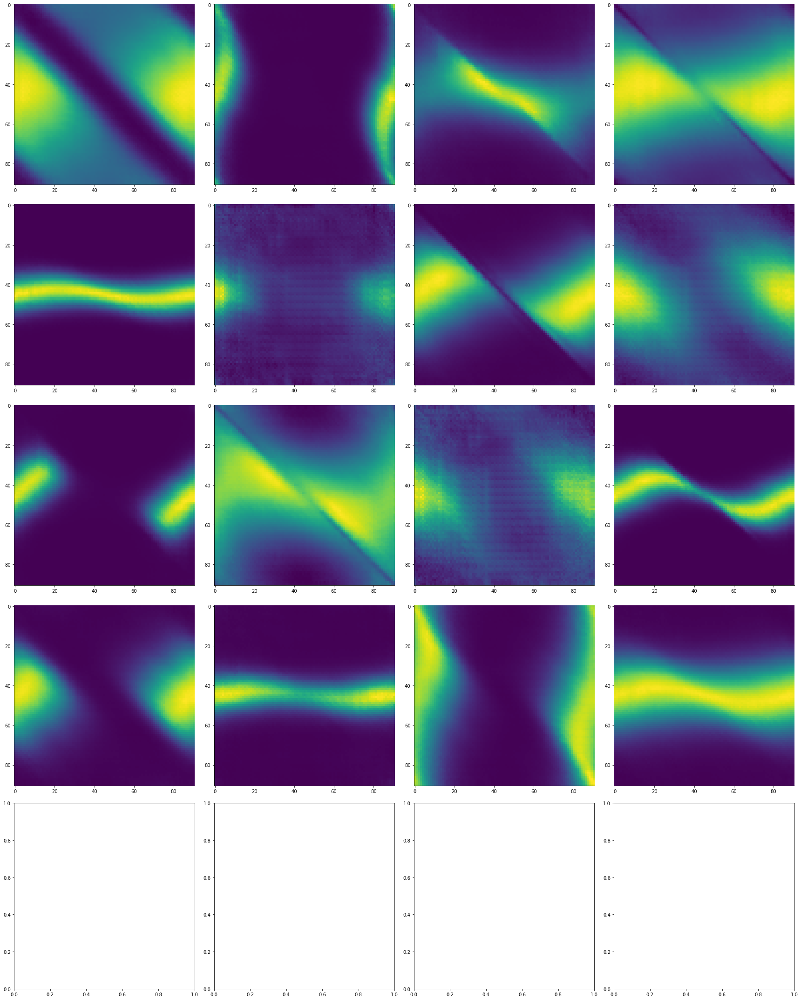

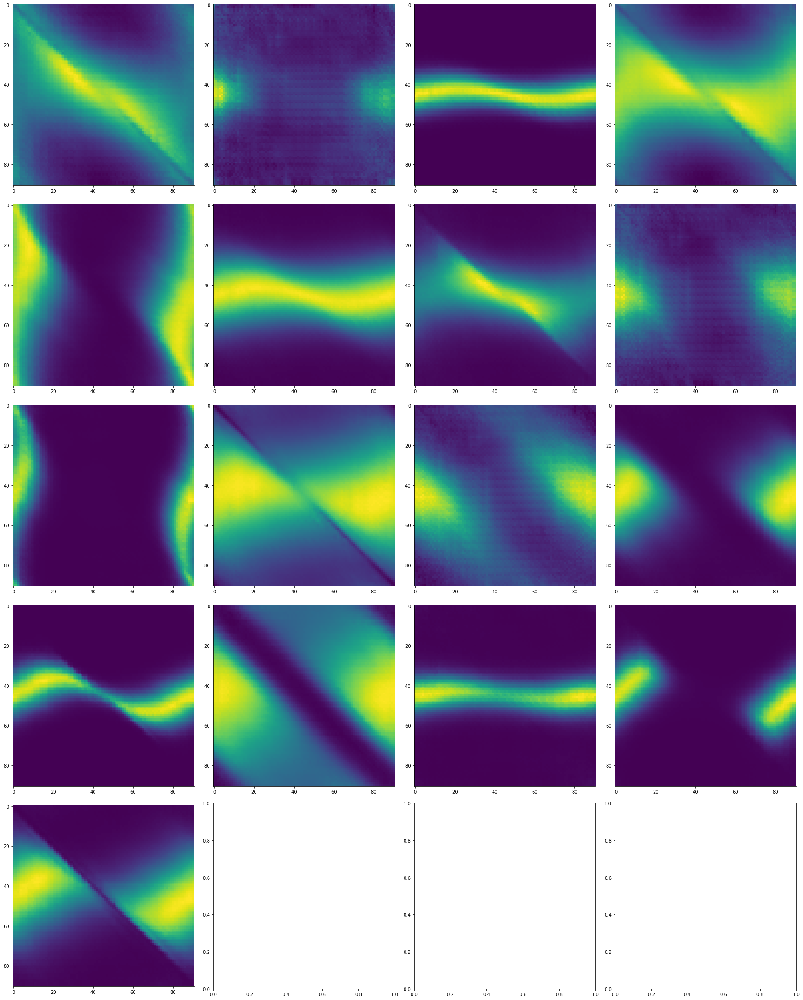

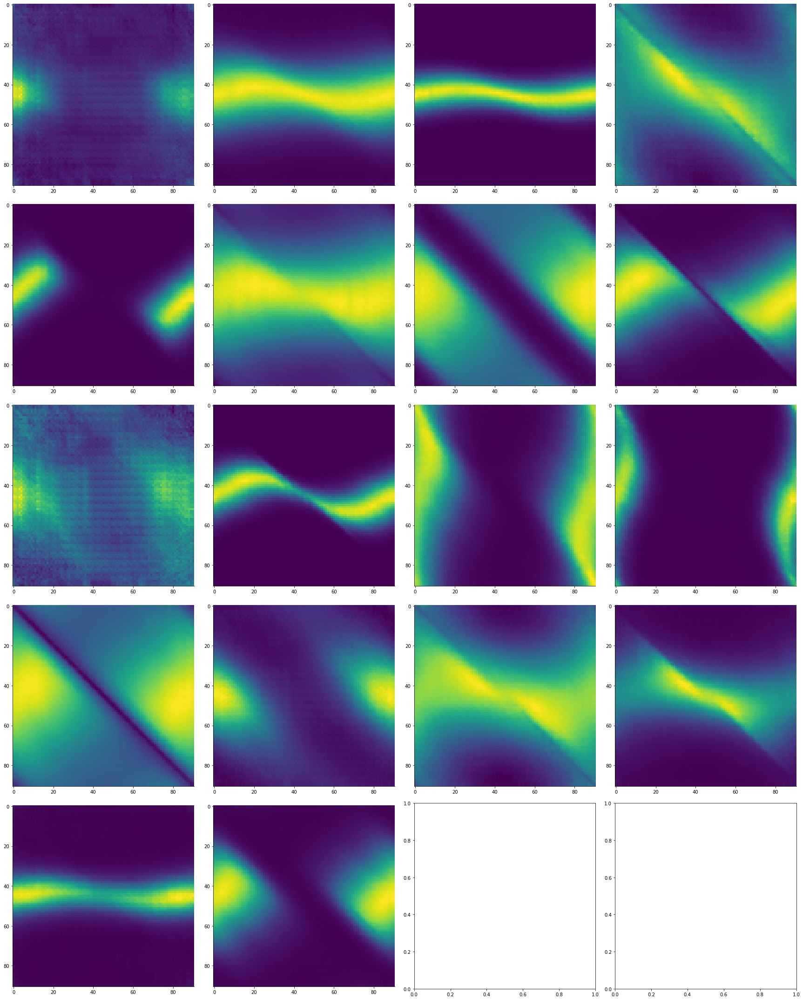

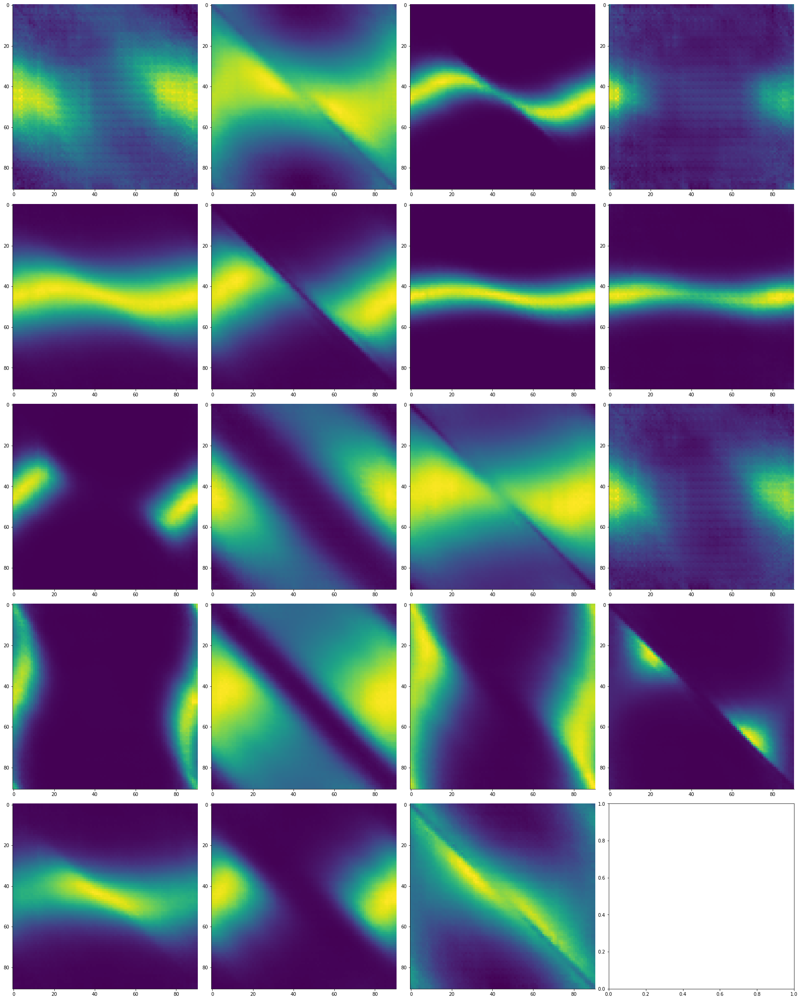

IndexError: list index out of range

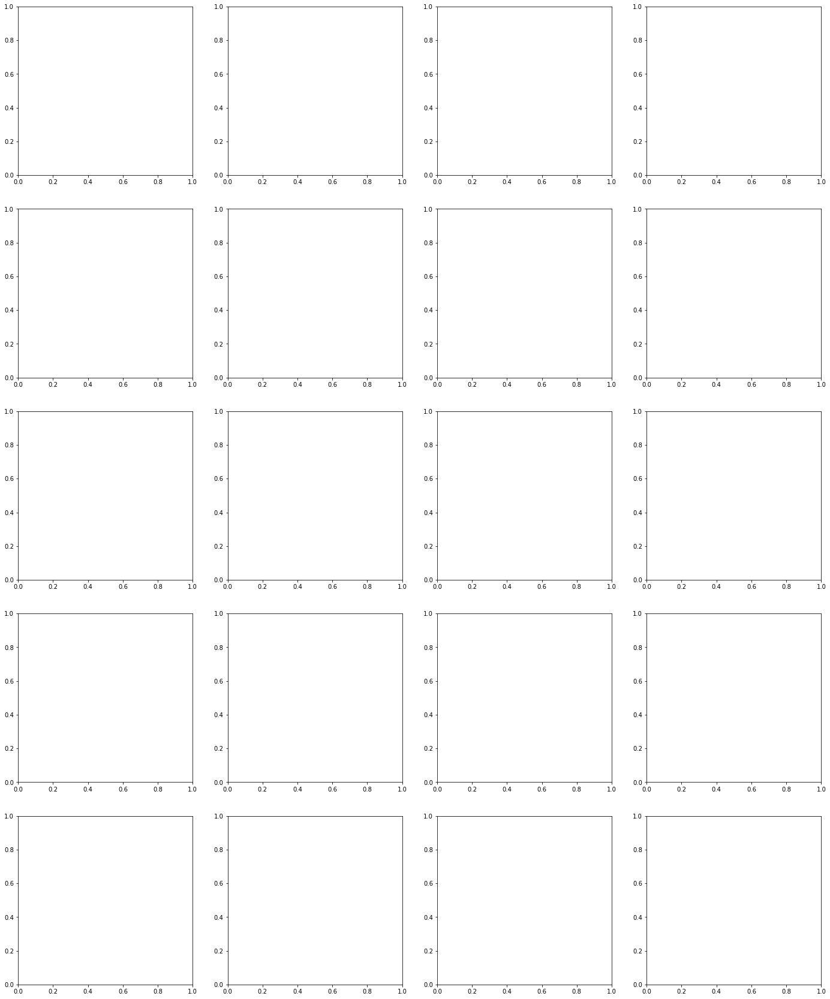

In [ ]:
for i in range(20):
    _, ax = plt.subplots(5, 4, figsize=(figS*4, figS*5))
    ax = ax.ravel()
    for p in range(len(T[i])):
        t = T[i][p]
        ax[p].imshow(t)
        ax[p].spines["top"].set_visible(False)
        ax[p].spines["right"].set_visible(False)
        #ax.spines["left"].set_visible(False)
        #ax.spines["bottom"].set_visible(False)
        #ax.spines["left"].set_visible(False)
        ax[p].grid(False)
        # for label in (ax.get_xticklabels()+ax.get_yticklabels()):
        #     label.set_fontname(f_font1["fontname"])
        #     label.set_fontsize(35)
        #ax.xaxis.set_ticks([-4,0,4])
        #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
        #ax.xaxis.set_ticklabels(["0","0.5","1"], **f_font1)
        #ax.yaxis.set_ticks([-4,0,4])
        #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
        #ax.yaxis.set_ticklabels(["0","0.5","1"], **f_font1)
        #ax.set_xlim(-4.1, 4.1)
        #ax.set_ylim(-4.1, 4.1)
        #plt.tick_params(top=False, bottom=False, left=False, right=False,
        #                labelleft=False, labelbottom=False)
    plt.tight_layout()
    #plt.savefig(sp+"firing_base_pred"+str(mi)+".pdf")
    plt.show()


In [ ]:
len(T)

19

In [ ]:
N = np.zeros((textures.shape[0], len(T), len(T[-1])))
for k in range(textures.shape[0]):
    for i in range(len(T)):
        for j in range(len(T[i])):
            d = np.linalg.norm(textures[k]-T[i][j])
            N[k, i, j] = d

0 0 18.444350068813357


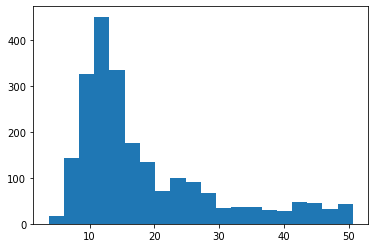

1 0 24.8774598130773


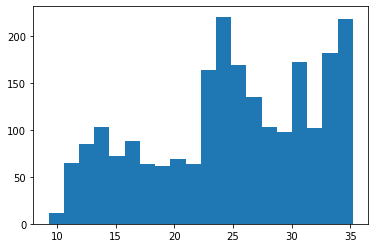

1 1 19.530417586199906


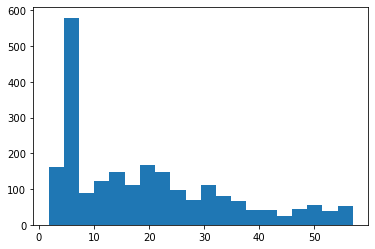

2 0 20.079451944672993


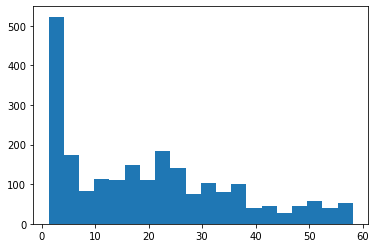

2 1 24.89553766705507


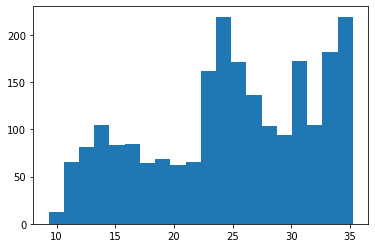

2 2 20.22463445135685


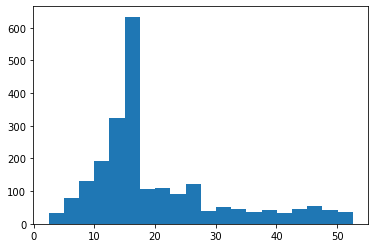

3 0 20.29270195257491


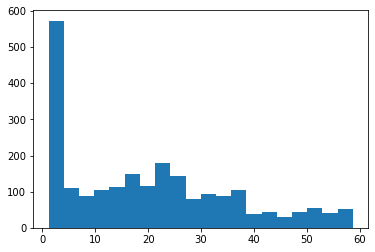

3 1 35.027009470276155


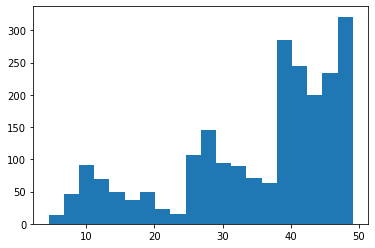

3 2 20.658234996572517


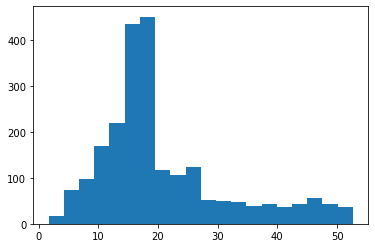

3 3 19.963378021244353


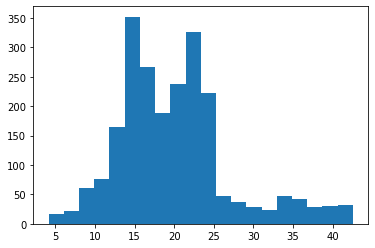

4 0 19.092741777458524


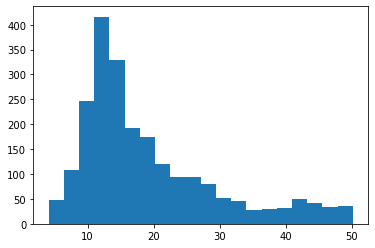

4 1 35.087500491451415


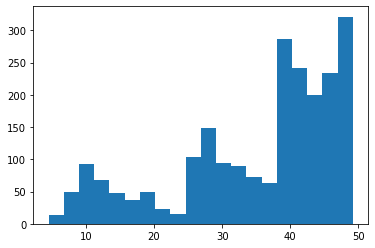

4 2 20.64453580359528


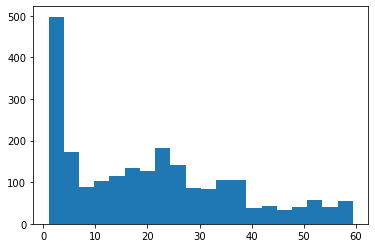

4 3 20.626878609421595


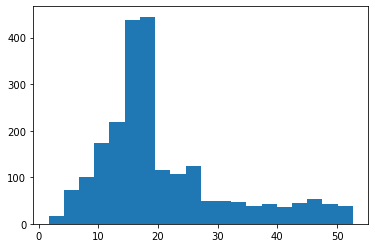

4 4 21.71814326983109


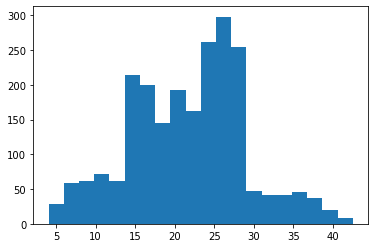

5 0 19.093631474290774


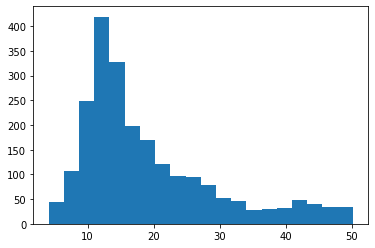

5 1 21.759093346681905


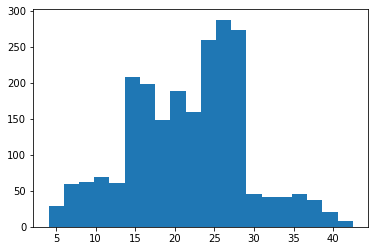

5 2 21.58783417133811


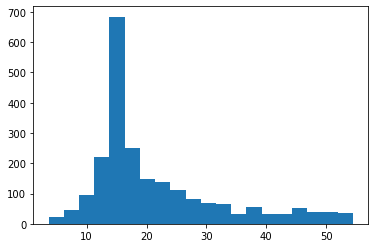

5 3 20.659484081599647


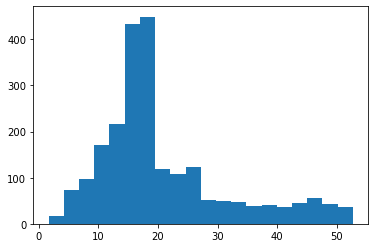

5 4 35.08750043385754


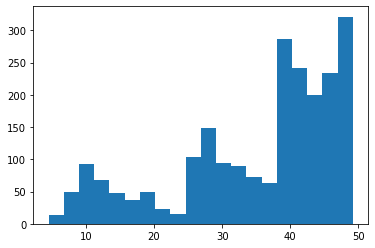

5 5 21.19342970514416


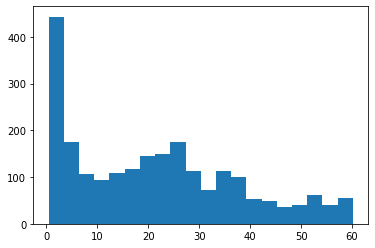

6 0 21.475391730563295


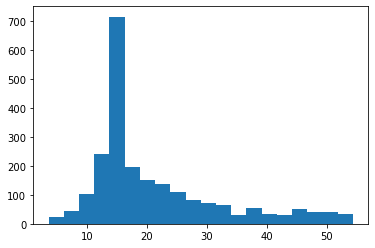

6 1 35.603089082476


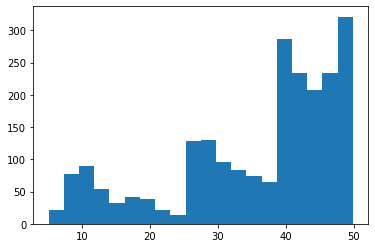

6 2 23.43962439209377


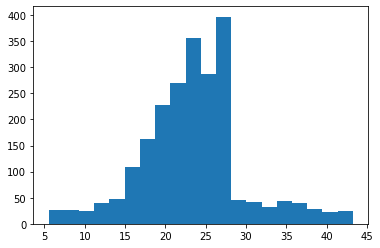

6 3 21.172635609704663


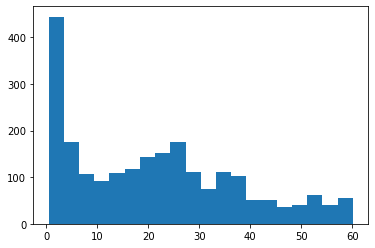

6 4 23.27521187449985


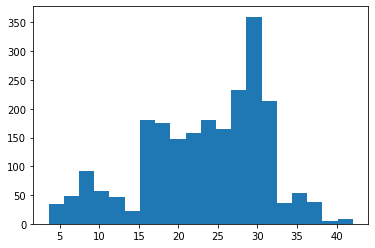

6 5 20.679148977715865


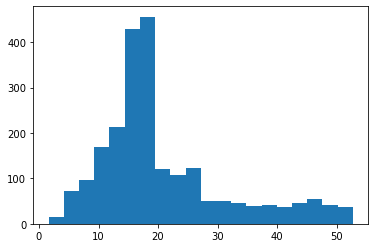

6 6 18.892869401619745


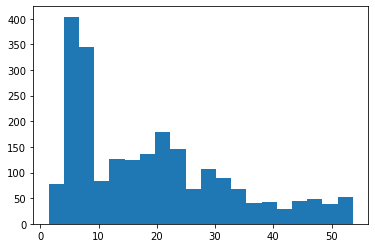

7 0 21.27604982375325


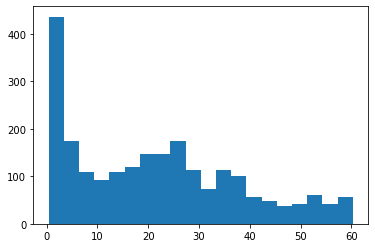

7 1 24.40538604080164


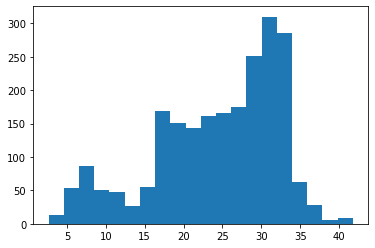

7 2 20.71747652111293


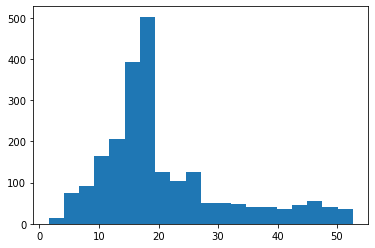

7 3 35.70847630758743


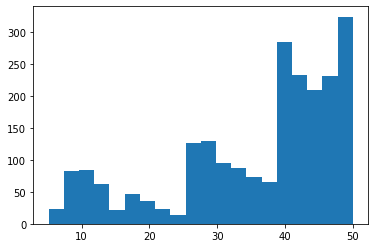

7 4 23.63047355247058


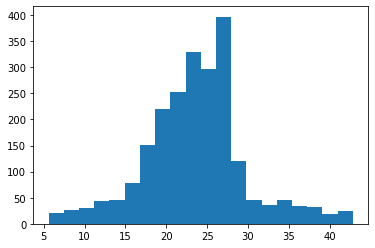

7 5 19.35617077574971


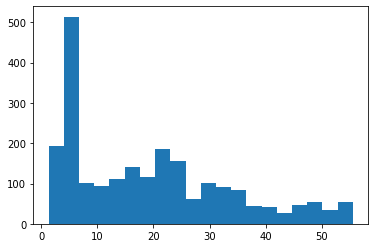

7 6 21.60282434449894


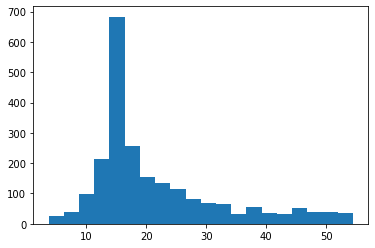

7 7 19.250933333638027


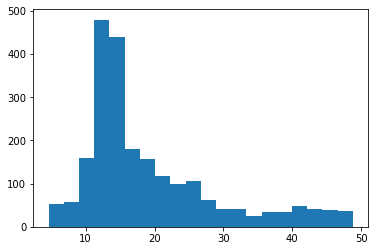

8 0 19.091954730085394


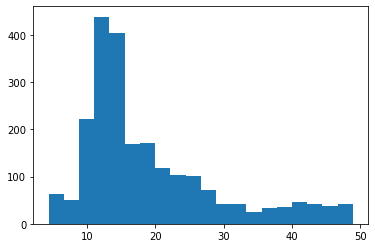

8 1 21.596020614614787


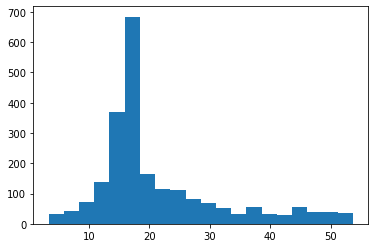

8 2 19.989772655960213


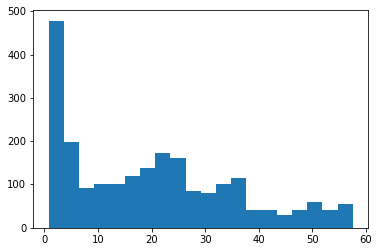

8 3 21.281868608631363


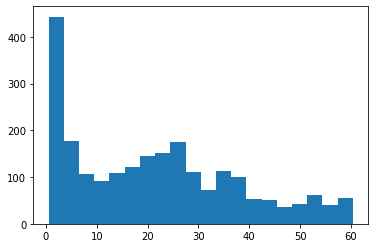

8 4 36.49857383830165


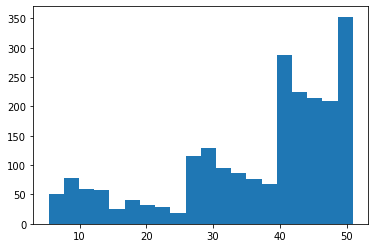

8 5 28.888576535299176


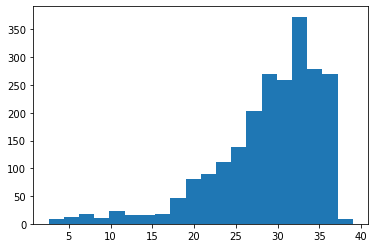

8 6 20.954979887198938


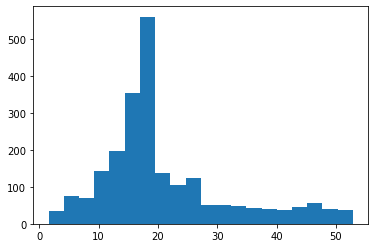

8 7 23.32491197674132


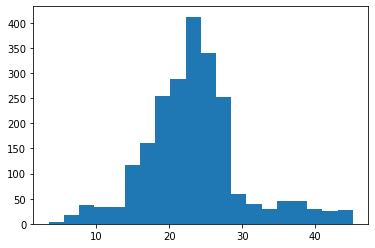

8 8 24.334530555291177


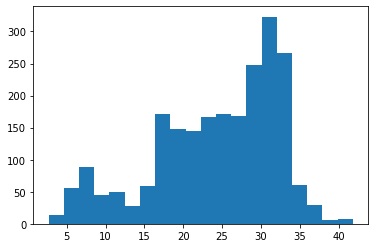

9 0 24.239882526794503


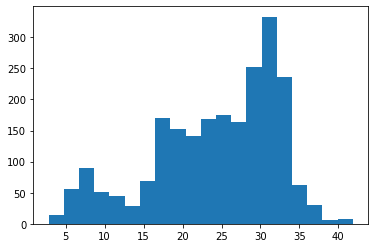

9 1 20.03474681636261


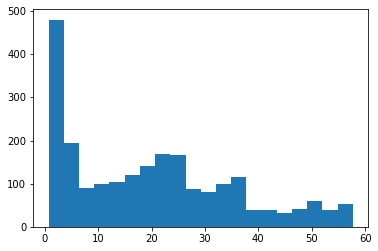

9 2 21.549162409232512


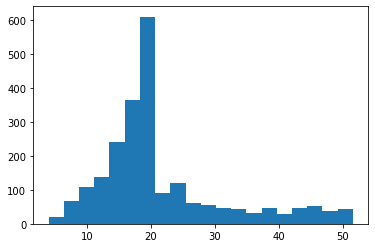

9 3 36.452775244078985


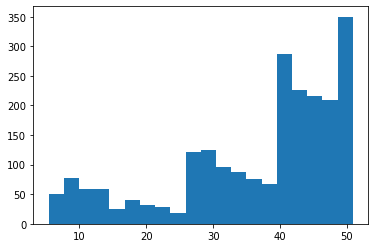

9 4 18.797091863131318


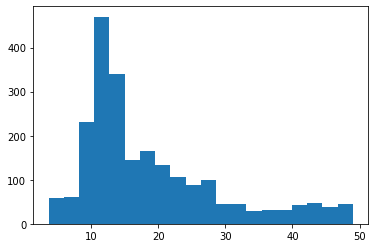

9 5 21.621729109440647


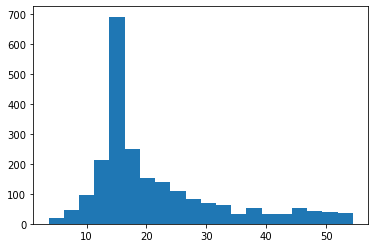

9 6 21.437347381237906


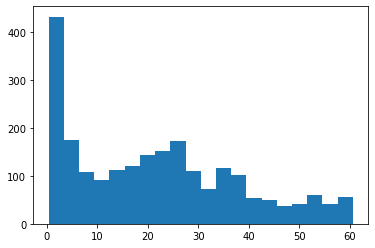

9 7 21.143215365713377


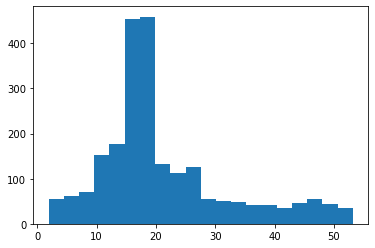

9 8 23.44038087483938


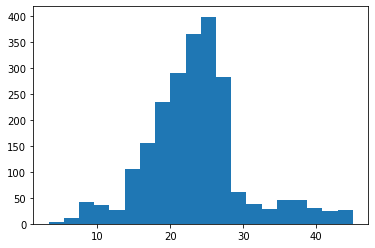

9 9 29.321842951618606


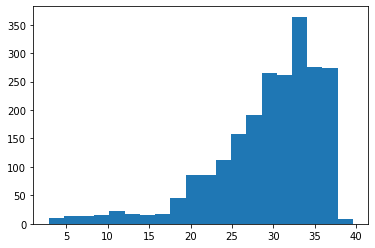

10 0 19.3186771764663


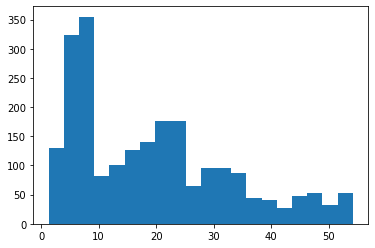

10 1 36.45277517638294


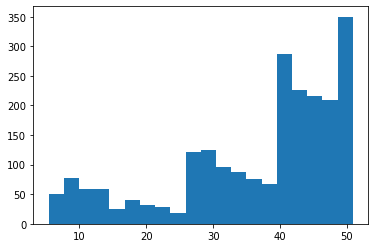

10 2 21.13474602394176


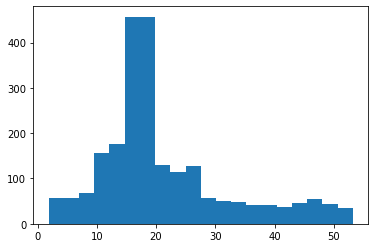

10 3 21.546187402489235


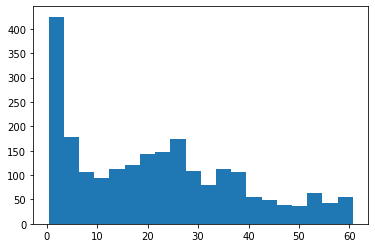

10 4 19.431467188300864


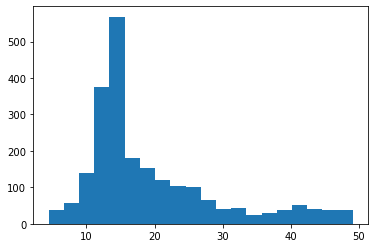

10 5 24.41926952590618


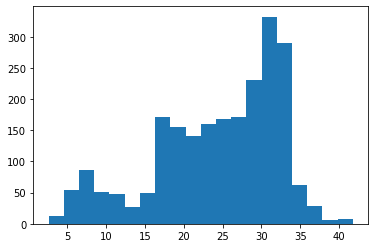

10 6 29.699992669778798


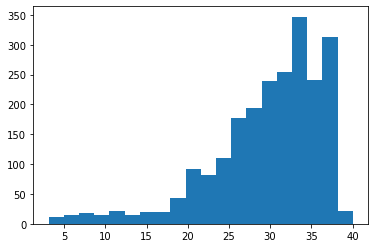

10 7 21.621729125981926


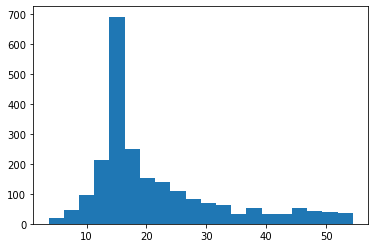

10 8 21.744293615708127


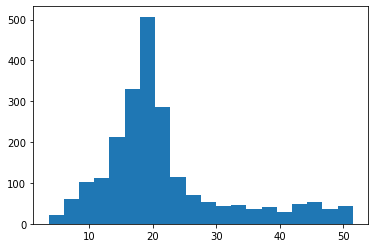

10 9 23.474195278593783


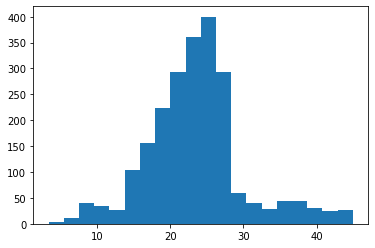

10 10 20.361366677202277


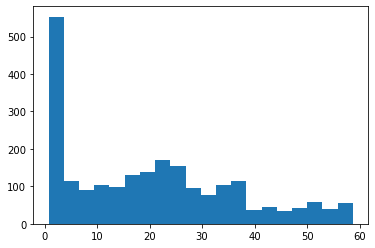

11 0 23.40593054264529


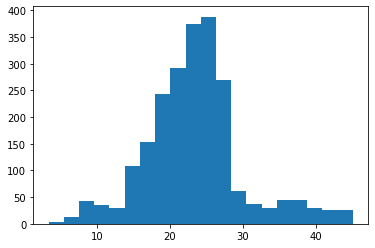

11 1 21.469330059418215


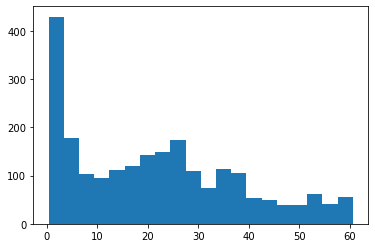

11 2 40.97190920516359


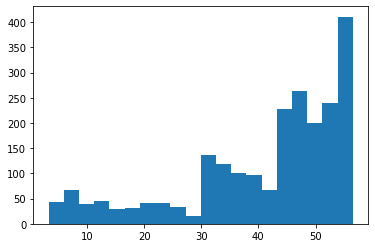

11 3 22.1696052785487


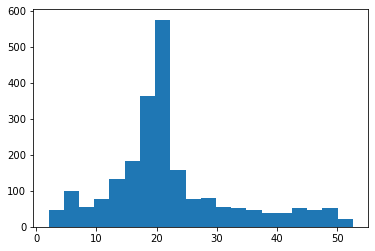

11 4 24.277166590026454


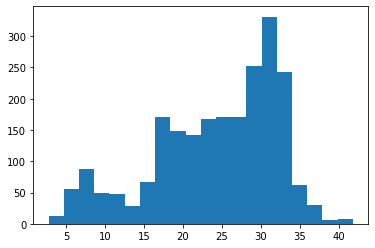

11 5 20.036287571450817


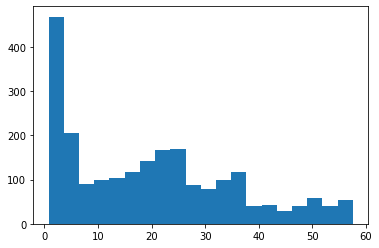

11 6 21.67439672565838


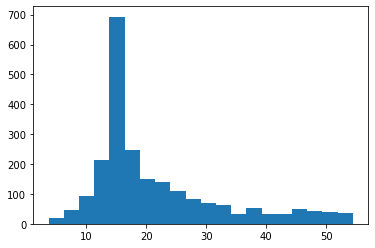

11 7 19.993525185273842


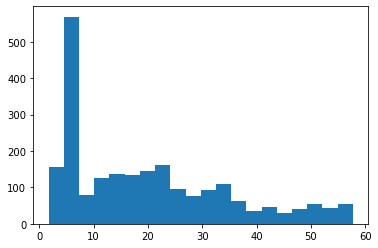

11 8 28.460454418303165


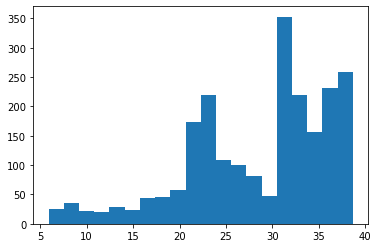

11 9 18.751553824683516


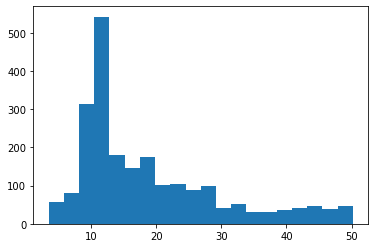

11 10 29.756524476951284


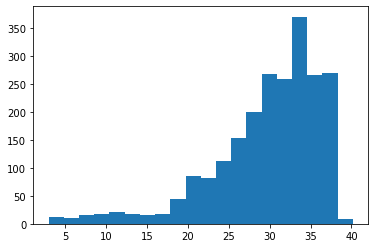

11 11 21.678977962811768


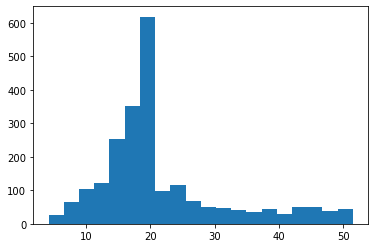

12 0 19.511011387324753


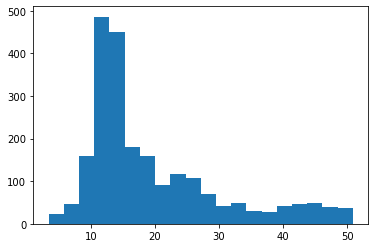

12 1 40.37428629997664


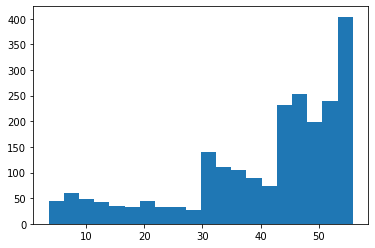

12 2 22.6921302328031


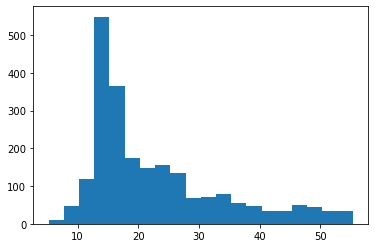

12 3 19.26791824911876


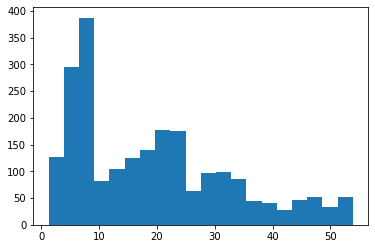

12 4 20.34536182877525


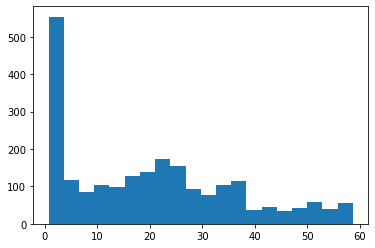

12 5 21.134746029650675


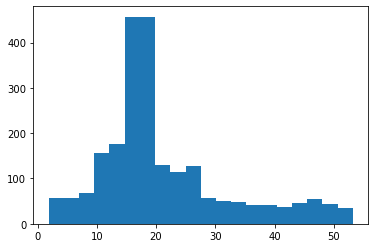

12 6 21.590531299356403


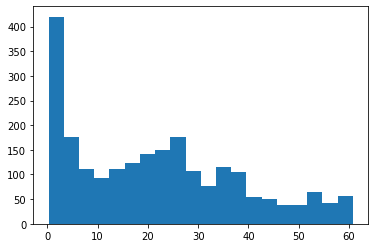

12 7 21.794369623523476


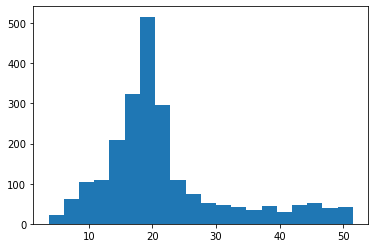

12 8 24.434116251474666


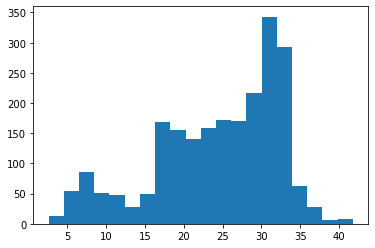

12 9 30.699557178929894


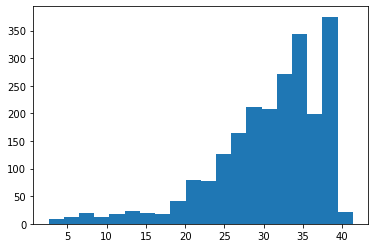

12 10 23.474195219662032


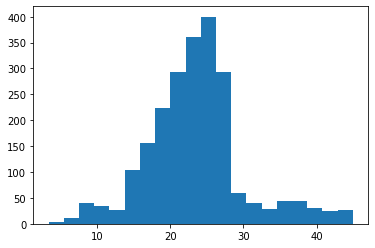

12 11 21.759100088886548


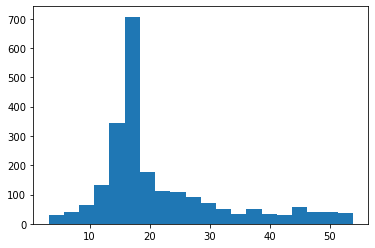

12 12 26.560101734165013


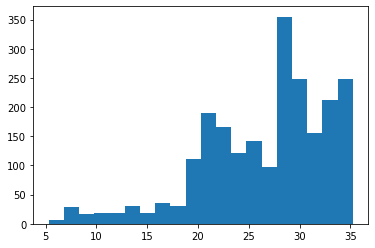

13 0 28.750628960015757


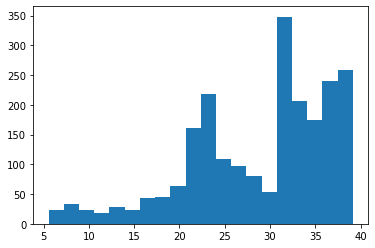

13 1 22.336919721030878


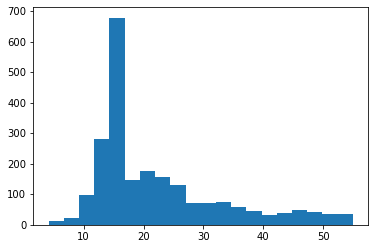

13 2 18.969093060508087


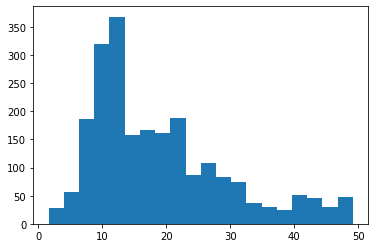

13 3 30.799811837402057


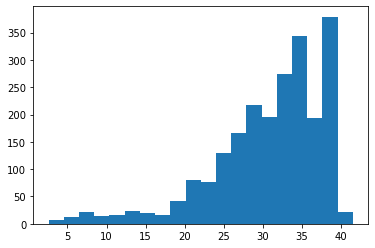

13 4 24.434104560830257


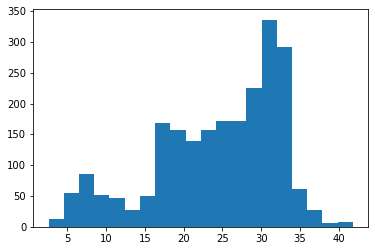

13 5 19.873807133486153


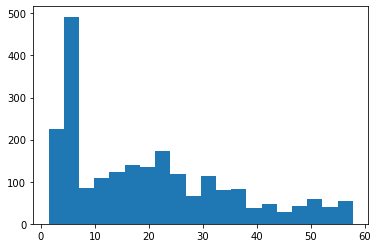

13 6 20.496021469897432


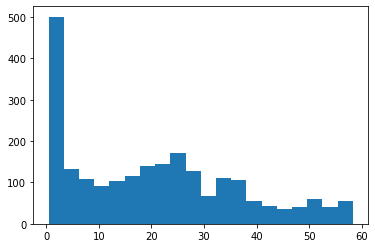

13 7 19.482595487129


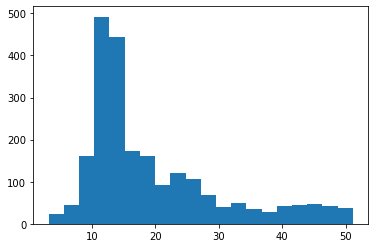

13 8 20.794049762224876


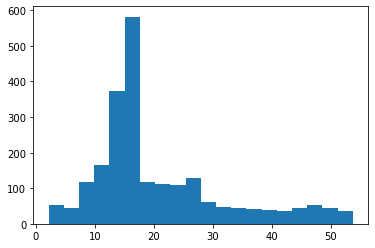

13 9 23.531389367949444


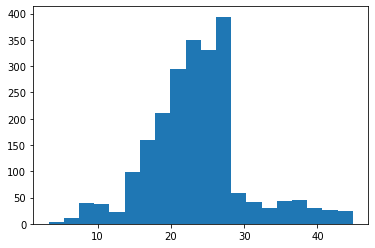

13 10 21.704580861264883


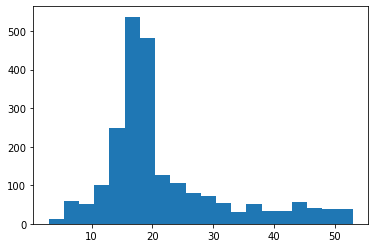

13 11 41.02802281542389


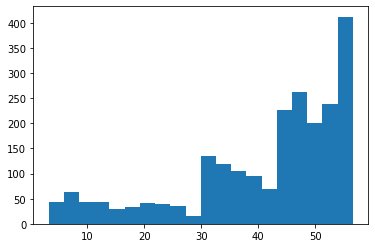

13 12 22.07794317011779


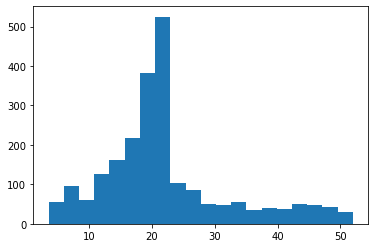

13 13 21.63670216387806


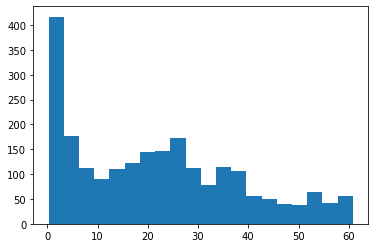

14 0 24.748275264415852


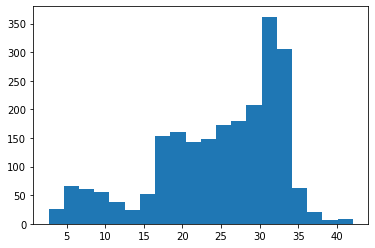

14 1 21.60095275824897


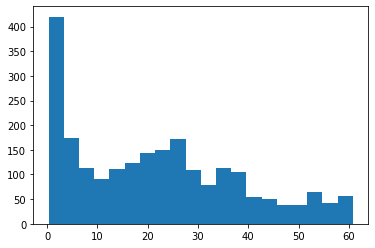

14 2 22.171985993515253


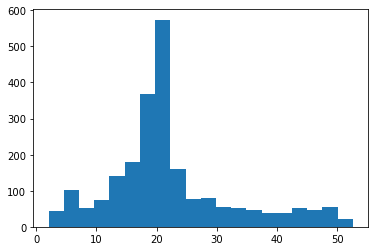

14 3 19.27253498354993


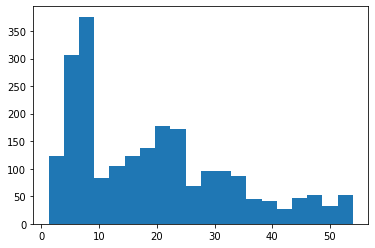

14 4 40.81343422363899


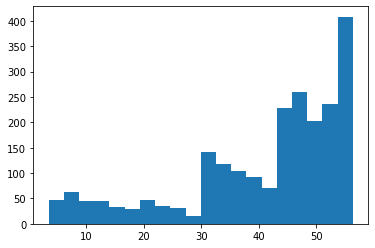

14 5 30.59103293947673


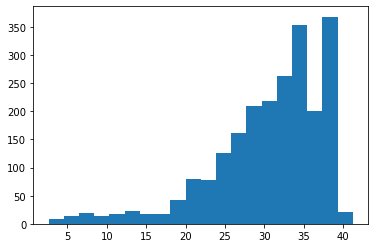

14 6 19.998086464000387


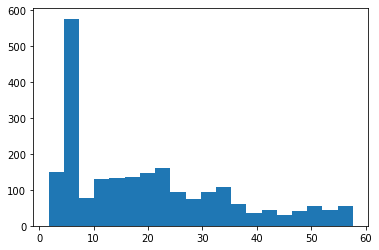

14 7 21.748480011323146


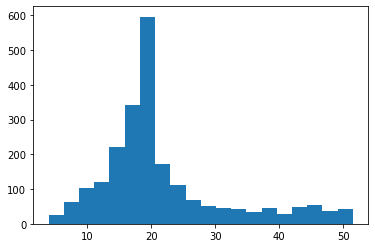

14 8 23.311507769569804


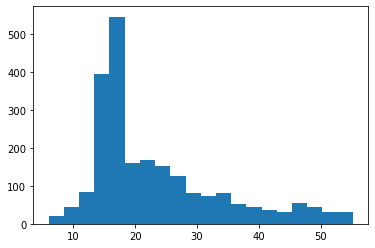

14 9 22.764189533621376


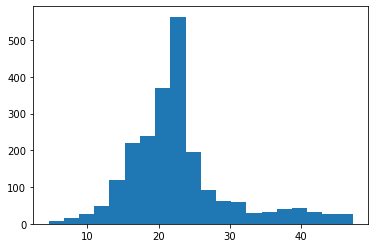

14 10 20.51835344856739


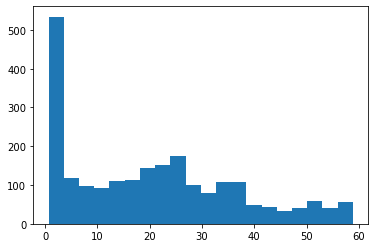

14 11 19.536503047976552


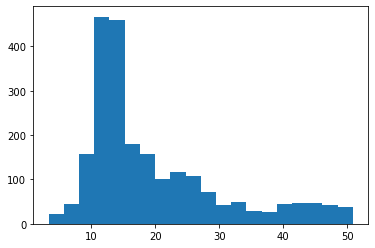

14 12 24.134685315609012


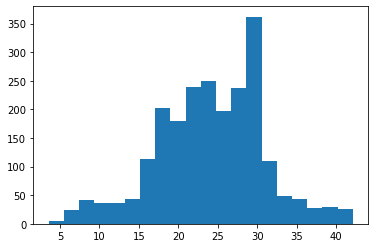

14 13 27.242637479651485


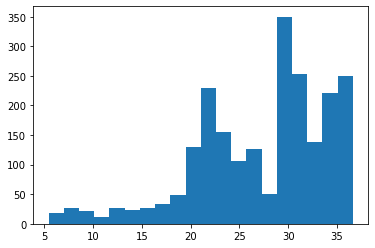

14 14 21.644332804467012


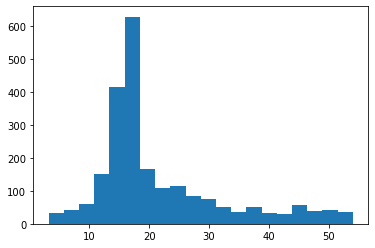

15 0 30.893959127058313


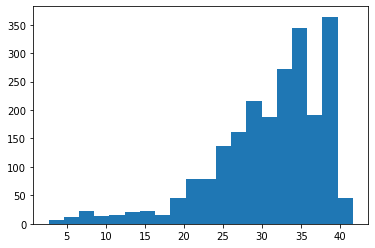

15 1 22.584092255437525


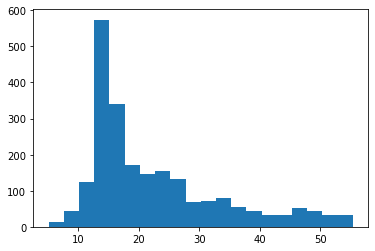

15 2 19.5413108182467


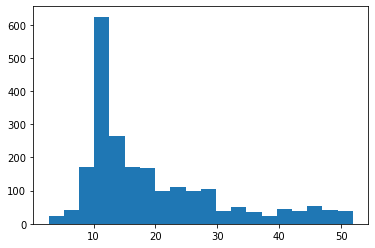

15 3 41.02802283453678


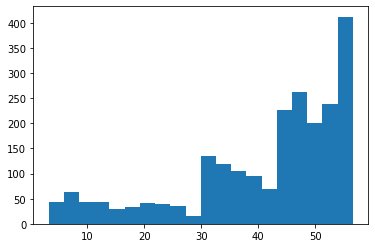

15 4 22.171986002865385


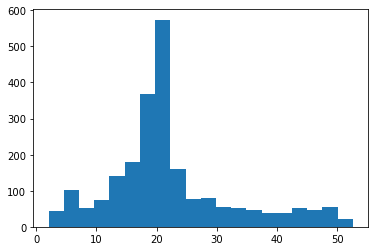

15 5 21.52401221123862


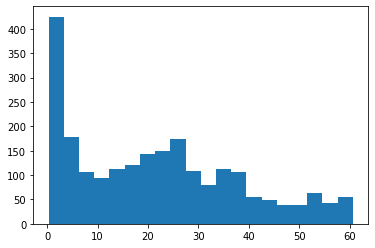

15 6 24.821994227907556


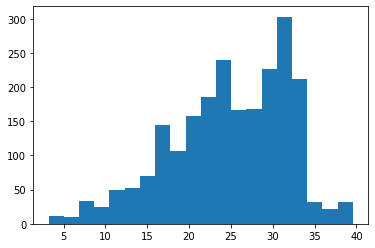

15 7 18.986953103902213


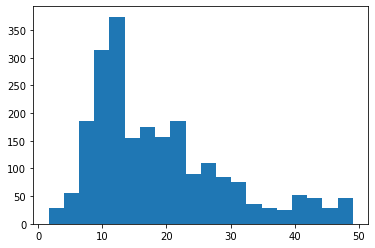

15 8 21.803710400575387


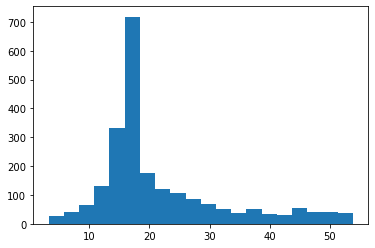

15 9 28.750628992412672


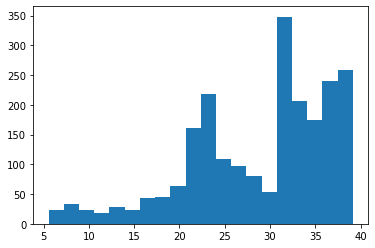

15 10 20.325062387995306


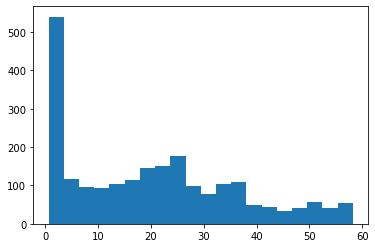

15 11 21.748480004162605


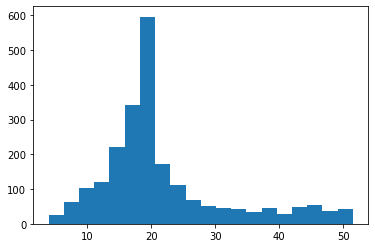

15 12 21.99337817758282


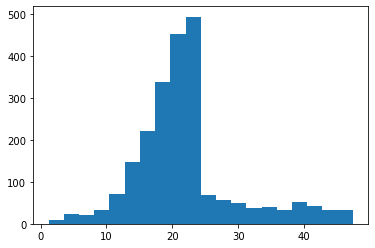

15 13 19.99385048666597


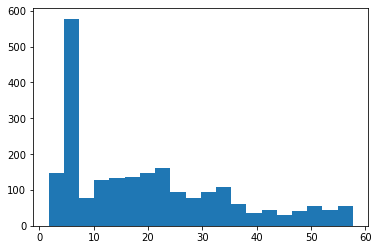

15 14 28.23262849680466


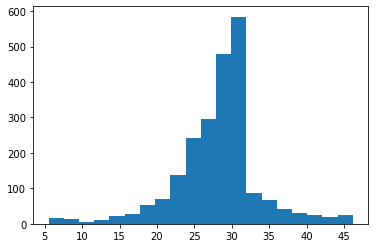

15 15 24.729341985208748


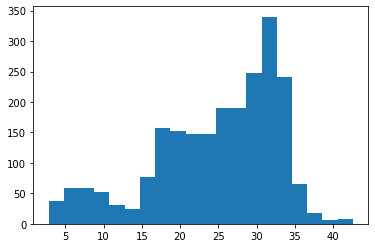

16 0 20.728986251374817


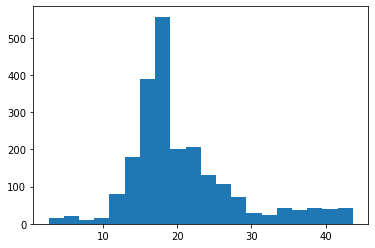

16 1 21.600166633184507


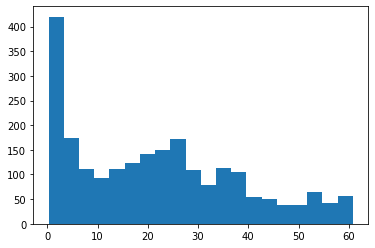

16 2 22.190726372972463


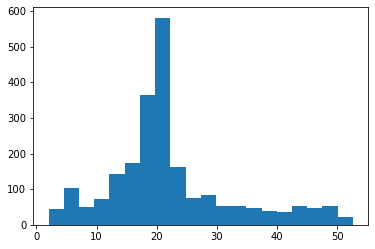

16 3 30.666370883656263


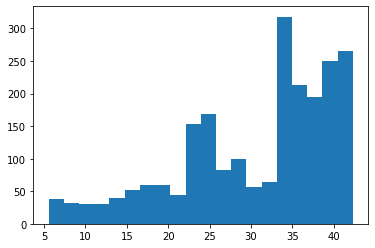

16 4 28.90475521769426


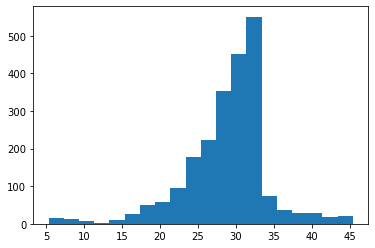

16 5 24.761250276091225


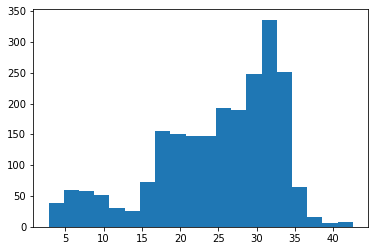

16 6 19.38181947510985


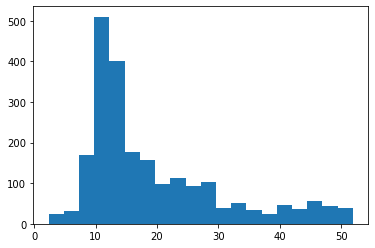

16 7 20.503481242684707


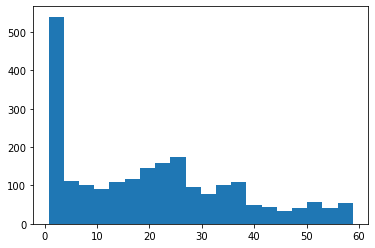

16 8 23.011296427721494


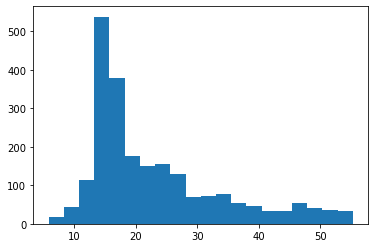

16 9 41.41358489413077


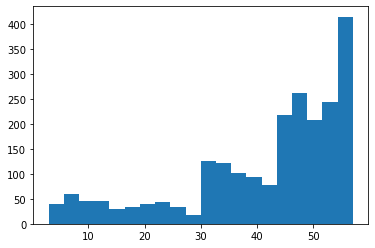

16 10 19.399898400176962


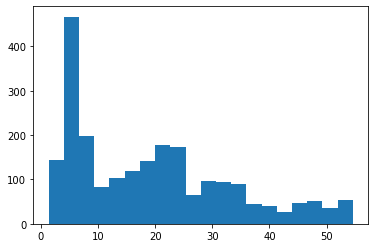

16 11 21.923475888341628


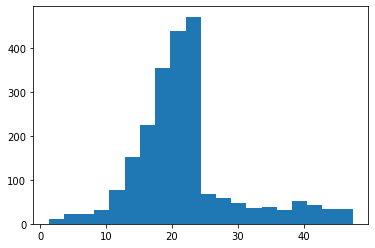

16 12 21.748480047042992


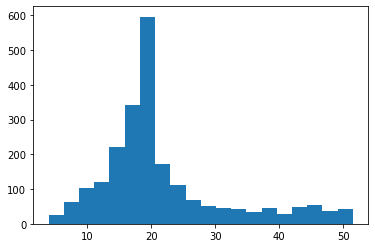

16 13 30.591032902443665


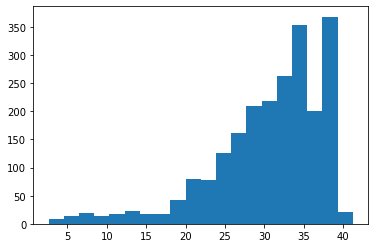

16 14 20.010995724233577


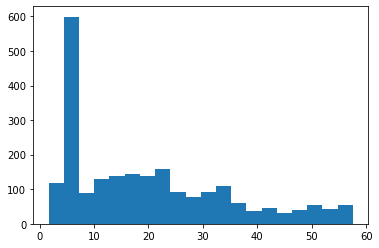

16 15 21.703682532825834


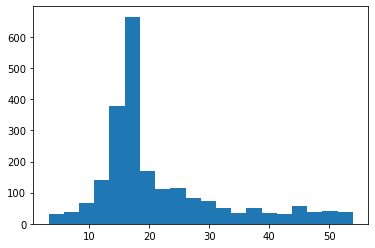

16 16 24.82199422699195


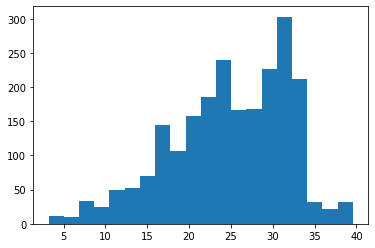

17 0 21.525340328214156


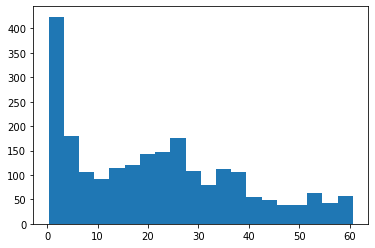

17 1 24.751061059252397


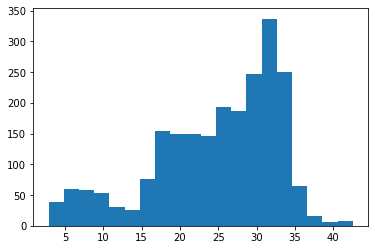

17 2 22.152854104371826


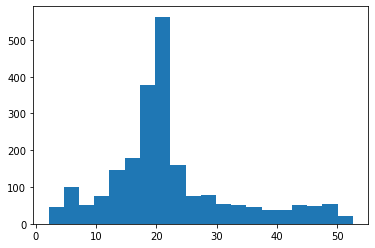

17 3 20.500336251546504


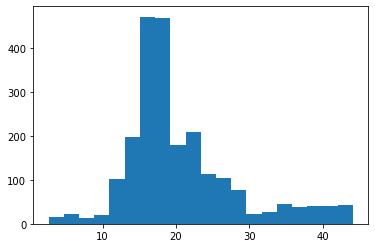

17 4 21.80371036297776


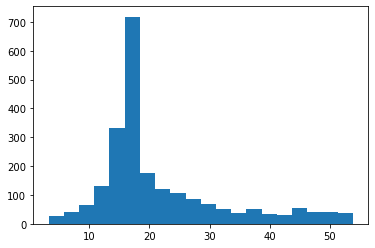

17 5 42.31182050341452


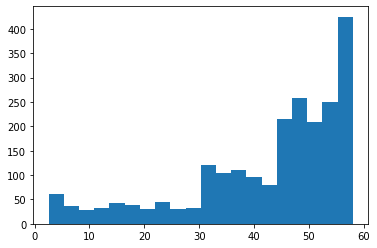

17 6 28.91044594513955


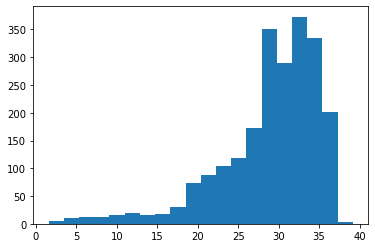

17 7 25.208079681627627


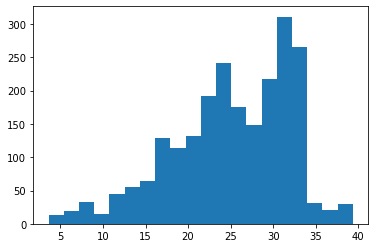

17 8 20.602012768376397


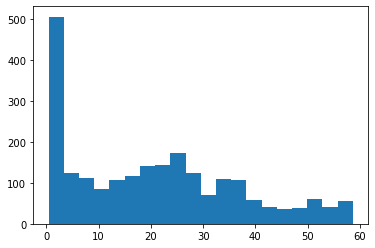

17 9 21.748480023994176


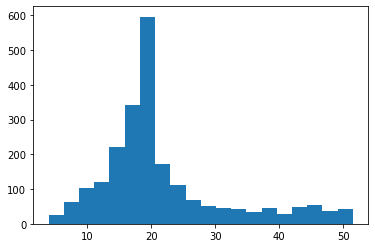

17 10 28.150711338002655


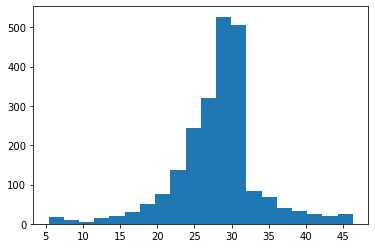

17 11 22.584092224557704


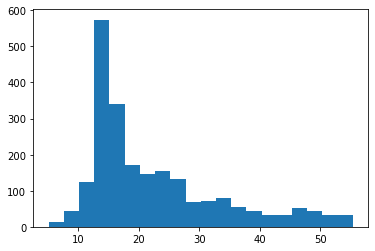

17 12 37.57265487297777


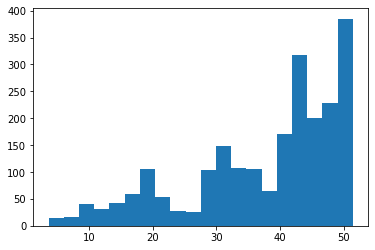

17 13 19.189811299330554


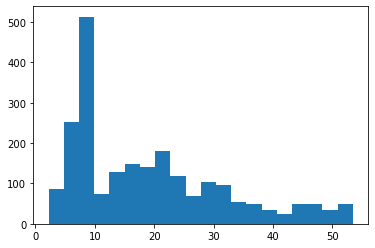

17 14 30.143765777937304


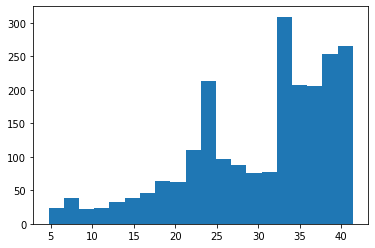

17 15 19.319124686634932


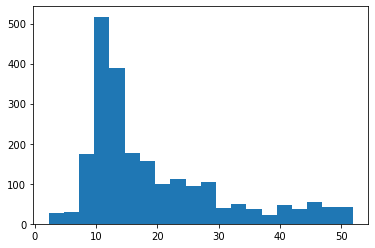

17 16 20.0007648132828


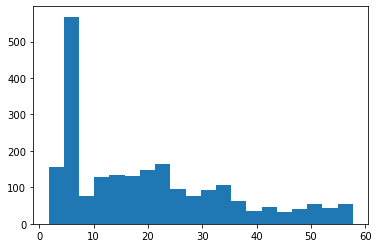

17 17 22.39631018899113


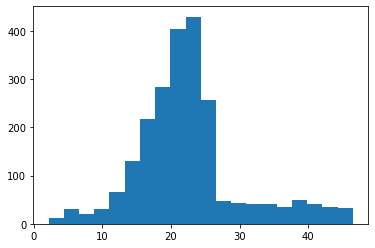

18 0 19.636261605890642


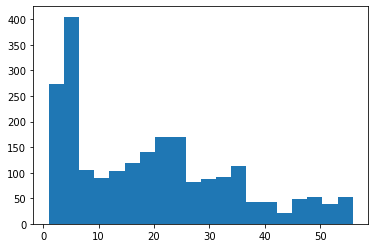

18 1 30.414532826711508


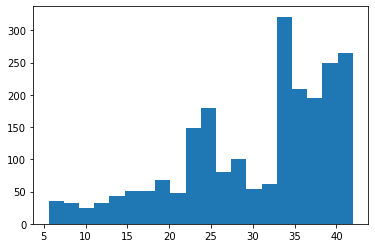

18 2 21.74847996585993


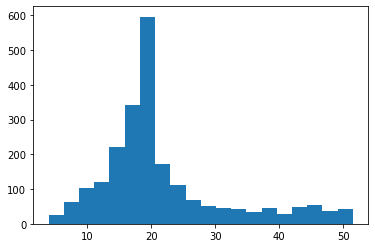

18 3 21.60259828926123


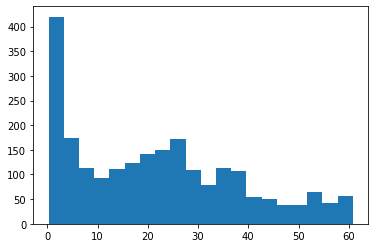

18 4 24.923833177054444


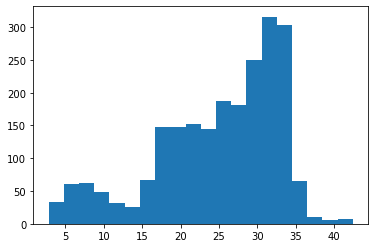

18 5 24.907417777595647


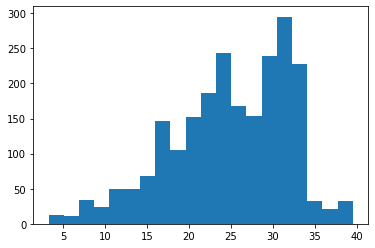

18 6 22.190726346911227


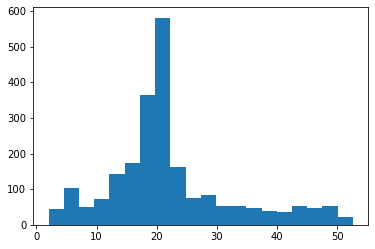

18 7 20.002472305722417


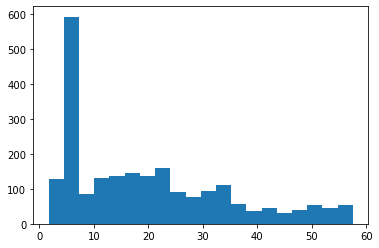

18 8 22.04627674496858


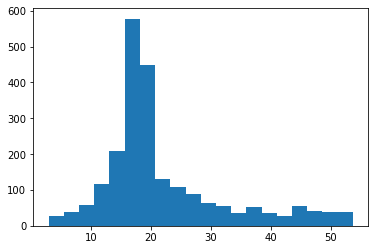

18 9 21.917173936521746


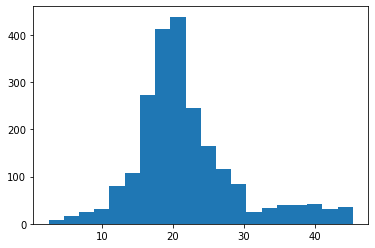

18 10 41.37152316098554


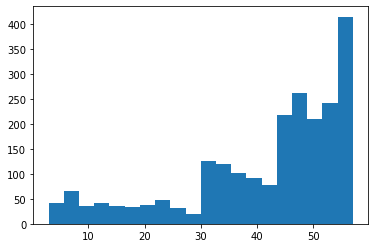

18 11 20.51987394227552


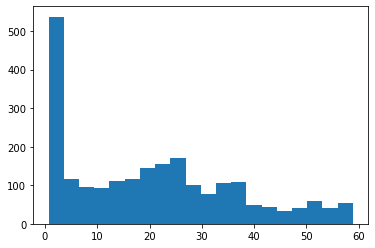

18 12 22.69213023025933


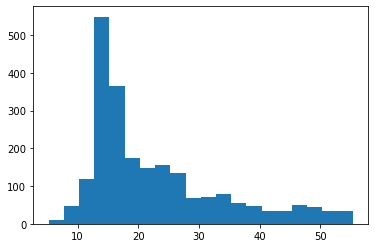

18 13 33.23890486639316


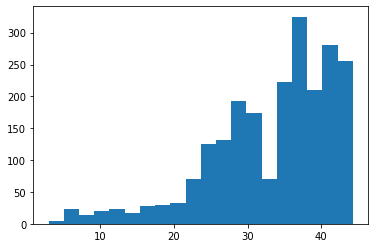

18 14 29.036374782296466


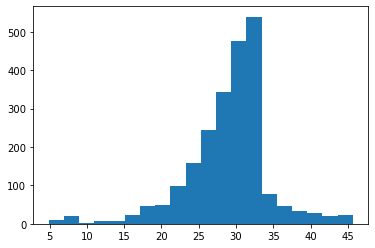

18 15 23.884570808902183


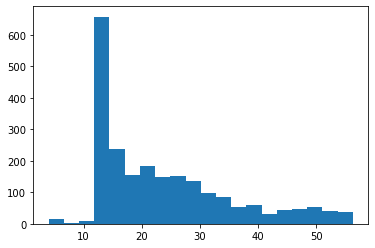

18 16 19.174062380861315


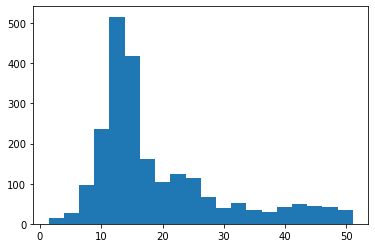

18 17 21.96676590520764


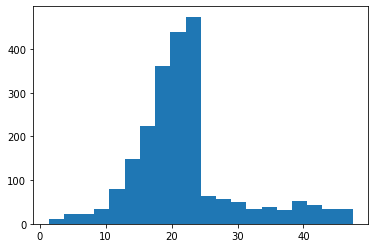

18 18 20.888322624830632


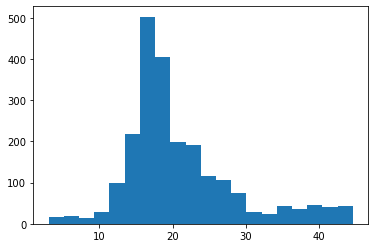

In [ ]:
for i in range(len(T)):
    for j in range(len(T[i])):
        print(i,j,np.mean(N[:,i,j]))
        plt.hist(N[:,i,j], bins=20)
        plt.show()

Speed: 7cps
direction: center=0, surround= -125


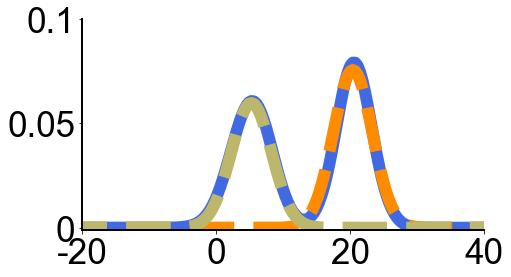

20.360360360360346 5.225225225225216


In [ ]:
l = dir_post.shape[1]
xtck = [0,int(np.round(l/4)),int(np.round(l/2)),int(np.round(l*3/4)),int(np.round(l))]
xtckL = ["-90","-45","0","45","90"]
ytck = [-20,0,20,40]
ytckL = ["-90","-45","0","45","90"]
x_eval = np.linspace(-180, 180, num=1000)
deg45 = int(np.round(l/2))
x = np.arange(2,l-2,4)
xL = [str(round(i)) for i in x*360/l-180]
_, ax = plt.subplots(1, 1, figsize=(figS*1.2, figS*.66))
kde = gaussian_kde(dir_post[:,deg45,x[3],2,2,1])
print("Speed: 7cps")
print("direction: center=0, surround=", xL[3])
Y = kde(x_eval)
X = x_eval.copy()
ax.plot(X,Y,  color="royalblue", linewidth=line_w+10)
yy = norm.pdf(x_eval, loc=X[np.argmax(Y)], scale=2.9)
ax.plot(X,yy*0.55, "--", color="darkorange", linewidth=line_w+10)
yy = norm.pdf(x_eval, loc=X[np.argmax(Y[:550])], scale=3.)
ax.plot(X,yy*0.45, "--", color="darkkhaki", linewidth=line_w+10)
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
ax.spines["left"].set_linewidth(line_w)
ax.spines["bottom"].set_linewidth(line_w)
ax.spines["left"].set_linewidth(line_w)
ax.grid(False)
for label in (ax.get_xticklabels()+ax.get_yticklabels()):
    label.set_fontname(f_font1["fontname"])
    label.set_fontsize(35)
ax.xaxis.set_ticks(ytck)
ax.yaxis.set_ticks([0,0.05, 0.1])
ax.xaxis.set_ticklabels(ytck)
ax.set_xlim(-20, 40)
ax.set_ylim(-0.001, 0.1)
ax.yaxis.set_ticklabels([0,0.05, 0.1])
#ax.set_xlabel(" ")
#ax.set_ylabel(L[i], **f_font2)
plt.tight_layout()
plt.savefig(sp+"1PostDir_mix_subj2_rel.pdf")
plt.show()
print(X[np.argmax(Y)],X[np.argmax(Y[:550])])

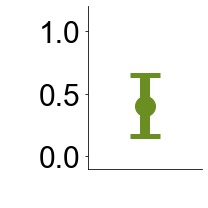

In [ ]:
_, ax = plt.subplots(1, 1, figsize=(figS*0.5, figS*0.5))
axins = ax
axins.set_xlabel(" ", **f_font1)
axins.xaxis.set_ticks([ ])
axins.set_ylim([-0.1,1.2])
axins.yaxis.set_ticks([0,0.5,1])
y = 0.5*(0.9999997527657009*0.7992650300262982)+0.5*(0.014605305925411264*0.6659689207434096)
ye = (0.5*(0.15219079588881168+0.24989533811151143)+0.5*(0.2999999629148551+0.2698897545039447))/2
axins.errorbar(1,y, yerr=np.array([[ye],[ye]]), fmt='-o', color=c[1], capsize=15, capthick=5, markersize=20, linewidth=line_w+8)
axins.spines["right"].set_visible(False)
axins.spines["top"].set_visible(False)
#axins.spines["bottom"].set_visible(False)
axins.grid(False)
axins.set_ylabel(" ", **f_font1)
#axins.yaxis.set_ticklabels([])
for labl in (axins.get_xticklabels()+axins.get_yticklabels()):
        labl.set_fontname(f_font1["fontname"])
        labl.set_fontsize(f_font1["size"])
plt.tight_layout()
plt.savefig(sp+"fire_example34_"+str(i)+".pdf")
plt.show()


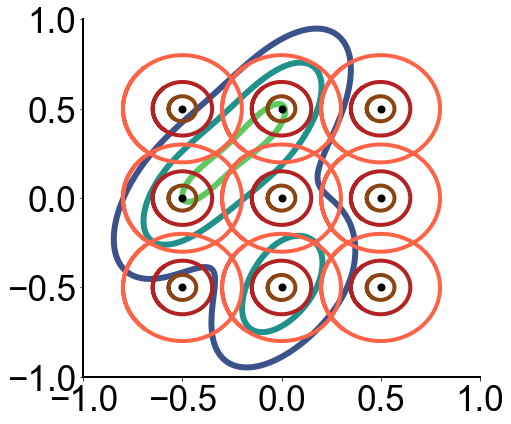

In [ ]:
_, ax = plt.subplots(1, 1, figsize=(figS*1.2, figS))
M = [[-0.5,-0.5],
    [0,-0.5],
    [0.5,-0.5],
    [-0.5,0],
    [0,0],
    [0.5,0],
    [-0.5,0.5],
    [0,0.5],
    [0.5,0.5]
]

R = [0.07, 0.15, 0.3]
ticks =[-1, -0.5, 0, 0.5, 1]
x = np.linspace(-4,4,10000)
col = ["saddlebrown", "firebrick",  "tomato"]
for m in M:
    ax.plot(m[0], m[1], "ko", markersize=7)
    for i,r in enumerate(R):
        ax.plot(m[0]+r*np.cos(x) , m[1]+r*np.sin(x), "-", linewidth=line_w+2, color=col[i])
#ax.contour(x, y, Y, levels=3, colors=["saddlebrown", "tomato","firebrick",  ], linewidths=line_w+2,  alpha=0.7)
c, c_ = np.array([[0.05, 0], [0,0.05]]), np.array([[0.06, 0.1], [0.04,0.1]])
W = [0, 0.9, 0.1, 0.9, 0.1, 0, 0, 0.9, 0]
Y, Y_ = 0, 0
x, y = np.mgrid[-1:1:.001, -1:1:.001]
pos = np.empty(x.shape + (2,))
pos[:, :, 0] = x
pos[:, :, 1] = y
for w,m in zip(W,M):
    Y = Y + w * multivariate_normal.pdf(pos, mean=m, cov=c)
for w,m in zip(W,M):
    Y_ = Y_ + w * multivariate_normal.pdf(pos, mean=m, cov=c_)
ax.contour(x, y, Y_, levels=3, linewidths=line_w+4, )
# for m in [[0,-0.5],[-0.5,0],[0,0.5],]:
#     ax.plot(m[0], m[1], "ko", markersize=7)
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
ax.spines["left"].set_linewidth(line_w)
ax.spines["bottom"].set_linewidth(line_w)
ax.spines["left"].set_linewidth(line_w)
ax.grid(False)
for label in (ax.get_xticklabels()+ax.get_yticklabels()):
    label.set_fontname(f_font1["fontname"])
    label.set_fontsize(35)
ax.xaxis.set_ticks(ticks)
ax.yaxis.set_ticks(ticks)
#ax.xaxis.set_ticklabels([" ", " ", " "], rotation = -60)
#ax.set_xlim(-0.5, 2.5)
#ax.yaxis.set_ticks(yax)
#ax.set_xlabel(" ")
#ax.set_ylabel(L[i], **f_font2)
plt.tight_layout()
plt.savefig(sp+"concept_testPostVv2.pdf")
plt.show()

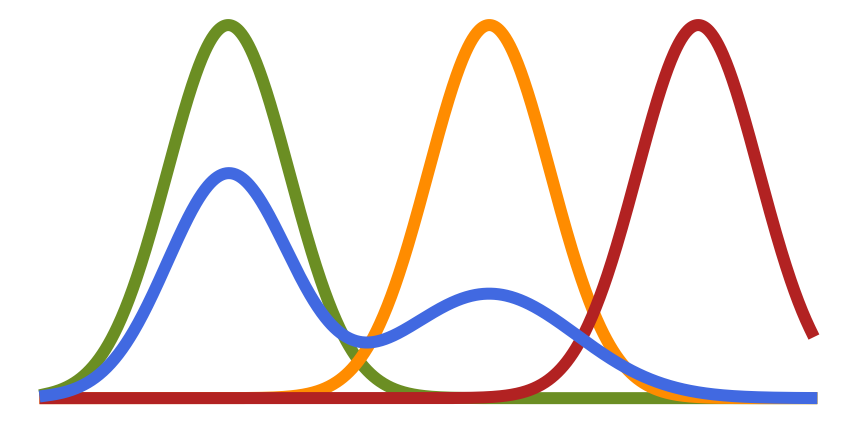

In [ ]:
_, ax = plt.subplots(1, 1, figsize=(figS*2, figS))
c = ["royalblue", "olivedrab", "darkorange", "firebrick"]
x = np.linspace(-4.8,4,1000)
lw = 10
y = norm.pdf(x, loc=-2.7, scale=0.7)
ax.plot(x, y,  '-', linewidth=line_w+lw, color = c[1])
y = norm.pdf(x, loc=0.3, scale=0.7)
ax.plot(x, y,  '-', linewidth=line_w+lw, color = c[2])
y = norm.pdf(x, loc=2.7, scale=0.7)
ax.plot(x, y,  '-', linewidth=line_w+lw, color = c[3])
y = np.sum([0.6*norm.pdf(x, loc=-2.7, scale=0.7), 0.4*norm.pdf(x, loc=0.3, scale=1)], axis=0)
ax.plot(x, y,  '-', linewidth=line_w+lw, color = c[0])
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.spines["bottom"].set_visible(False)
ax.spines["left"].set_visible(False)
ax.grid(False)
# for label in (ax.get_xticklabels()+ax.get_yticklabels()):
#     label.set_fontname(f_font1["fontname"])
#     label.set_fontsize(35)
#ax.xaxis.set_ticks(range(1,len(M)+1))
#ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
#ax.xaxis.set_ticklabels(["#"+str(i+1) for i in range(len(M))])
#ax.set_xlim(0, 10)
#ax.set_ylim(-0.03, 0.4)
#ax.yaxis.set_ticks(yax)
#ax.set_xlabel(" ")
#ax.set_ylabel(L[i], **f_font2)
plt.tick_params(top=False, bottom=False, left=False, right=False,
                labelleft=False, labelbottom=False)
plt.tight_layout()
plt.savefig(sp+"concept_mixture_1d.pdf")
plt.show()

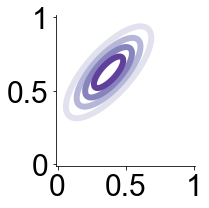

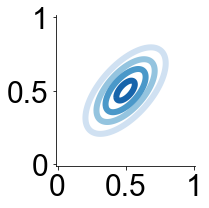

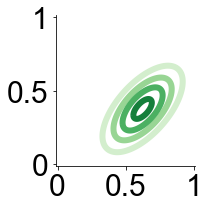

In [ ]:
c = ["royalblue", "olivedrab", "darkorange", "firebrick"]
x, y = np.mgrid[-4:4:.01, -4:4:.01]
pos = np.empty(x.shape + (2,))
pos[:, :, 0] = x
pos[:, :, 1] = y
lw = 10
CM = ["Purples", "Blues", "Greens", "Oranges", "Reds"]
for mi,m,c in zip(range(3),[[-1,1],[0,0],[1,-1]], [np.array([[2, 1.5], [1.5, 2]]), np.array([[1.9, 1.2], [1.2,1.9]]), np.array([[1.9, 1.5], [1.2,1.9]])]):
    _, ax = plt.subplots(1, 1, figsize=(figS*0.5, figS*0.5))
    Y_ = multivariate_normal.pdf(pos, mean=m, cov=c)
    ax.contour(x, y, Y_, levels=4, linewidths=line_w+4, cmap=CM[mi])
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    #ax.spines["left"].set_visible(False)
    #ax.spines["bottom"].set_visible(False)
    #ax.spines["left"].set_visible(False)
    ax.grid(False)
    # for label in (ax.get_xticklabels()+ax.get_yticklabels()):
    #     label.set_fontname(f_font1["fontname"])
    #     label.set_fontsize(35)
    ax.xaxis.set_ticks([-4,0,4])
    #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
    ax.xaxis.set_ticklabels(["0","0.5","1"], **f_font1)
    ax.yaxis.set_ticks([-4,0,4])
    #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
    ax.yaxis.set_ticklabels(["0","0.5","1"], **f_font1)
    ax.set_xlim(-4.1, 4.1)
    ax.set_ylim(-4.1, 4.1)
    #plt.tick_params(top=False, bottom=False, left=False, right=False,
    #                labelleft=False, labelbottom=False)
    plt.tight_layout()
    plt.savefig(sp+"firing_base_pred"+str(mi)+".pdf")
    plt.show()

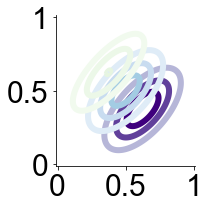

In [ ]:
w = [[0.7, 0.2, 0.05],
     [0.12, 0.081, 0.8]]
mij,mj,cj = 0, [-1.5,1.5], np.array([[1, 0.3], [0.3,1]])
_, ax = plt.subplots(1, 1, figsize=(figS*0.5, figS*0.5))
for mi,m,c in zip(range(3),[[1,-1],[0,0],[-1,1]], [np.array([[1.9, 1.5], [1.2,1.9]]), np.array([[1.9, 1.2], [1.2,1.9]]),np.array([[2, 1.5], [1.5, 2]]) ]):
    Y_ = multivariate_normal.pdf(pos, mean=m, cov=c)
    ax.contour(x, y, Y_*w[mij][mi], levels=3, linewidths=line_w+4, cmap=CM[mi],vmin=0, vmax=0.05)
#Y_ = multivariate_normal.pdf(pos, mean=mj, cov=cj)
#ax.contour(x, y, Y_, levels=3, linewidths=line_w+4, cmap="Blues")
ax.spines["top"].set_visible(False)
ax.spines["right"].set_visible(False)
#ax.spines["left"].set_visible(False)
#ax.spines["bottom"].set_visible(False)
#ax.spines["left"].set_visible(False)
ax.grid(False)
# for label in (ax.get_xticklabels()+ax.get_yticklabels()):
#     label.set_fontname(f_font1["fontname"])
#     label.set_fontsize(35)
ax.xaxis.set_ticks([-4,0,4])
#ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
ax.xaxis.set_ticklabels(["0","0.5","1"], **f_font1)
ax.yaxis.set_ticks([-4,0,4])
#ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
ax.yaxis.set_ticklabels(["0","0.5","1"], **f_font1)
ax.set_xlim(-4.1, 4.1)
ax.set_ylim(-4.1, 4.1)
#plt.tick_params(top=False, bottom=False, left=False, right=False,
#                labelleft=False, labelbottom=False)
plt.tight_layout()
plt.savefig(sp+"firing_test_mix_pred1"+str(mij)+".pdf")
plt.show()

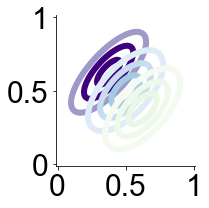

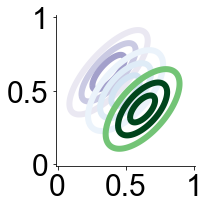

In [ ]:
w = [[0.7, 0.2, 0.05],
     [0.25, 0.1, 0.8]]
for mij,mj,cj in zip(range(2),[[-1.5,1.5],[1.5,-1.5]], [np.array([[1, 0.3], [0.3,1]]), np.array([[1, 0.3], [0.3,1]])]):
    _, ax = plt.subplots(1, 1, figsize=(figS*0.5, figS*0.5))
    for mi,m,c in zip(range(3),[[-1,1],[0,0],[1,-1]], [np.array([[2, 1.5], [1.5, 2]]), np.array([[1.9, 1.2], [1.2,1.9]]), np.array([[1.9, 1.5], [1.2,1.9]])]):
        Y_ = multivariate_normal.pdf(pos, mean=m, cov=c)
        ax.contour(x, y, Y_*w[mij][mi], levels=3, linewidths=line_w+4, cmap=CM[mi],vmin=0, vmax=0.05)
    #Y_ = multivariate_normal.pdf(pos, mean=mj, cov=cj)
    #ax.contour(x, y, Y_, levels=3, linewidths=line_w+4, cmap="Blues")
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    #ax.spines["left"].set_visible(False)
    #ax.spines["bottom"].set_visible(False)
    #ax.spines["left"].set_visible(False)
    ax.grid(False)
    # for label in (ax.get_xticklabels()+ax.get_yticklabels()):
    #     label.set_fontname(f_font1["fontname"])
    #     label.set_fontsize(35)
    ax.xaxis.set_ticks([-4,0,4])
    #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
    ax.xaxis.set_ticklabels(["0","0.5","1"], **f_font1)
    ax.yaxis.set_ticks([-4,0,4])
    #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
    ax.yaxis.set_ticklabels(["0","0.5","1"], **f_font1)
    ax.set_xlim(-4.1, 4.1)
    ax.set_ylim(-4.1, 4.1)
    #plt.tick_params(top=False, bottom=False, left=False, right=False,
    #                labelleft=False, labelbottom=False)
    plt.tight_layout()
    plt.savefig(sp+"firing_test_mix_pred1"+str(mij)+".pdf")
    plt.show()

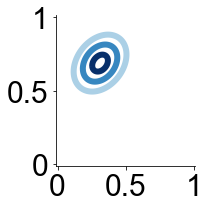

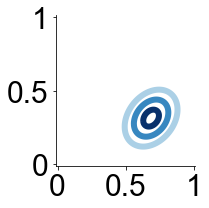

In [ ]:
for mi,m,c in zip(range(2),[[-1.5,1.5],[1.5,-1.5]], [np.array([[1, 0.3], [0.3,1]]), np.array([[1, 0.3], [0.3,1]])]):
    _, ax = plt.subplots(1, 1, figsize=(figS*0.5, figS*0.5))
    Y_ = multivariate_normal.pdf(pos, mean=m, cov=c)
    ax.contour(x, y, Y_, levels=3, linewidths=line_w+4, cmap="Blues",vmin=0, vmax=0.15)
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    #ax.spines["left"].set_visible(False)
    #ax.spines["bottom"].set_visible(False)
    #ax.spines["left"].set_visible(False)
    ax.grid(False)
    # for label in (ax.get_xticklabels()+ax.get_yticklabels()):
    #     label.set_fontname(f_font1["fontname"])
    #     label.set_fontsize(35)
    ax.xaxis.set_ticks([-4,0,4])
    #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
    ax.xaxis.set_ticklabels(["0","0.5","1"], **f_font1)
    ax.yaxis.set_ticks([-4,0,4])
    #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
    ax.yaxis.set_ticklabels(["0","0.5","1"], **f_font1)
    ax.set_xlim(-4.1, 4.1)
    ax.set_ylim(-4.1, 4.1)
    #plt.tick_params(top=False, bottom=False, left=False, right=False,
    #                labelleft=False, labelbottom=False)
    plt.tight_layout()
    plt.savefig(sp+"firing_test_pred1"+str(mi)+".pdf")
    plt.show()

In [ ]:
np.mean(np.mean(Y_*w[mij][mi], axis=0))

0.0015430959047635423

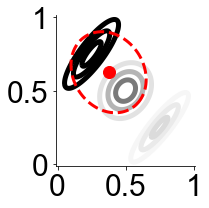

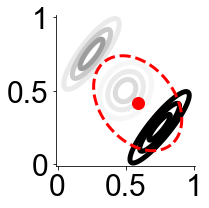

In [ ]:
w = [[0.7, 0.2, 0.05],
     [0.12, 0.081, 0.8]]
for mij,mj,cj in zip(range(2),[[-1.5,1.5],[1.5,-1.5]], [np.array([[1, 0.3], [0.3,1]]), np.array([[1, 0.3], [0.3,1]])]):
    _, ax = plt.subplots(1, 1, figsize=(figS*0.5, figS*0.5))
    for mi,m,c in zip(range(3),[[-2,2],[0,0],[2,-2]], [np.array([[1, 1.4], [1, 1.4]]), np.array([[0.9, 0.2], [0.2,0.9]]), np.array([[1.2, 1.5], [1.2,1.5]])]):
        Y_ = multivariate_normal.pdf(pos, mean=m, cov=c)
        ax.contour(x, y, Y_*w[mij][mi], levels=3, linewidths=line_w+3, cmap="Greys",vmin=0, vmax=0.05)
    #Y_ = multivariate_normal.pdf(pos, mean=mj, cov=cj)
    #ax.contour(x, y, Y_, levels=3, linewidths=line_w+4, cmap="Blues")
    de = 1
    if mij==0:
        x0 = np.mean(np.mean(Y_*w[mij][mi], axis=0))-de
        y0=np.mean(np.mean(Y_*w[mij][mi], axis=1))+de
        ax.plot(x0, y0, "ro", markersize=12)
        # Define the semi-major and semi-minor axes
        a = 2.4  # length of semi-major axis
        b = 2  # length of semi-minor axis
    else:
        x0=np.mean(np.mean(Y_*w[mij][mi], axis=0))+de-0.3
        y0=np.mean(np.mean(Y_*w[mij][mi], axis=1))-de+0.3
        ax.plot(x0,y0, "ro", markersize=12)
        # Define the semi-major and semi-minor axes
        a = 3  # length of semi-major axis
        b = 2.1  # length of semi-minor axis
    

    # Generate angle values
    theta = np.linspace(0, 2 * np.pi, 100)

    # Parametric equation of the ellipse
    xe = a * np.cos(theta) + x0
    ye = b * np.sin(theta) + y0

    phi = np.radians(-45) 
    # Apply rotation to the ellipse
    x_rotated = (xe - x0) * np.cos(phi) - (ye - y0) * np.sin(phi) + x0
    y_rotated = (xe - x0) * np.sin(phi) + (ye - y0) * np.cos(phi) + y0

    ax.plot(x_rotated, y_rotated, "r--", linewidth=3)
    ax.spines["top"].set_visible(False)
    ax.spines["right"].set_visible(False)
    #ax.spines["left"].set_visible(False)
    #ax.spines["bottom"].set_visible(False)
    #ax.spines["left"].set_visible(False)
    ax.grid(False)
    # for label in (ax.get_xticklabels()+ax.get_yticklabels()):
    #     label.set_fontname(f_font1["fontname"])
    #     label.set_fontsize(35)
    ax.xaxis.set_ticks([-4,0,4])
    #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
    ax.xaxis.set_ticklabels(["0","0.5","1"], **f_font1)
    ax.yaxis.set_ticks([-4,0,4])
    #ax.yaxis.set_ticks([0,0.1,0.2,0.3, 0.4])
    ax.yaxis.set_ticklabels(["0","0.5","1"], **f_font1)
    ax.set_xlim(-4.1, 4.1)
    ax.set_ylim(-4.1, 4.1)
    #plt.tick_params(top=False, bottom=False, left=False, right=False,
    #                labelleft=False, labelbottom=False)
    plt.tight_layout()
    plt.savefig(sp+"firing_test_mix_pred"+str(mij)+".pdf")
    plt.show()